# Global stuff

In [24]:
import os
import glob
import re
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

# Functions

In [25]:
import os

def read_single_file_with_keyword(folder_path, filename_search):
    file_path = os.path.join(folder_path, f"{filename_search}")

    try:
        with open(file_path, 'r') as file:
            # Read and parse the data from the file
            # Assume the data format includes 'q_nm^-1' and 'I'
            data = {
                "q_nm^-1": [],  # List of q values
                "I": [],  # List of corresponding I values
                "sigma": []  # List of corresponding sigma values
            }

            for i, line in enumerate(file):
                if line.startswith("# Timer:"):  # Check if the line starts with '# Timer:'
                    try:
                        # Remove '#' and split the line into key-value pairs
                        metadata_str = line[1:].strip().split(",")  # Remove '#' and split by commas

                        # Initialize metadata variables
                        timer, bstop, ctemp, I0 = None, None, None, None

                        # Parse key-value pairs
                        for pair in metadata_str:
                            pair = pair.strip()  # Clean up whitespace
                            if ":" not in pair:
                                print(f"Warning: Malformed metadata pair on line {i + 1}: {pair}")
                                continue  # Skip malformed pairs
                            
                            key, value = pair.split(":", 1)  # Split into key and value
                            key = key.strip().lower()  # Standardize the key
                            try:
                                value = float(value.strip())  # Convert value to float
                            except ValueError:
                                print(f"Error: Non-numeric value for key '{key}' on line {i + 1}: {pair}")
                                continue  # Skip invalid values

                            # Assign values to variables based on keys
                            if key == "timer":
                                timer = value
                            elif key == "bstop":
                                bstop = value
                            elif key == "ctemp":
                                ctemp = value
                            elif key == "i0":
                                I0 = value

                        # Verify all metadata were extracted
                        if None in (timer, bstop, ctemp, I0):
                            print(f"Error: Missing metadata values on line {i + 1}: {line.strip()}")
                        else:
                            print(f"Metadata parsed successfully: Timer={timer}, bstop={bstop}, ctemp={ctemp}, I0={I0}")

                    except Exception as e:
                        print(f"Error parsing metadata on line {i + 1}: {line.strip()}")
                        print(f"Exception: {e}")
                    continue





                if line.startswith("#"):  # Skip other comments if any
                    continue

                parts = line.strip().split()  # Assuming data is whitespace-separated
                if len(parts) >= 2:
                    q_value = float(parts[0])
                    I_value = float(parts[1])
                    I_sigma = float(parts[2])
                    # Append values to the data dictionary
                    data["q_nm^-1"].append(q_value)
                    data["I"].append(I_value)
                    data["sigma"].append(I_sigma)

            return data, timer, bstop, ctemp, I0

    except FileNotFoundError:
        print(f"File not found: {file_path}")
        return None, None, None, None, None

import os
import re

def search_dat_files_with_keywords(folder_path, keyword, samp_bkg_keyword):
    # Create a regular expression pattern to match the keyword and bkg_keyword in the filename
    
    #pattern = re.compile(f"{samp_bkg_keyword}{keyword}_", re.IGNORECASE) # exact match
    pattern = re.compile(f".*{re.escape(samp_bkg_keyword)}.*{re.escape(keyword)}.*", re.IGNORECASE)
    #pattern = re.compile(f"{re.escape(samp_bkg_keyword)}*{re.escape(keyword)}*", re.IGNORECASE)

    #print(f"Pattern: {pattern.pattern}")

    matching_dat_files = []

    # List files in the folder (not including subfolders)
    for file in os.listdir(folder_path):
        if pattern.match(file) and file.endswith('.dat'):
            matching_dat_files.append(file)

    #print(f"Found {len(matching_dat_files)} files matching the pattern '{pattern.pattern}'")
    return matching_dat_files


##########################
## test empample #######
##########################
'''
#folder_path_base = '/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/RT/RTSoak/OneD_integrated_WAXS_01/Correction/Normlised'
folder_path_base = '/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/RT/RTSoak/OneD_integrated_SAXS_01/Correction/Normlised'
#search_keywords = [str(10*i) for i in range(3,25)]
search_keywords = ['dy-1','dy0','dy1']

#capi1: PE powder
sample_keyword = "Run5_PEAcOH1_poly"
bkg_keyword =    "Run1_PEAcOH1_Empty"
empty_keyword =  "RT_Air"

search_dat_files_with_keywords(folder_path_base, 'dy0', empty_keyword)
'''

'\n#folder_path_base = \'/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/RT/RTSoak/OneD_integrated_WAXS_01/Correction/Normlised\'\nfolder_path_base = \'/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/RT/RTSoak/OneD_integrated_SAXS_01/Correction/Normlised\'\n#search_keywords = [str(10*i) for i in range(3,25)]\nsearch_keywords = [\'dy-1\',\'dy0\',\'dy1\']\n\n#capi1: PE powder\nsample_keyword = "Run5_PEAcOH1_poly"\nbkg_keyword =    "Run1_PEAcOH1_Empty"\nempty_keyword =  "RT_Air"\n\nsearch_dat_files_with_keywords(folder_path_base, \'dy0\', empty_keyword)\n'

# Plotting functions

In [26]:
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import numpy as np
import matplotlib.pyplot as plt

def darken_colors(num_colors, darker_factor=0.7):
    """
    Darken a set of colors by reducing the value component in the HSV color space.

    Parameters:
    - num_colors (int): Number of colors to generate.
    - darker_factor (float): Factor to control the darkness of the colors. Default is 0.7.

    Returns:
    - darker_colors (numpy.ndarray): Darkened colors in RGB format.
    """
    colors = plt.cm.jet(np.linspace(0, 1, num_colors))

    # Make the colors darker by reducing the value component
    darker_colors = colors.copy()

    for i in range(num_colors):
        rgb = darker_colors[i, :3]  # Extract the RGB values
        hsv = plt.cm.colors.rgb_to_hsv(rgb)  # Convert RGB to HSV
        hsv[2] *= darker_factor  # Reduce the value component
        darker_colors[i, :3] = plt.cm.colors.hsv_to_rgb(hsv)  # Convert back to RGB

    return darker_colors

def read_data_files(folder_path, keywords):
    data_list = []
    m_key = 0  # Initialize m_key to 0
    m_keys = []  # Create a list to store m_key for each file
    legend = []  # Create a list to store legends

    def sort_key(filename):
        ctr_index = filename.find("ctr")
        if ctr_index != -1:
            numeric_part = filename[ctr_index + 3:]
            numeric_part = numeric_part.split('_')[0]  # Extract numeric part before the next underscore
            try:
                return int(numeric_part)
            except ValueError:
                return float('inf')
        else:
            return float('inf')

    for keyword in keywords:
        print(f" '{keyword}'")
        files = glob.glob(os.path.join(folder_path, f"*{keyword}*.dat"))
        files = sorted(files, key=lambda x: (sort_key(x), x))

        for file in files:
            try:
                with open(file, 'r') as f:
                    lines = f.readlines()

                start_index = None
                for i, line in enumerate(lines):
                    if line.strip().startswith("#"):
                        continue
                    else:
                        start_index = i
                        break

                if start_index is not None:
                    df = pd.read_csv(file, sep='\s+', skiprows=start_index, header=None,
                                     names=["q_nm^-1", "I_avg_subtracted", 'I_avg_subtracted_sigma','I_normlised' ])
                    
                    # q_nm^-1 ------ I_avg_subtracted ------ I_avg_subtracted_sigma ------ I_Normalized
                    df["File"] = file
                    if not df.empty:
                        data_list.append(df)

                        # Extract temperature from the filename
                        # temperature = file.split('_T')[1].split('_')[0]

                        # Print only the file name (without path) just before plotting
                        file_name = os.path.basename(file)
                        #print(f" {file_name}")

                        # Check if temperature is present in the filename

                        legend.append(file_name)

                        m_keys.append(m_key)  # Append m_key for this file to the list
            except Exception as e:
                print(f"Error reading file {file}: {str(e)}")
            m_key += 1  # Increment m_key for each file
        m_key += 1  # Increment m_key by 2 when switching keywords

    # After the loop, concatenate the DataFrames
    data = pd.concat(data_list, ignore_index=True)

    # print(legend)
    return data, m_keys, legend



def create_saxs_waxs_plot(folder_path_saxs, folder_path_waxs, keywords, m_keys, data_saxs, data_waxs, legend_saxs, legend_waxs):
    # Create a 1x2 grid of subplots

    # print the keywords
    fig = plt.figure(figsize=(12, 8))
    fonts = 20
    
    num_colors = max(m_keys) + 1  # Calculate the number of colors based on the maximum m_key
    darker_colors = darken_colors(num_colors, darker_factor=0.7)
    
    #print(keywords)
    
    # SAXS plot
    plt.subplot(1, 2, 1)
    plt.title('SAXS',fontsize=fonts)
    for i, file in enumerate(data_saxs["File"].unique()):
        subset = data_saxs[data_saxs["File"] == file]
        qmin, qmax = 0, 2.5
        subset = subset[(subset["q_nm^-1"] >= qmin) & (subset["q_nm^-1"] <= qmax)]
        
        # Check if any data points are present before plotting
        if not subset.empty:
            #print(file)
            #print(subset)
            # q_nm^-1 ------ I_avg_subtracted ------ I_avg_subtracted_sigma ------ I_Normalized
            plt.loglog(subset["q_nm^-1"], subset["I_avg_subtracted"] * (1 ** m_keys[i]), markersize=0.5, color=darker_colors[m_keys[i]],label=legend_saxs[i].replace('_all_SAXS.dat', '') if legend_saxs is not None else None)

    plt.xlim(0.07, 2)
    plt.xlabel('q [$\\mathrm{nm^{-1}}$]', fontsize=fonts)
    plt.ylabel("Intensity [a.u.]", fontsize=fonts)
    plt.xticks(fontsize=fonts)  # Set x-axis tick to 20
    plt.yticks(fontsize=fonts)  # Set y-axis tick to 20
    
    plt.gca().set_facecolor('white')
    plt.gca().spines['top'].set_linewidth(1)
    plt.gca().spines['right'].set_linewidth(1)
    plt.gca().spines['bottom'].set_linewidth(1)
    plt.gca().spines['left'].set_linewidth(1)
    plt.tick_params(axis='both', which='both', direction='out', length=4, width=1)

    #plt.legend(loc='center left', bbox_to_anchor=(1, 0.5), fontsize=10, frameon=False)
    plt.legend(fontsize=7, frameon=True)

    # WAXS plot
    plt.subplot(1, 2, 2)
    plt.title('WAXS',fontsize=fonts)
    for i, file in enumerate(data_waxs["File"].unique()):
        subset = data_waxs[data_waxs["File"] == file]
        
        qmin, qmax = 10, 40
        subset = subset[(subset["q_nm^-1"] >= qmin) & (subset["q_nm^-1"] <= qmax)]
        
        if not subset.empty:
            plt.plot(subset["q_nm^-1"], subset["I_avg_subtracted"] + (0* m_keys[i]), markersize=1,color=darker_colors[m_keys[i]], label=legend_waxs[i].replace('_all_WAXS.dat', '') if legend_waxs is not None else None,alpha=0.7)

    plt.xlim(10, 20)
    plt.xlabel('q [$\\mathrm{nm^{-1}}$]', fontsize=fonts)
    plt.ylabel("Intensity [a.u.]", fontsize=fonts)
    plt.xticks(fontsize=fonts)  # Set x-axis tick to 20
    plt.yticks(fontsize=fonts)  # Set y-axis tick to 20
    plt.gca().set_facecolor('white')
    plt.gca().spines['top'].set_linewidth(1)
    plt.gca().spines['right'].set_linewidth(1)
    plt.gca().spines['bottom'].set_linewidth(1)
    plt.gca().spines['left'].set_linewidth(1)
    plt.tick_params(axis='both', which='both', direction='out', length=4, width=1)

    #plt.legend(loc='center left', bbox_to_anchor=(1.1, 0.5), fontsize=8, frameon=False)

    

    # Adjust layout and show the plot
    plt.tight_layout()
    
    
    
    ###################### save figure
    # Use the first 30 characters of the first keyword as the figure name
    figure_name = keywords[0][:30].replace('*', '')

    
    
    # Save the figure to the specified folder path with the given name
    #plt.savefig(f"{folder_path}/{figure_name}.png", dpi=300)
    
    
    # Create the "Figure" folder if it doesn't exist
    #figure_folder = os.path.join(folder_path_saxs, 'Figure_SAXS_WAXS')
    #os.makedirs(figure_folder, exist_ok=True)
    figure_folder = os.path.join(os.path.dirname(folder_path_saxs), 'Figure_saxs_waxs_Subtracted')
    os.makedirs(figure_folder, exist_ok=True)


    # Save the figure in the specified folder
    figure_path = os.path.join(figure_folder, f'{figure_name}_SAXS_WAXS.png')
    plt.savefig(figure_path, dpi=300)

    ###################
    plt.show()
    

        
        

        
def plot_saxs_waxs_data(all_keywords, Run_number):
    #folder_path_saxs_base = r'X:\bl1-5\Anjani\Autoxidation\Jan2025\RT\RTSoak\OneD_integrated_SAXS_01\Reduction'
    #folder_path_waxs_base = r'X:\bl1-5\Anjani\Autoxidation\Jan2025\RT\RTSoak\OneD_integrated_WAXS_01\Reduction'
    folder_path_saxs_base = r'/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted'
    folder_path_waxs_base = r'/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_WAXS_01/Correction/subtracted'

    for keywords in all_keywords:
        # Read SAXS data
        result_data_saxs, m_keys_saxs, legend_saxs = read_data_files(folder_path_saxs_base, keywords)

        # Read WAXS data
        result_data_waxs, m_keys_waxs, legend_waxs = read_data_files(folder_path_waxs_base, keywords)

        # Create SAXS-WAXS combined plot
        create_saxs_waxs_plot(
            folder_path_saxs_base,
            folder_path_waxs_base,
            keywords,
            m_keys_saxs,
            result_data_saxs,
            result_data_waxs,
            legend_saxs,
            legend_waxs,
        )
# https://pubs.rsc.org/en/content/articlelanding/2021/gc/d0gc03536j

<>:71: SyntaxWarning: invalid escape sequence '\s'
<>:71: SyntaxWarning: invalid escape sequence '\s'
/var/folders/0q/m0d3p44n2cb5dg956r2m2f782yh1mf/T/ipykernel_6295/2378912969.py:71: SyntaxWarning: invalid escape sequence '\s'
  df = pd.read_csv(file, sep='\s+', skiprows=start_index, header=None,


# SAXS Subtraction Function

In [27]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os

def SAXS_bkg_subtract(
    folder_path_base, 
    search_keywords, 
    sample_keyword, 
    bkg_keyword, 
    empty_keyword, 
    alpha, 
    save_SAXS_sub_files
):
    #plt.style.use('seaborn-darkgrid')  # Apply a clean and modern style
    alpha1 = alpha  # For saving in the file name

    for keyword in search_keywords:
        # Search for matching files
        matching_sample_files = search_dat_files_with_keywords(folder_path_base, keyword, sample_keyword)
        filename_search_sample = matching_sample_files[0]
        matching_bkg_files = search_dat_files_with_keywords(folder_path_base, keyword, bkg_keyword)
        filename_search_bkg = matching_bkg_files[0]

        if empty_keyword =='Air':
            keyword_empty = 'dx0'
        else:
            keyword_empty = keyword

        matching_empty_files = search_dat_files_with_keywords(folder_path_base, keyword_empty, empty_keyword)
        filename_search_empty = matching_empty_files[0]

        # Print the filenames
        print(f"Sample: {filename_search_sample}")
        print(f"Background: {filename_search_bkg}")
        print(f"Empty: {filename_search_empty}")

        # Read data from files
        sample_data, timer_sample,  bstop,CTEMP, I0 = read_single_file_with_keyword(folder_path_base, filename_search_sample)
        q_sample, I_sample_avg, I_sample_sigma = sample_data["q_nm^-1"], sample_data["I"], sample_data["sigma"]

        bkg_data, _, _, _, _ = read_single_file_with_keyword(folder_path_base, filename_search_bkg)
        q_bkg, I_bkg_avg, I_bkg_sigma = bkg_data["q_nm^-1"], bkg_data["I"], bkg_data["sigma"]




        empty_data, _, _, _, _ = read_single_file_with_keyword(folder_path_base, filename_search_empty)
        q_empty, I_empty_avg, I_empty_sigma = empty_data["q_nm^-1"], empty_data["I"], empty_data["sigma"]


        q1=1.6
        q2=1.8
        
        q_sample = np.array(q_sample)
        q_range_indices = np.where((q_sample >= q1) & (q_sample <= q2))[0]
        # Use the indices to extract the corresponding I values
        I_sample_empty_avg_q1_q2 = np.mean(I_sample_avg[q_range_indices[0]:q_range_indices[-1] + 1])
        I_bkg_empty_avg_q1_q2 = np.mean(I_bkg_avg[q_range_indices[0]:q_range_indices[-1] + 1])
        alpha_r =  I_sample_empty_avg_q1_q2/I_bkg_empty_avg_q1_q2
        alpha = alpha_r- alpha1
        alpha = round(alpha, 3)

        alpha = 0.5


        # covert alpha to 2 decimal point
        print(alpha)



        I_sample_sub_avg = np.array(I_sample_avg) - alpha * np.array(I_bkg_avg)
        I_sample_sub_sigma = np.sqrt(
            np.array(I_sample_sigma) ** 2 + (alpha ** 2) * np.array(I_bkg_sigma) ** 2
        )

        '''

        # Subtract empty from background and sample
        I_bkg_empty_avg = np.array(I_bkg_avg) - np.array(I_empty_avg)
        I_bkg_empty_sigma = np.sqrt(np.array(I_bkg_sigma) ** 2 + np.array(I_empty_sigma) ** 2)

        I_sample_empty_avg = np.array(I_sample_avg) - np.array(I_empty_avg)
        I_sample_empty_sigma = np.sqrt(np.array(I_sample_sigma) ** 2 + np.array(I_empty_sigma) ** 2)

        # Subtract background from the sample
        I_sample_sub_avg = I_sample_empty_avg - alpha * I_bkg_empty_avg
        I_sample_sub_sigma = np.sqrt(
            I_sample_empty_sigma ** 2 + (alpha ** 2) * I_bkg_empty_sigma ** 2
        )
        '''
        # Create the figure
        fig, axs = plt.subplots(figsize=(8, 6))
        axs.set_title(f"Sample: {filename_search_sample}", fontsize=14, weight="normal")
        axs.set_xlabel("q (nm$^{-1}$)", fontsize=12)
        axs.set_ylabel("Intensity [a.u.]", fontsize=12)

        # Plot data with improved colors and labels
        axs.loglog(q_sample, I_empty_avg, '-', color="gray", label="I_empty")
        axs.loglog(q_sample, I_bkg_avg, '-', color="m", label="I_bkg")
        #axs.loglog(q_sample, I_bkg_empty_avg, '-.', color="tab:cyan", label="I_bkg - I_empty")
        axs.loglog(q_sample, alpha*np.array(I_bkg_avg), '-', color="orange", label=f"{alpha} * (I_bkg)")
        axs.loglog(q_sample, I_sample_avg, '-', color="red", label="I_sample")
        #axs.loglog(q_sample, I_sample_empty_avg, '-', color="blue", label="I_sample - I_empty")
        
        axs.loglog(q_sample, I_sample_sub_avg, '-', color="green", 
                   label=f"(I_sample) - {alpha} * (I_bkg)")

        '''
        # Plot data with improved colors and labels
        axs.loglog(q_sample, I_empty_avg, '-.', color="gray", label="I_empty")
        axs.loglog(q_sample, I_bkg_avg, '-.', color="m", label="I_bkg")
        axs.loglog(q_sample, I_bkg_empty_avg, '-.', color="tab:cyan", label="I_bkg - I_empty")
        axs.loglog(q_sample, alpha*I_bkg_empty_avg, '-.', color="orange", label=f"{alpha} * (I_bkg - I_empty)")
        axs.loglog(q_sample, I_sample_avg, '-', color="red", label="I_sample")
        axs.loglog(q_sample, I_sample_empty_avg, '-', color="blue", label="I_sample - I_empty")
        
        axs.loglog(q_sample, I_sample_sub_avg, '-', color="green", 
                   label=f"(I_sample - I_empty) - {alpha} * (I_bkg - I_empty)")

        '''

        # Customize legend
        axs.legend(loc="upper right", fontsize=10, frameon=True, shadow=False, facecolor="white")

        # Add minor gridlines
        axs.grid(visible=True, which="both", linestyle="--", linewidth=0.5, alpha=0.7)

        # Adjust layout
        plt.tight_layout()

        # Save the plot
        plot_filename = os.path.join(
            #save_WAXS_sub_files, f"{filename_search_sample.split('.dat')[0]}_{alpha1}_plot.png"
            save_SAXS_sub_files, f"{filename_search_sample.split('.dat')[0]}_plot.png"
        )
        plt.savefig(plot_filename, dpi=300)
        plt.show()

        # Save data to file
        data = {
            "q_nm^-1": q_sample,
            "I_avg_sub": I_sample_sub_avg,
            "I_avg_sub_sigma": I_sample_sub_sigma,
            "I_sample": I_sample_avg,
        }
        df = pd.DataFrame(data)

        dat_filename = os.path.join(
            save_SAXS_sub_files, 
            #f"{filename_search_sample.split('.dat')[0]}_{alpha1}_sub.dat"
            f"{filename_search_sample.split('.dat')[0]}_sub.dat"
        )

        print(f"Saving SAXS data to {dat_filename}")
        inst_parameters = f'Timer: {timer_sample}, bstop: {bstop}, ctemp: {CTEMP}, I0: {I0}'

        headers = [
            f"filename: {filename_search_sample}",
            f"background : {filename_search_bkg}",
            f'Empty : {filename_search_empty}',
            f"{inst_parameters}", 
            "fit_data",
            "q_nm^-1 ------ I_avg_subtracted ------ I_avg_subtracted_sigma ------ I_Normalized",
        ]
        commented_headers = ['# ' + header for header in headers]

        with open(dat_filename, 'w') as dat_file:
            dat_file.write('\n'.join(commented_headers) + '\n')
            df.to_csv(dat_file, sep='\t', index=False, header=False)




# WAXS Subtraction function

In [28]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os

def WAXS_bkg_subtract(
    folder_path_base, 
    search_keywords, 
    sample_keyword, 
    bkg_keyword, 
    empty_keyword, 
    alpha, 
    save_WAXS_sub_files):
    #plt.style.use('seaborn-darkgrid')  # Apply a clean and modern style
    alpha1 = alpha  # For saving in the file name

    for keyword in search_keywords:
        # Search for matching files
        matching_sample_files = search_dat_files_with_keywords(folder_path_base, keyword, sample_keyword)
        filename_search_sample = matching_sample_files[0]
        matching_bkg_files = search_dat_files_with_keywords(folder_path_base, keyword, bkg_keyword)
        filename_search_bkg = matching_bkg_files[0]

        if empty_keyword =='Air':
            keyword_empty = 'dx0'
        else:
            keyword_empty = keyword
            
        matching_empty_files = search_dat_files_with_keywords(folder_path_base, keyword_empty, empty_keyword)
        filename_search_empty = matching_empty_files[0]

        # Print the filenames
        print(f"Sample: {filename_search_sample}")
        print(f"Background: {filename_search_bkg}")
        print(f"Empty: {filename_search_empty}")

        # Read data from files
        sample_data, timer_sample,  bstop, CTEMP, I0 = read_single_file_with_keyword(folder_path_base, filename_search_sample)
        q_sample, I_sample_avg, I_sample_sigma = sample_data["q_nm^-1"], sample_data["I"], sample_data["sigma"]

        bkg_data, _, _, _, _ = read_single_file_with_keyword(folder_path_base, filename_search_bkg)
        q_bkg, I_bkg_avg, I_bkg_sigma = bkg_data["q_nm^-1"], bkg_data["I"], bkg_data["sigma"]

        empty_data, _, _, _, _ = read_single_file_with_keyword(folder_path_base, filename_search_empty)
        q_empty, I_empty_avg, I_empty_sigma = empty_data["q_nm^-1"], empty_data["I"], empty_data["sigma"]

        '''
        # normlise to sum of the intensity in the range of 10 to 25
        q_sample = np.array(q_sample)
        # q_values corresponds to the q range, and I_sample_avg is the intensity
        q_range_min = 10
        q_range_max = 26

        # Mask to find indices within the desired q range
        mask = (q_sample >= q_range_min) & (q_sample <= q_range_max)

        # Normalize I_sample_avg by the sum of intensities in the specified q range
        I_sample_avg = np.array(I_sample_avg)
        I_bkg_avg = np.array(I_bkg_avg)
        I_empty_avg = np.array(I_empty_avg)

        I_sample_avg = (I_sample_avg) / np.sum(I_sample_avg[mask])
        I_bkg_avg = (I_bkg_avg) / np.sum(I_bkg_avg[mask])
        I_empty_avg = I_empty_avg / np.sum(I_empty_avg[mask])
        '''



    
        # Subtract empty from background and sample
        I_bkg_empty_avg = np.array(I_bkg_avg) - np.array(I_empty_avg)
        I_bkg_empty_sigma = np.sqrt(np.array(I_bkg_sigma) ** 2 + np.array(I_empty_sigma) ** 2)

        I_sample_empty_avg = np.array(I_sample_avg) - np.array(I_empty_avg)
        I_sample_empty_sigma = np.sqrt(np.array(I_sample_sigma) ** 2 + np.array(I_empty_sigma) ** 2)



        q1=24
        q2=25
        
        q_sample = np.array(q_sample)
        q_range_indices = np.where((q_sample >= q1) & (q_sample <= q2))[0]
        # Use the indices to extract the corresponding I values
        I_sample_empty_avg_q1_q2 = np.mean(I_sample_empty_avg[q_range_indices[0]:q_range_indices[-1] + 1])
        I_bkg_empty_avg_q1_q2 = np.mean(I_bkg_empty_avg[q_range_indices[0]:q_range_indices[-1] + 1])
        alpha_r =  I_sample_empty_avg_q1_q2/I_bkg_empty_avg_q1_q2
        alpha = alpha_r- alpha1

        # covert alpha to 2 decimal point
        print(alpha)
        


        # Subtract background from the sample
        I_sample_sub_avg = I_sample_empty_avg - alpha * I_bkg_empty_avg
        I_sample_sub_sigma = np.sqrt(
            I_sample_empty_sigma ** 2 + (alpha ** 2) * I_bkg_empty_sigma ** 2
        )

        
        
        # Create the figure
        fig, axs = plt.subplots(figsize=(8, 6))
        axs.set_title(f"Sample: {filename_search_sample}", fontsize=14, weight="bold")
        axs.set_xlabel("q (nm$^{-1}$)", fontsize=12)
        axs.set_ylabel("Intensity [a.u.]", fontsize=12)

        
        # Plot data with improved colors and labels
        axs.plot(q_sample, I_empty_avg, '-', color="gray", label="I_empty")
        axs.plot(q_sample, I_bkg_avg, '-', color="m", label="I_bkg")
        axs.plot(q_sample, I_bkg_empty_avg, '-', color="tab:cyan", label="I_bkg - I_empty")
        axs.plot(q_sample, alpha*I_bkg_empty_avg, '-', color="orange", label=f"{alpha} * (I_bkg - I_empty)")
        axs.plot(q_sample, I_sample_avg, '-', color="red", label="I_sample")
        axs.plot(q_sample, I_sample_empty_avg, '-', color="blue", label="I_sample - I_empty")
        
        axs.plot(q_sample, I_sample_sub_avg, '-', color="green", 
                   label=f"(I_sample - I_empty) - {alpha} * (I_bkg - I_empty)")

        

        # Customize legend
        axs.legend(loc="upper right", fontsize=10, frameon=True, shadow=False, facecolor="white")

        # Add minor gridlines
        axs.grid(visible=True, which="both", linestyle="--", linewidth=0.5, alpha=0.7)

        # Adjust layout
        plt.tight_layout()

        # Save the plot
        plot_filename = os.path.join(
            #save_WAXS_sub_files, f"{filename_search_sample.split('.dat')[0]}_{alpha1}_plot.png"
            save_WAXS_sub_files, f"{filename_search_sample.split('.dat')[0]}_plot.png"
        )
        plt.savefig(plot_filename, dpi=300)
        plt.show()

        # Save data to file
        data = {
            "q_nm^-1": q_sample,
            "I_avg_sub": I_sample_sub_avg,
            "I_avg_sub_sigma": I_sample_sub_sigma,
            "I_sample": I_sample_avg,
        }
        df = pd.DataFrame(data)

        dat_filename = os.path.join(
            save_WAXS_sub_files, 
            #f"{filename_search_sample.split('.dat')[0]}_{alpha1}_all_avg_sub.dat"
            f"{filename_search_sample.split('.dat')[0]}_sub.dat"
        )

        print(f"Saving WAXS data to {dat_filename}")
        inst_parameters = f'Timer: {timer_sample}, bstop: {bstop}, ctemp: {CTEMP}, I0: {I0}'

        headers = [
            f"filename: {filename_search_sample}",
            f"background : {filename_search_bkg}",
            f'Empty : {filename_search_empty}',
            f"{inst_parameters}", 
            "fit_data",
            "q_nm^-1 ------ I_avg_subtracted ------ I_avg_subtracted_sigma ------ I_Normalized",
        ]
        commented_headers = ['# ' + header for header in headers]

        with open(dat_filename, 'w') as dat_file:
            dat_file.write('\n'.join(commented_headers) + '\n')
            df.to_csv(dat_file, sep='\t', index=False, header=False)

    #return alpha


In [29]:
folder_SAXS_path_base = '/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Normlised'

save_SAXS_sub_files = os.path.join(folder_SAXS_path_base.replace("Normlised", ""), "Subtracted")
# Create the directory if it does not exist
os.makedirs(save_SAXS_sub_files, exist_ok=True)



folder_WAXS_path_base = '/Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_WAXS_01/Correction/Normlised'

save_WAXS_sub_files = os.path.join(folder_WAXS_path_base.replace("Normlised", ""), "Subtracted")
# Create the directory if it does not exist
os.makedirs(save_WAXS_sub_files, exist_ok=True)

# PE at T




Sample: Run6_PE_AcOH_RampT20_ctr0_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT20_ctr0_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT20_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129016.88666666666, bstop=4.499536666666667, ctemp=26.19971666666667, I0=21.27725333333333
Metadata parsed successfully: Timer=199754.97, bstop=4.6267, ctemp=23.635283, I0=20.845476666666666
Metadata parsed successfully: Timer=99307.11033333333, bstop=5.840843333333333, ctemp=34.443570666666666, I0=20.938636666666667
0.5


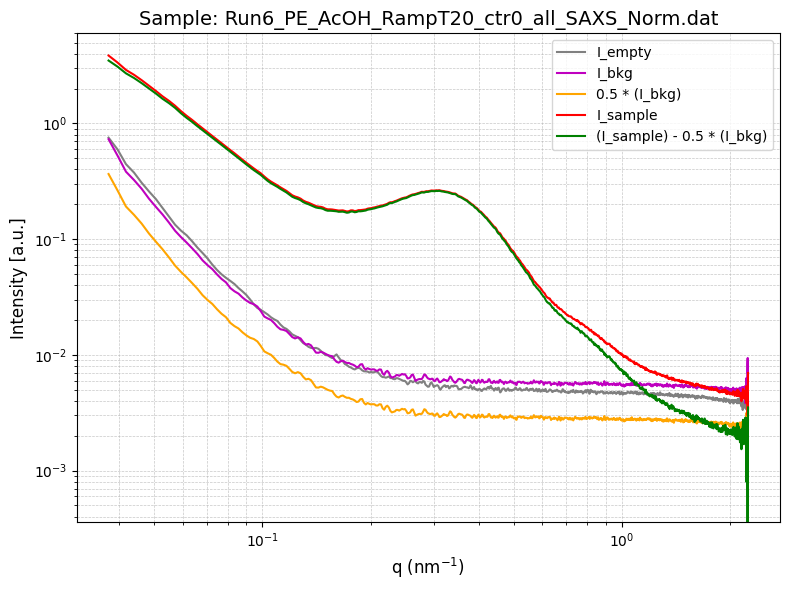

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT20_ctr0_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT22_ctr1_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT22_ctr1_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT22_ctr1_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129062.18666666666, bstop=4.48916, ctemp=26.089660666666664, I0=21.193836666666666
Metadata parsed successfully: Timer=199799.89666666664, bstop=4.669636666666666, ctemp=23.62017, I0=21.070083333333333
Metadata parsed successfully: Timer=99365.84433333333, bstop=5.830806666666667, ctemp=33.97231933333333, I0=20.921406666666666
0.5


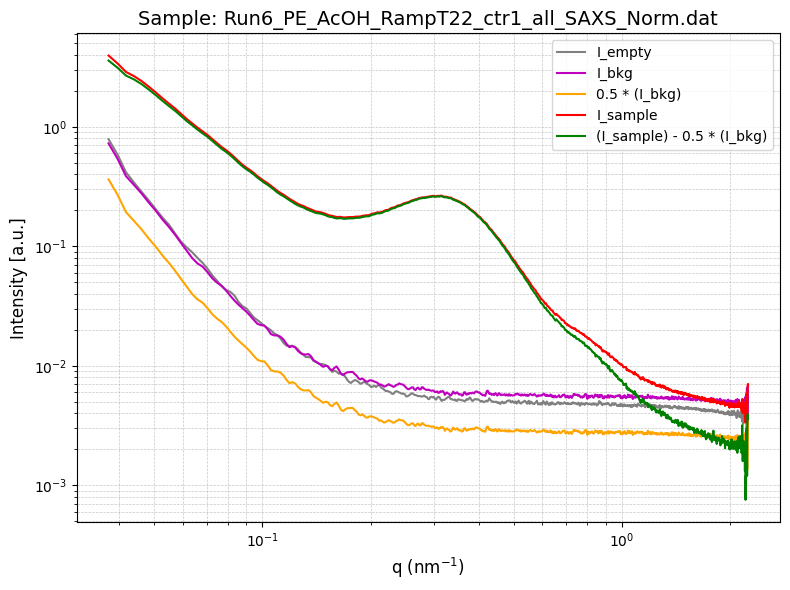

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT22_ctr1_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT25_ctr2_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT25_ctr2_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT25_ctr2_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129107.27333333333, bstop=4.476323333333333, ctemp=26.00623333333333, I0=21.192326666666663
Metadata parsed successfully: Timer=199871.17666666667, bstop=4.667046666666667, ctemp=28.853323000000003, I0=21.032456666666665
Metadata parsed successfully: Timer=99423.16733333333, bstop=5.810923333333332, ctemp=33.551553, I0=20.893069999999998
0.5


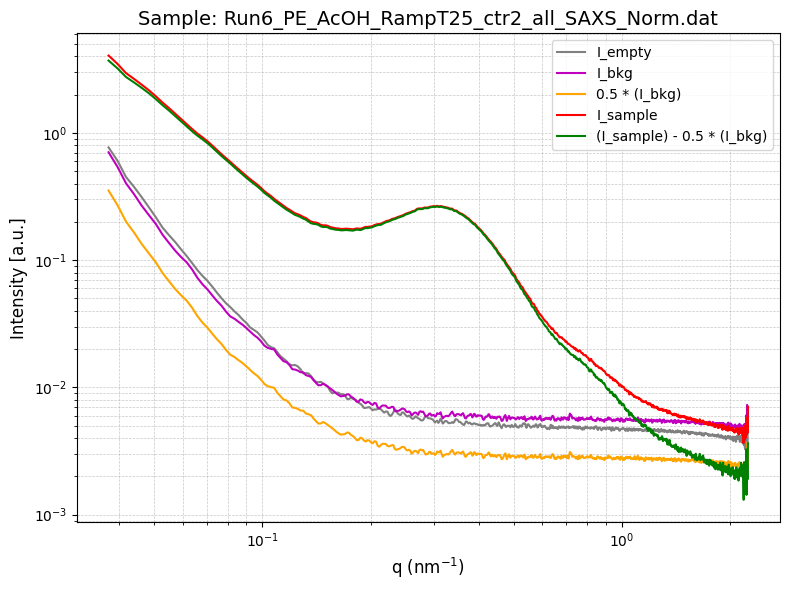

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT25_ctr2_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT27_ctr3_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT27_ctr3_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT27_ctr3_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129183.92, bstop=4.465003333333333, ctemp=29.595519, I0=21.06884333333333
Metadata parsed successfully: Timer=199916.16333333333, bstop=4.66523, ctemp=29.42859, I0=20.96626666666667
Metadata parsed successfully: Timer=99468.67166666668, bstop=5.799493333333333, ctemp=33.214679999999994, I0=20.83780333333333
0.5


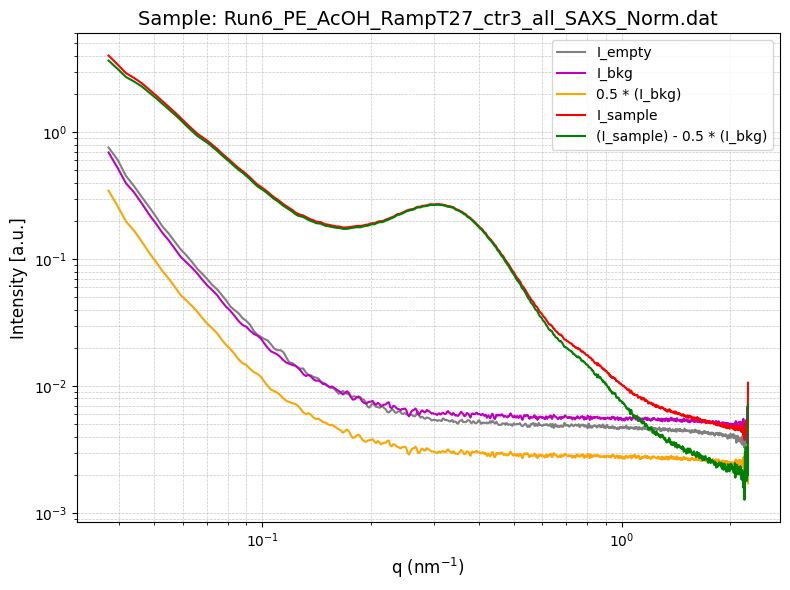

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT27_ctr3_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT30_ctr4_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT30_ctr4_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT30_ctr4_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129228.75, bstop=4.4589533333333335, ctemp=29.933646666666665, I0=21.023506666666666
Metadata parsed successfully: Timer=199987.8866666667, bstop=4.654936666666667, ctemp=33.569897, I0=20.9034
Metadata parsed successfully: Timer=99513.91933333332, bstop=5.787286666666667, ctemp=32.918487666666664, I0=20.73201
0.5


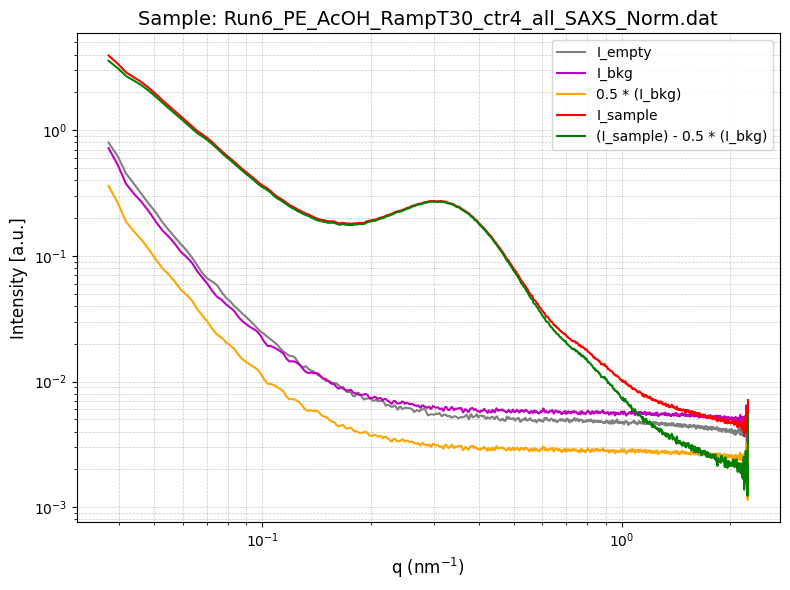

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT30_ctr4_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT32_ctr5_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT32_ctr5_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT32_ctr5_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129304.59333333334, bstop=4.502483333333333, ctemp=34.345937, I0=21.27558
Metadata parsed successfully: Timer=200032.98666666666, bstop=4.646780000000001, ctemp=33.793926000000006, I0=20.88767
Metadata parsed successfully: Timer=99559.58, bstop=5.78169, ctemp=32.600447333333335, I0=20.742136666666667
0.5


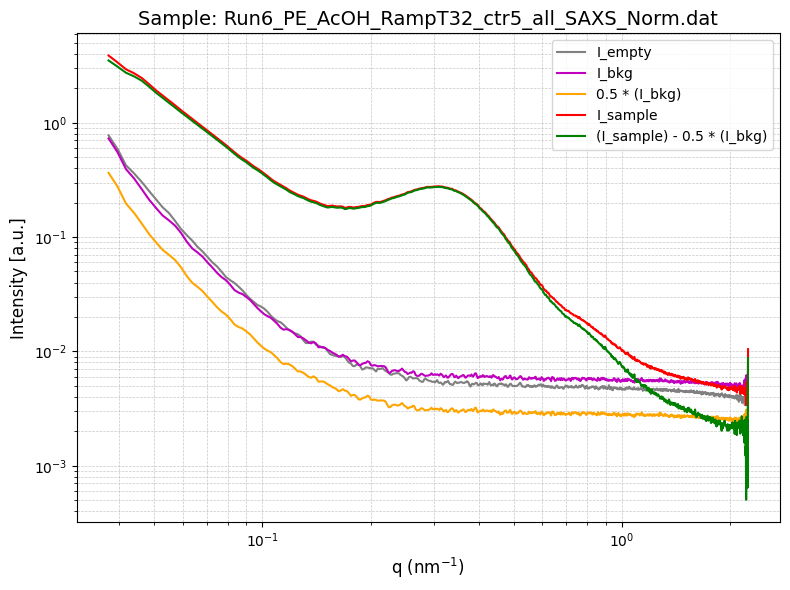

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT32_ctr5_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT35_ctr6_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT35_ctr6_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT35_ctr6_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129376.74333333333, bstop=4.49233, ctemp=36.624919999999996, I0=21.201773333333332
Metadata parsed successfully: Timer=200108.03333333333, bstop=4.70451, ctemp=38.61418666666666, I0=21.137083333333333
Metadata parsed successfully: Timer=99633.86133333335, bstop=5.838693333333334, ctemp=38.843533666666666, I0=20.93518
0.5


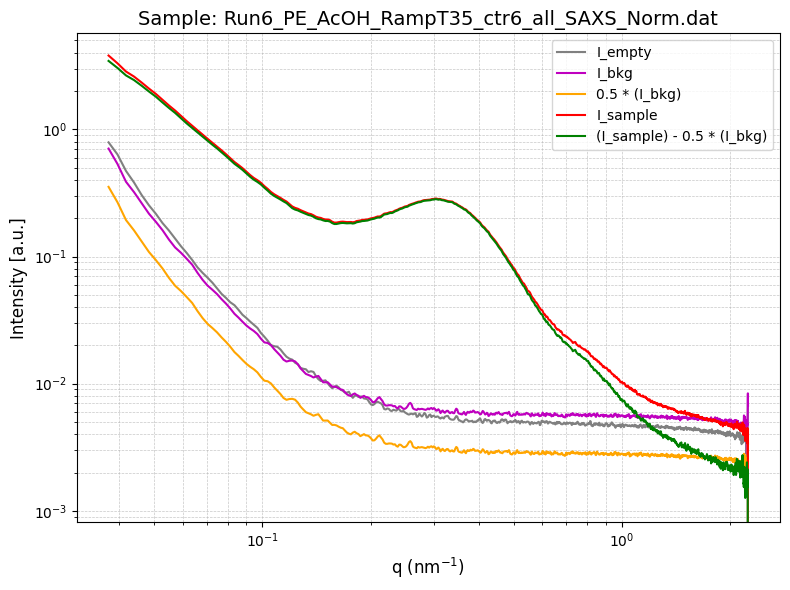

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT35_ctr6_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT37_ctr7_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT37_ctr7_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT37_ctr7_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129451.43333333333, bstop=4.48036, ctemp=39.09291566666666, I0=21.1027
Metadata parsed successfully: Timer=200155.48333333337, bstop=4.69286, ctemp=38.26424266666667, I0=21.05225
Metadata parsed successfully: Timer=99679.034, bstop=5.829153333333333, ctemp=38.72539266666667, I0=20.918186666666667
0.5


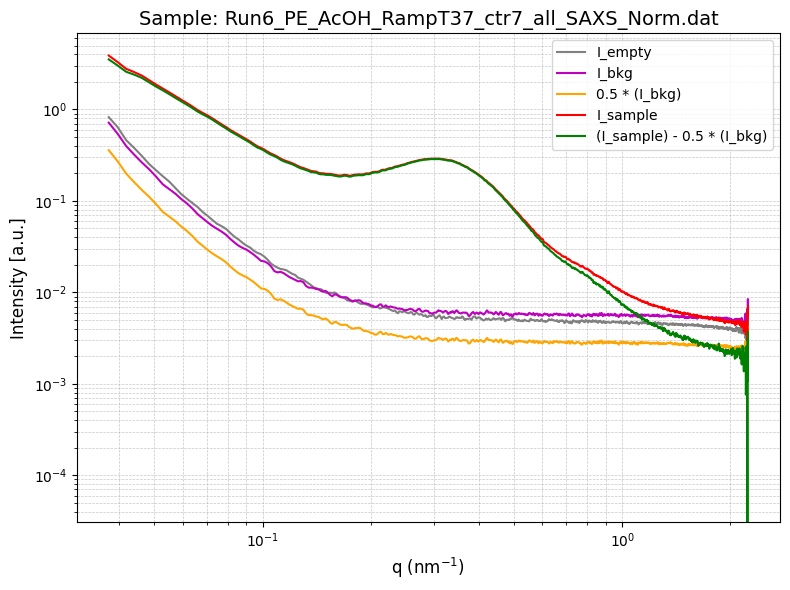

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT37_ctr7_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT40_ctr8_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT40_ctr8_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT40_ctr8_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129528.57, bstop=4.467663333333333, ctemp=41.57303, I0=21.00780333333333
Metadata parsed successfully: Timer=200239.04333333333, bstop=4.681513333333333, ctemp=43.48764966666667, I0=20.986776666666668
Metadata parsed successfully: Timer=99750.322, bstop=5.81963, ctemp=43.62077733333333, I0=20.877156666666664
0.5


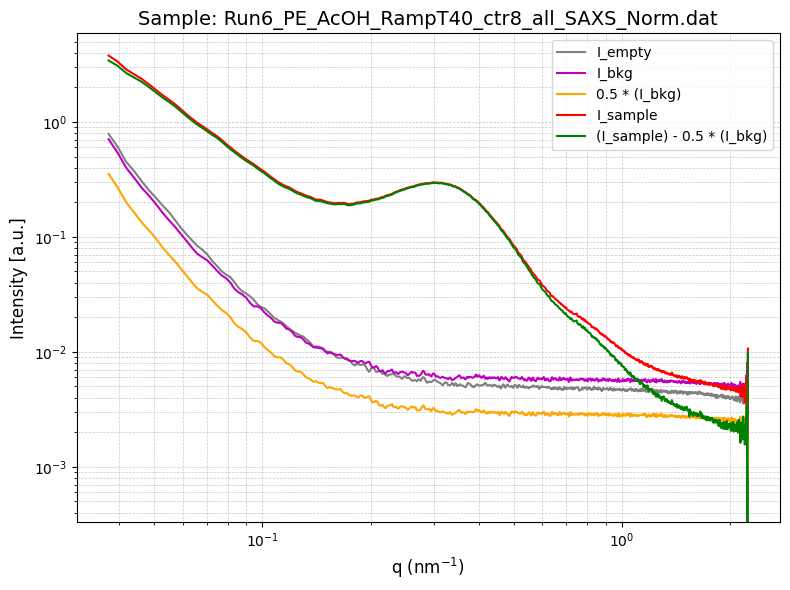

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT40_ctr8_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT42_ctr9_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT42_ctr9_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT42_ctr9_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129607.42333333334, bstop=4.510913333333334, ctemp=43.98438766666666, I0=21.23734
Metadata parsed successfully: Timer=200283.8933333333, bstop=4.675936666666667, ctemp=42.81851433333333, I0=20.945686666666663
Metadata parsed successfully: Timer=99795.70766666665, bstop=5.807546666666667, ctemp=43.147533333333335, I0=20.79771666666667
0.5


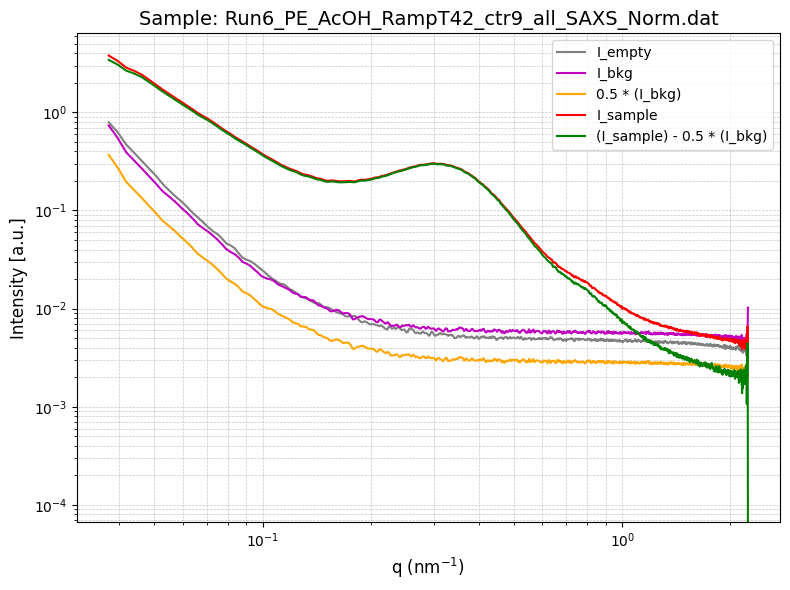

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT42_ctr9_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT45_ctr10_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT45_ctr10_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT45_ctr10_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129688.78000000001, bstop=4.49488, ctemp=46.41739666666666, I0=21.157
Metadata parsed successfully: Timer=200356.52666666664, bstop=4.6648, ctemp=48.305442666666664, I0=20.881073333333333
Metadata parsed successfully: Timer=99868.68433333332, bstop=5.800446666666667, ctemp=48.465106999999996, I0=20.782663333333332
0.5


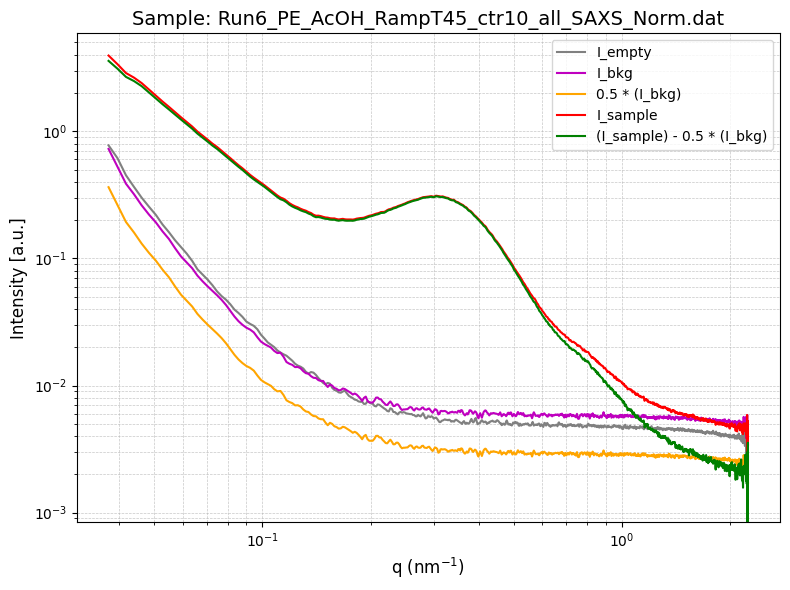

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT45_ctr10_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT47_ctr11_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT47_ctr11_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT47_ctr11_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129772.62, bstop=4.4844566666666665, ctemp=48.83392333333333, I0=21.08565666666667
Metadata parsed successfully: Timer=200401.92333333334, bstop=4.712136666666667, ctemp=47.48074366666666, I0=21.104586666666666
Metadata parsed successfully: Timer=99913.87799999998, bstop=5.858826666666666, ctemp=47.67397066666666, I0=21.01381333333333
0.5


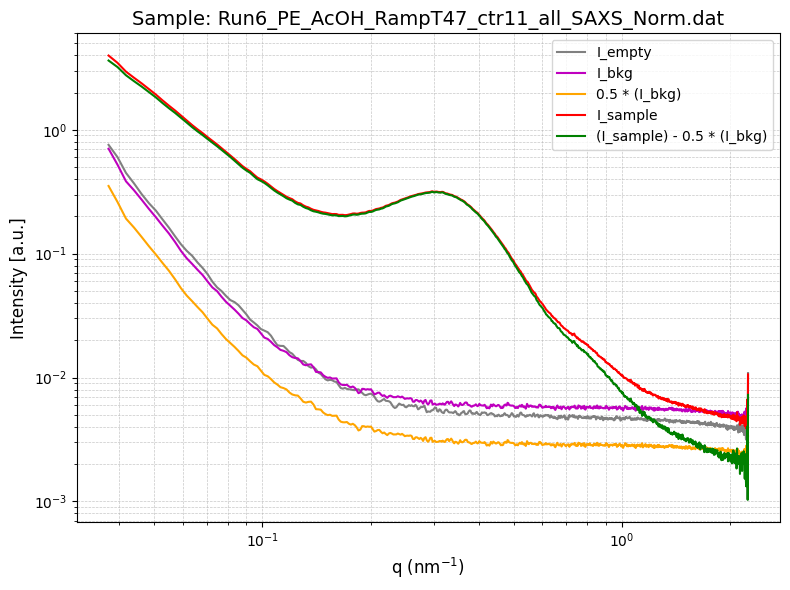

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT47_ctr11_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT50_ctr12_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT50_ctr12_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT50_ctr12_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129858.95333333332, bstop=4.460719999999999, ctemp=51.24975733333333, I0=20.97548
Metadata parsed successfully: Timer=200461.9, bstop=4.709093333333334, ctemp=50.833487, I0=21.100966666666668
Metadata parsed successfully: Timer=99978.898, bstop=5.837656666666667, ctemp=53.127939999999995, I0=20.92560333333333
0.5


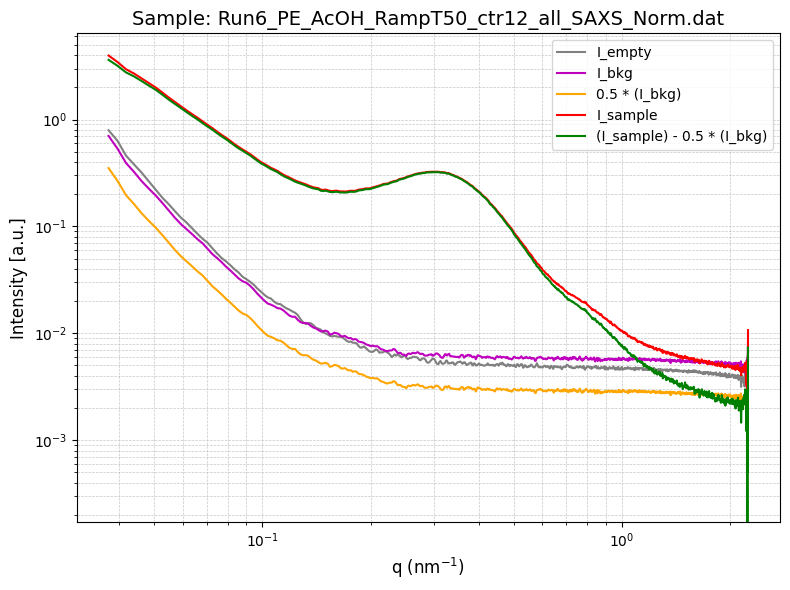

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT50_ctr12_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT52_ctr13_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT52_ctr13_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT52_ctr13_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=129948.01333333335, bstop=4.50465, ctemp=53.65444933333333, I0=21.172046666666667
Metadata parsed successfully: Timer=200543.19666666666, bstop=4.6997333333333335, ctemp=55.510207, I0=20.985
Metadata parsed successfully: Timer=100023.95333333332, bstop=5.829620000000001, ctemp=52.813783, I0=20.848119999999998
0.5


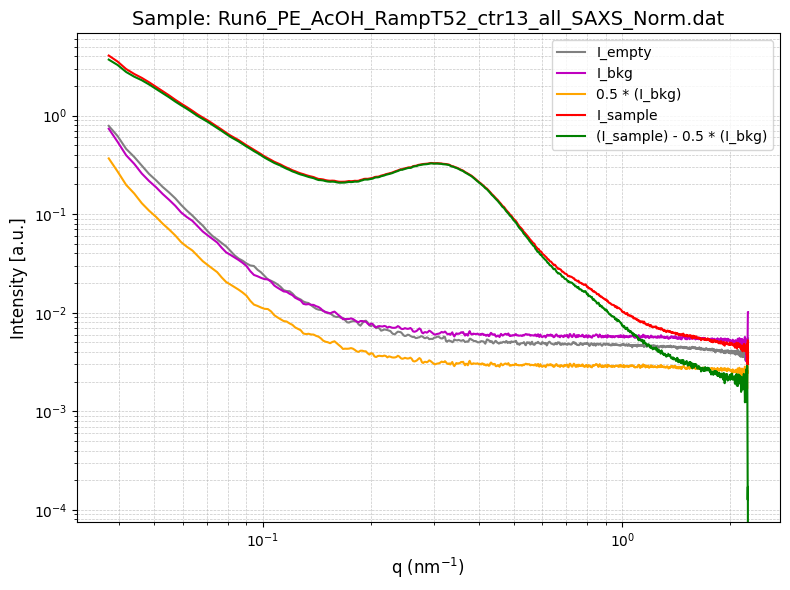

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT52_ctr13_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT55_ctr14_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT55_ctr14_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT55_ctr14_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130040.59333333334, bstop=4.491716666666666, ctemp=56.066476, I0=21.117523333333335
Metadata parsed successfully: Timer=200588.57333333333, bstop=4.694023333333333, ctemp=55.15811433333334, I0=20.92570666666667
Metadata parsed successfully: Timer=100076.63, bstop=5.819333333333333, ctemp=54.89452, I0=20.81392
0.5


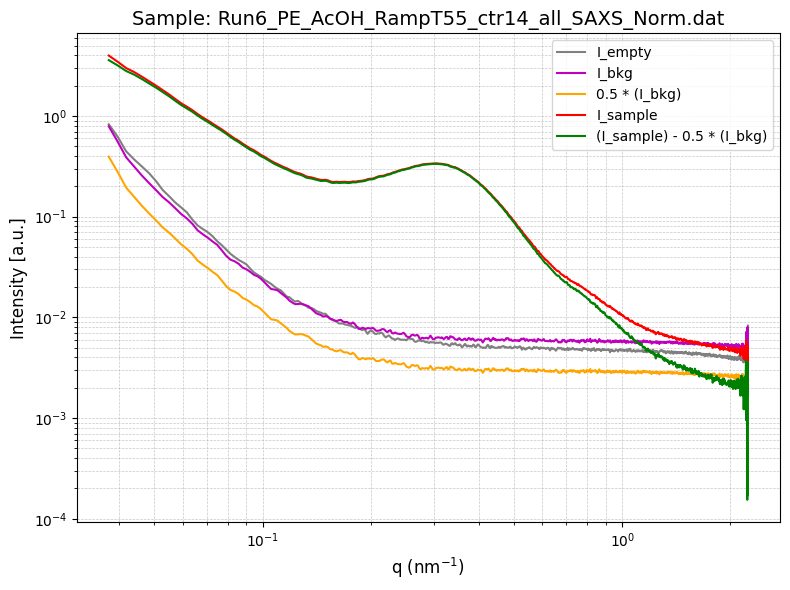

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT55_ctr14_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT57_ctr15_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT57_ctr15_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT57_ctr15_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130135.31666666665, bstop=4.47785, ctemp=58.47857666666667, I0=20.995743333333333
Metadata parsed successfully: Timer=200638.37333333332, bstop=4.682176666666667, ctemp=57.736390666666665, I0=20.881600000000002
Metadata parsed successfully: Timer=100136.75333333334, bstop=5.800503333333334, ctemp=57.61553933333334, I0=20.770363333333332
0.5


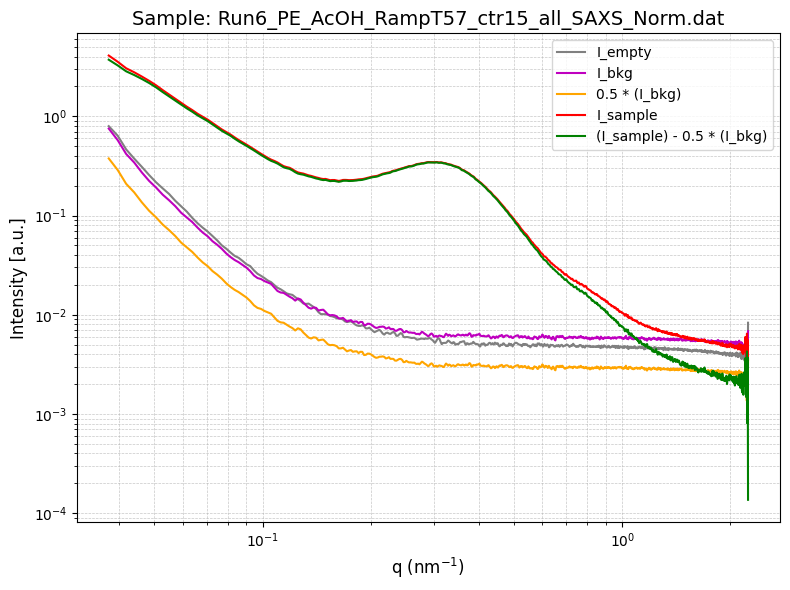

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT57_ctr15_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT60_ctr16_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT60_ctr16_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT60_ctr16_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130232.03666666667, bstop=4.518483333333333, ctemp=60.89105333333333, I0=21.152693333333332
Metadata parsed successfully: Timer=200714.54333333333, bstop=4.739786666666667, ctemp=62.72004333333334, I0=21.12028666666667
Metadata parsed successfully: Timer=100203.45, bstop=5.867506666666666, ctemp=62.813933, I0=20.99655
0.5


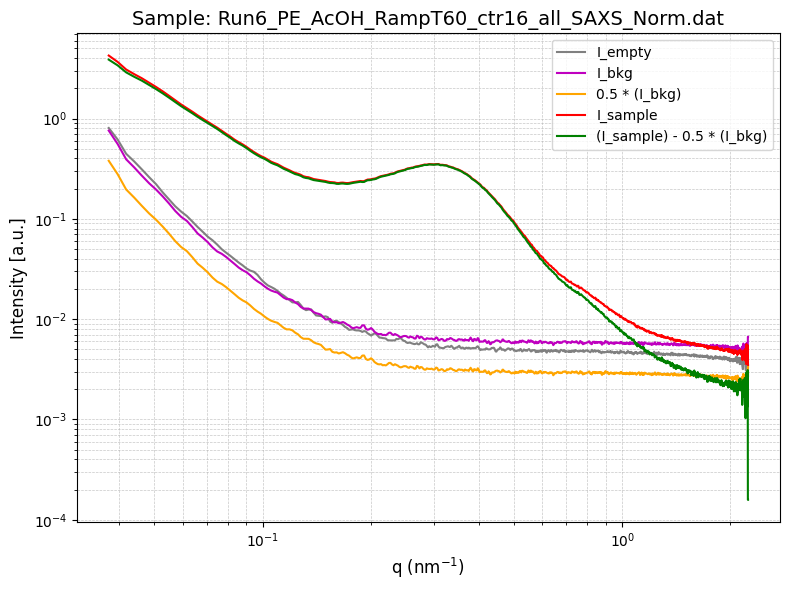

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT60_ctr16_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT62_ctr17_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT62_ctr17_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT62_ctr17_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130332.09999999999, bstop=1.85325, ctemp=63.72251666666667, I0=7.242273333333333
Metadata parsed successfully: Timer=200759.86000000002, bstop=4.72782, ctemp=62.391894, I0=21.05228
Metadata parsed successfully: Timer=100248.33666666667, bstop=5.856400000000001, ctemp=63.165203, I0=20.957256666666666
0.5


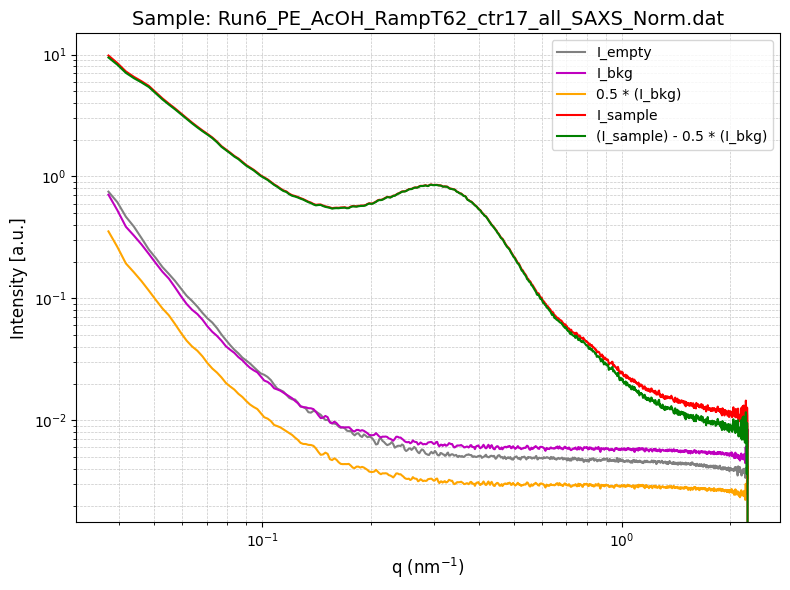

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT62_ctr17_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT65_ctr18_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT65_ctr18_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT65_ctr18_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130411.67, bstop=4.48102, ctemp=67.12642633333333, I0=20.98375
Metadata parsed successfully: Timer=200808.55000000002, bstop=4.7198400000000005, ctemp=64.94501766666667, I0=21.002753333333334
Metadata parsed successfully: Timer=100293.22666666668, bstop=5.84461, ctemp=65.00760899999999, I0=20.90917
0.5


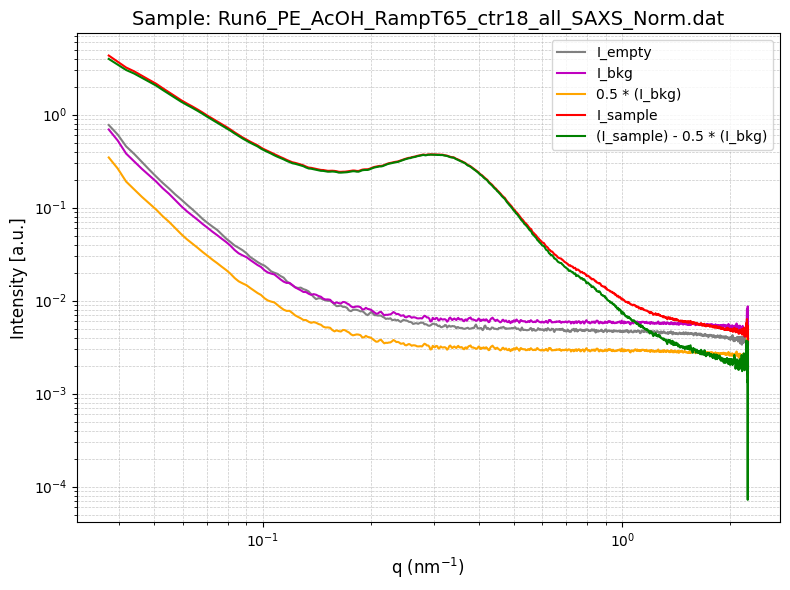

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT65_ctr18_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT67_ctr19_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT67_ctr19_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT67_ctr19_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130488.83, bstop=4.514473333333334, ctemp=69.51754766666666, I0=21.149323333333335
Metadata parsed successfully: Timer=200878.78666666665, bstop=4.715199999999999, ctemp=69.88502, I0=20.923933333333334
Metadata parsed successfully: Timer=100353.27666666666, bstop=5.835886666666667, ctemp=69.978709, I0=20.84414
0.5


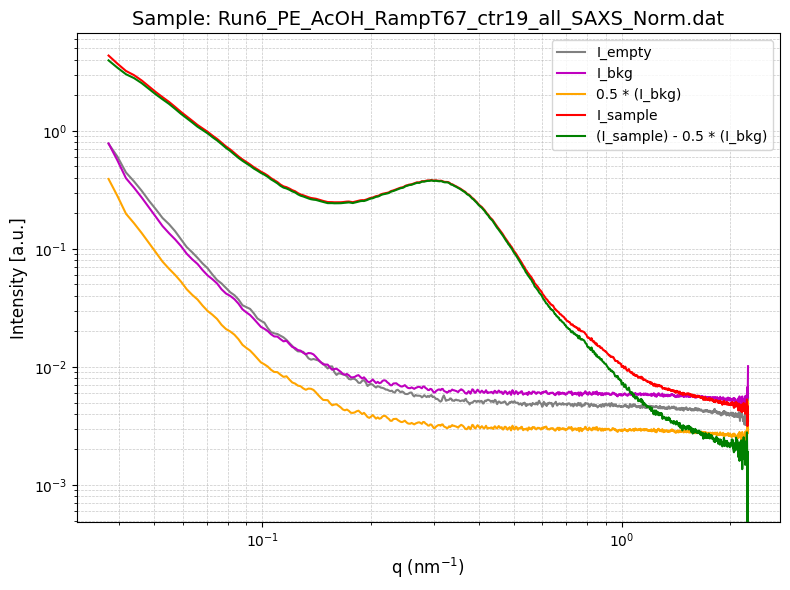

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT67_ctr19_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT70_ctr20_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT70_ctr20_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT70_ctr20_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130567.55666666666, bstop=4.522706666666667, ctemp=71.93394966666666, I0=21.156566666666667
Metadata parsed successfully: Timer=200957.77000000002, bstop=4.702249999999999, ctemp=72.383484, I0=20.848556666666667
Metadata parsed successfully: Timer=100425.39999999998, bstop=5.81923, ctemp=72.51002, I0=20.77344666666667
0.5


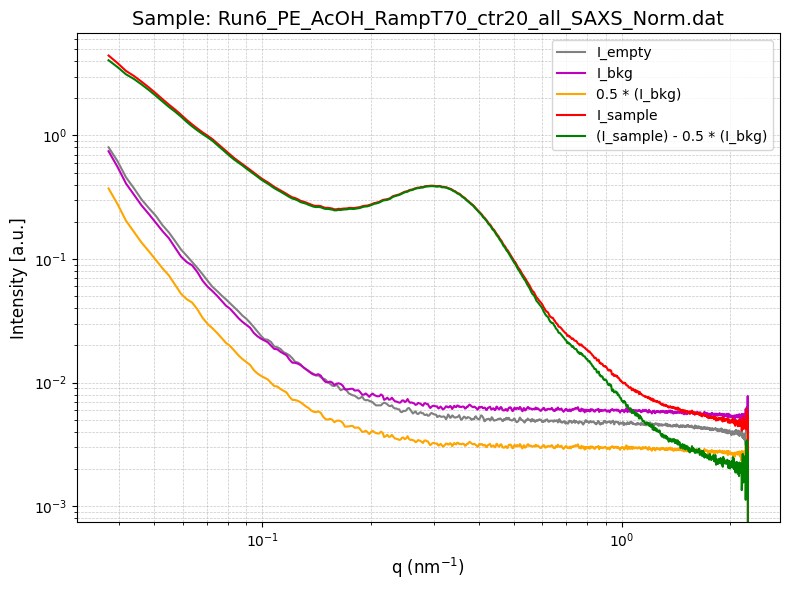

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT70_ctr20_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT72_ctr21_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT72_ctr21_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT72_ctr21_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130647.68333333333, bstop=4.50086, ctemp=74.35858133333333, I0=21.041443333333333
Metadata parsed successfully: Timer=201037.80000000002, bstop=4.750463333333333, ctemp=74.78227733333334, I0=21.077550000000002
Metadata parsed successfully: Timer=100498.26666666666, bstop=5.868986666666667, ctemp=74.93459566666667, I0=20.939493333333335
0.5


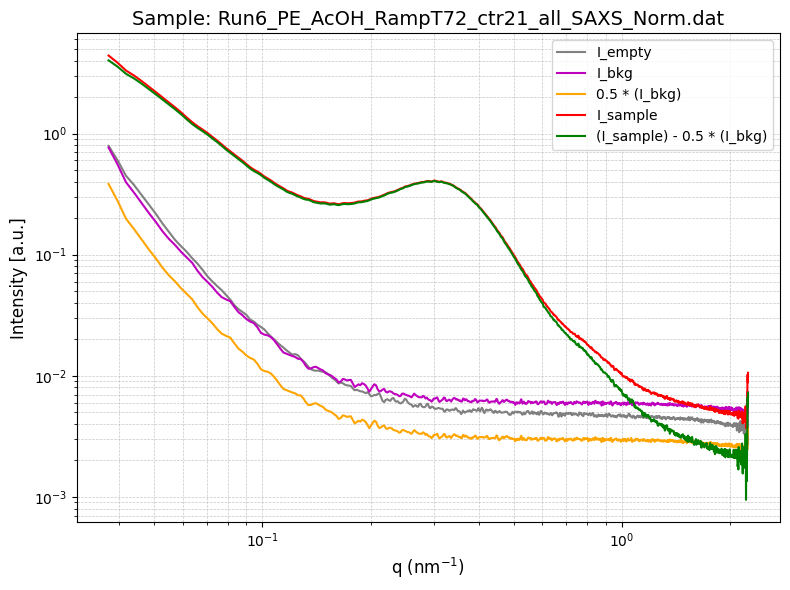

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT72_ctr21_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT75_ctr22_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT75_ctr22_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT75_ctr22_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130729.00333333334, bstop=4.4886333333333335, ctemp=76.747477, I0=20.97695
Metadata parsed successfully: Timer=201119.19333333336, bstop=4.737933333333333, ctemp=77.22231066666667, I0=20.98821
Metadata parsed successfully: Timer=100572.14000000001, bstop=5.860913333333333, ctemp=77.36410266666667, I0=20.907236666666666
0.5


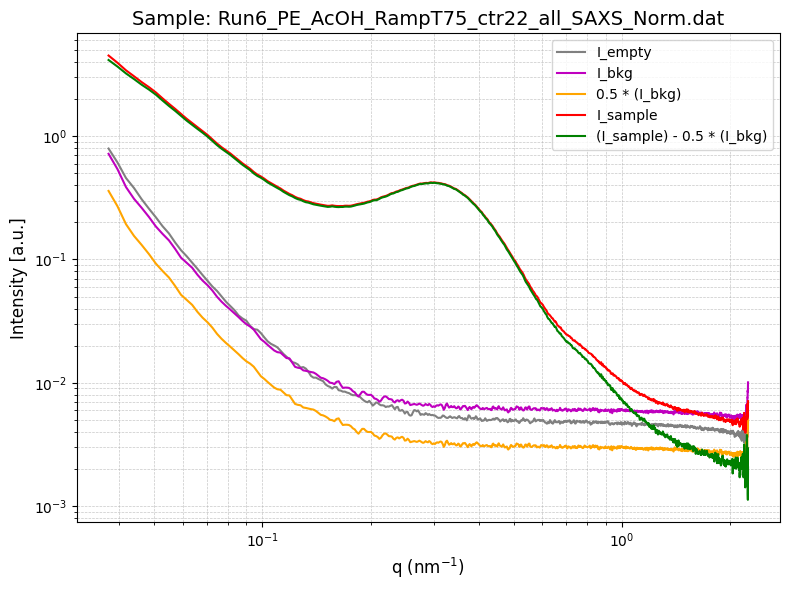

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT75_ctr22_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT77_ctr23_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT77_ctr23_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT77_ctr23_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130810.86, bstop=4.5429466666666665, ctemp=79.19364433333334, I0=21.21479666666667
Metadata parsed successfully: Timer=201201.63, bstop=4.7296000000000005, ctemp=79.630859, I0=20.95873
Metadata parsed successfully: Timer=100647.21, bstop=5.848056666666667, ctemp=79.78662366666667, I0=20.80968
0.5


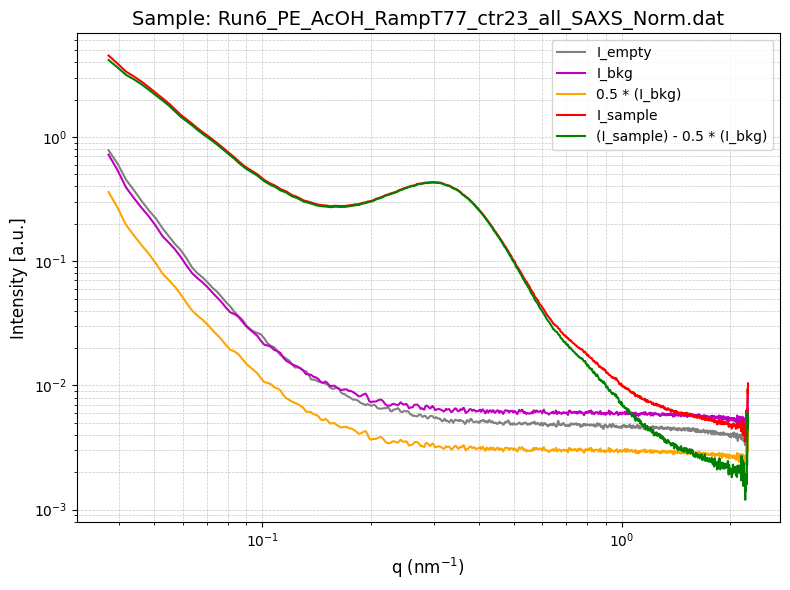

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT77_ctr23_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT80_ctr24_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT80_ctr24_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT80_ctr24_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130894.89333333333, bstop=4.5192000000000005, ctemp=81.57122033333333, I0=21.08801
Metadata parsed successfully: Timer=201285.70666666667, bstop=4.741503333333333, ctemp=82.03428166666667, I0=20.98434
Metadata parsed successfully: Timer=100723.53333333333, bstop=5.823603333333334, ctemp=82.194275, I0=20.7305
0.5


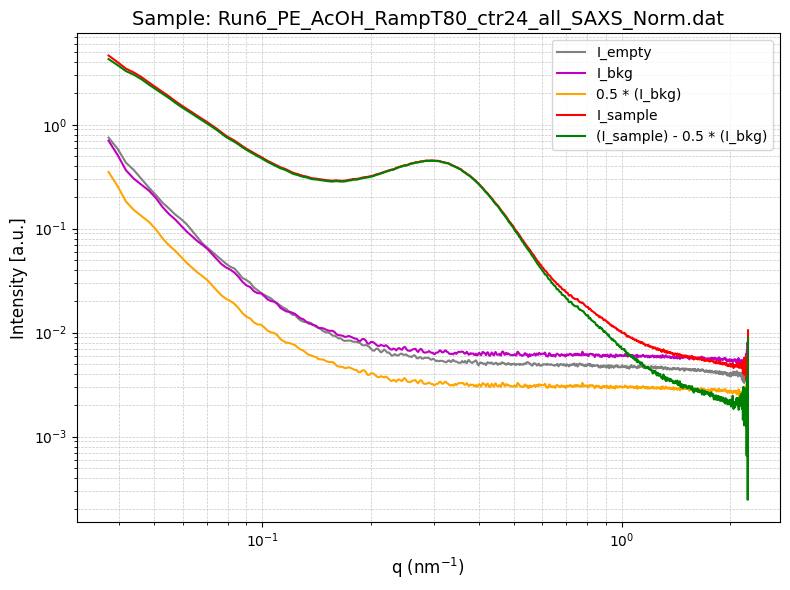

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT80_ctr24_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT82_ctr25_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT82_ctr25_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT82_ctr25_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=130980.5, bstop=4.5052433333333335, ctemp=83.94775133333333, I0=21.006196666666668
Metadata parsed successfully: Timer=201371.6366666667, bstop=4.76004, ctemp=84.45224, I0=21.027779999999996
Metadata parsed successfully: Timer=100801.18333333333, bstop=5.876296666666668, ctemp=84.57542933333333, I0=20.97469
0.5


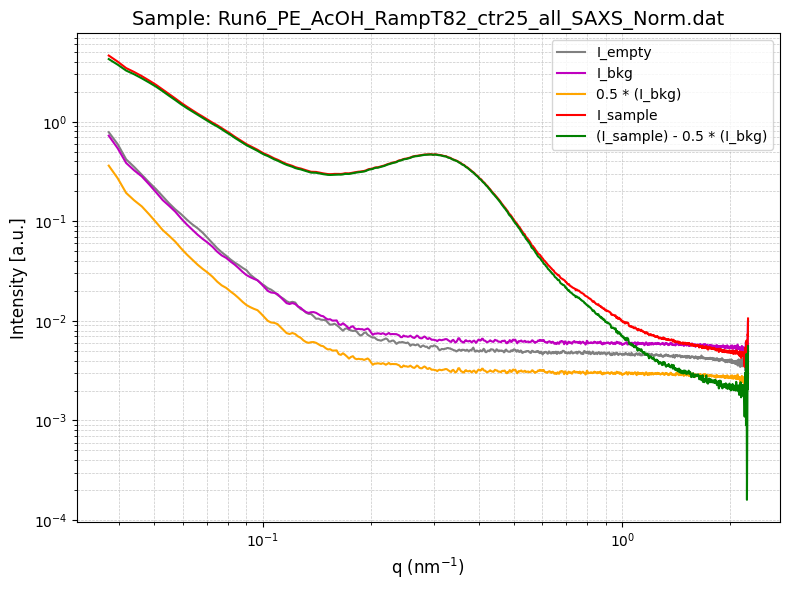

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT82_ctr25_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT85_ctr26_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT85_ctr26_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT85_ctr26_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131065.80333333334, bstop=4.4962133333333325, ctemp=86.42400100000002, I0=20.934859999999997
Metadata parsed successfully: Timer=201458.47999999998, bstop=4.74964, ctemp=86.85003933333333, I0=20.939003333333332
Metadata parsed successfully: Timer=100880.16333333333, bstop=5.859466666666666, ctemp=86.99566666666668, I0=20.870060000000002
0.5


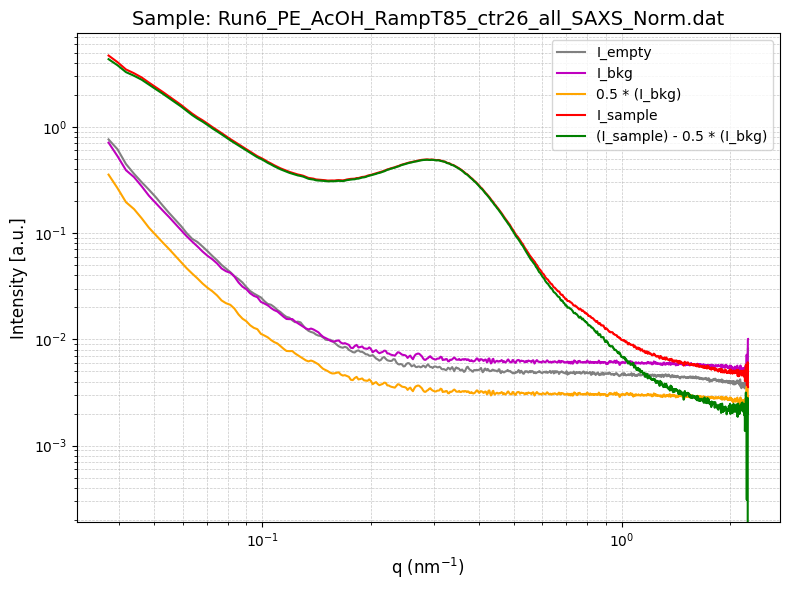

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT85_ctr26_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT87_ctr27_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT87_ctr27_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT87_ctr27_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131153.73, bstop=4.535833333333334, ctemp=88.733022, I0=21.10289333333333
Metadata parsed successfully: Timer=201547.36666666667, bstop=4.73117, ctemp=89.24251333333332, I0=20.86042
Metadata parsed successfully: Timer=100959.16666666667, bstop=5.842089999999999, ctemp=89.40471633333334, I0=20.765863333333332
0.5


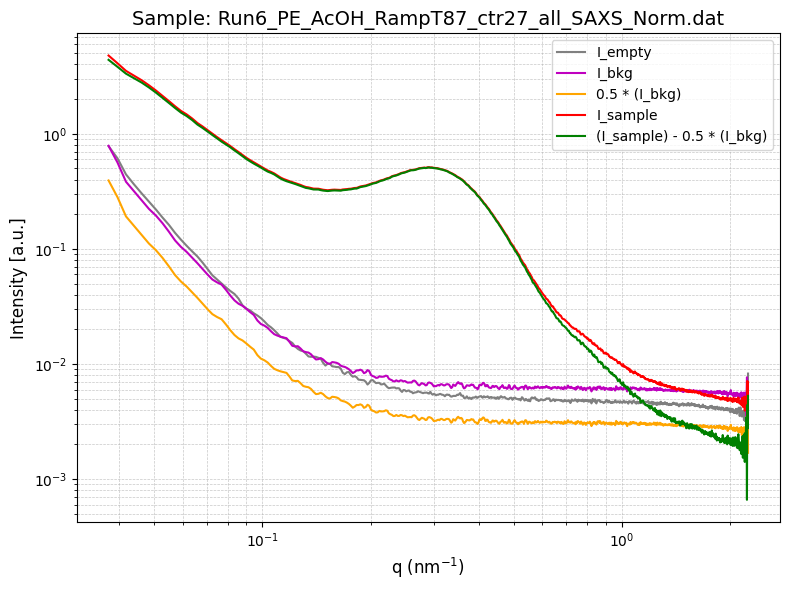

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT87_ctr27_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT90_ctr28_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT90_ctr28_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT90_ctr28_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131241.25666666665, bstop=4.5214, ctemp=91.14335899999999, I0=20.993370000000002
Metadata parsed successfully: Timer=201637.23666666666, bstop=4.784196666666666, ctemp=91.65160099999999, I0=21.07058
Metadata parsed successfully: Timer=101039.35000000002, bstop=5.823316666666667, ctemp=91.78409066666667, I0=20.700313333333334
0.5


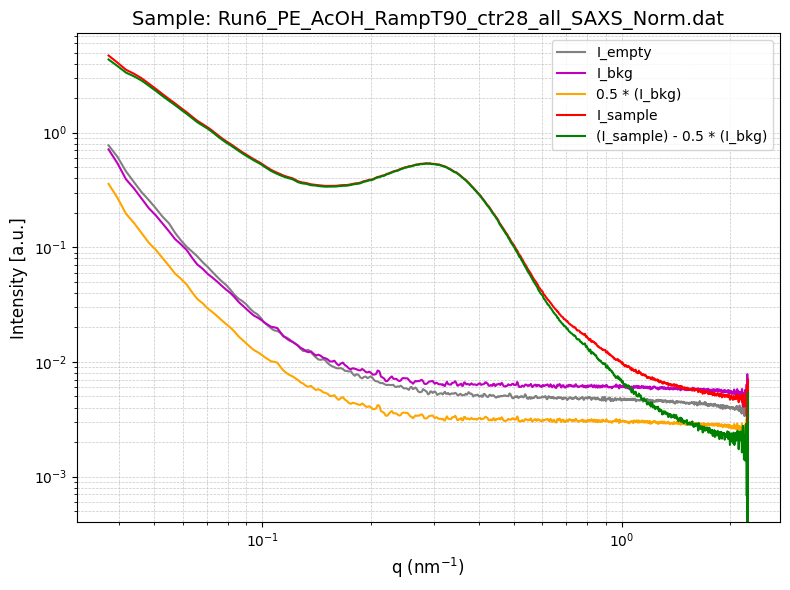

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT90_ctr28_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT92_ctr29_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT92_ctr29_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT92_ctr29_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131328.88, bstop=4.510703333333333, ctemp=93.53049700000001, I0=20.915270000000003
Metadata parsed successfully: Timer=201728.46, bstop=4.759736666666667, ctemp=94.03814466666667, I0=20.975080000000002
Metadata parsed successfully: Timer=101120.76000000001, bstop=5.879203333333334, ctemp=94.163137, I0=20.88855
0.5


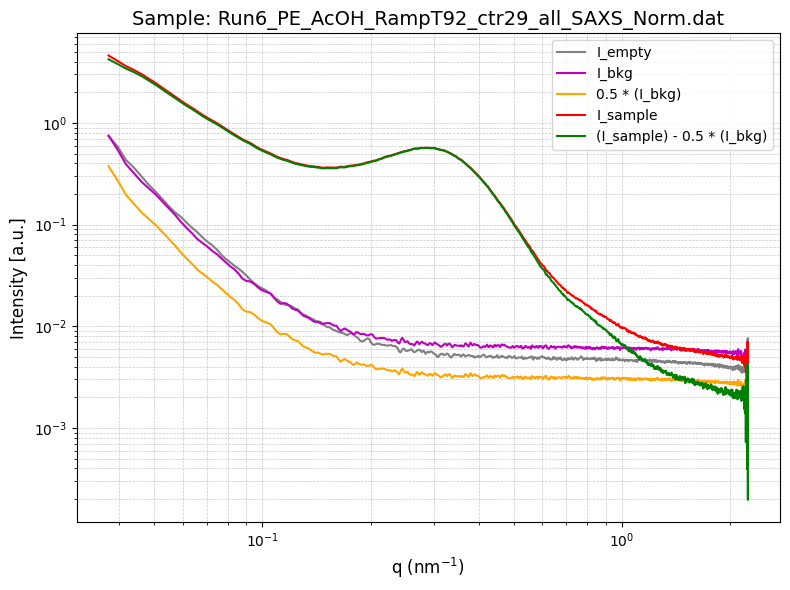

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT92_ctr29_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT95_ctr30_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT95_ctr30_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT95_ctr30_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131414.44666666666, bstop=4.551893333333333, ctemp=96.020055, I0=21.12174333333333
Metadata parsed successfully: Timer=201819.65666666665, bstop=4.74794, ctemp=96.450086, I0=20.908996666666667
Metadata parsed successfully: Timer=101202.0, bstop=5.862333333333333, ctemp=96.58378066666667, I0=20.809070000000002
0.5


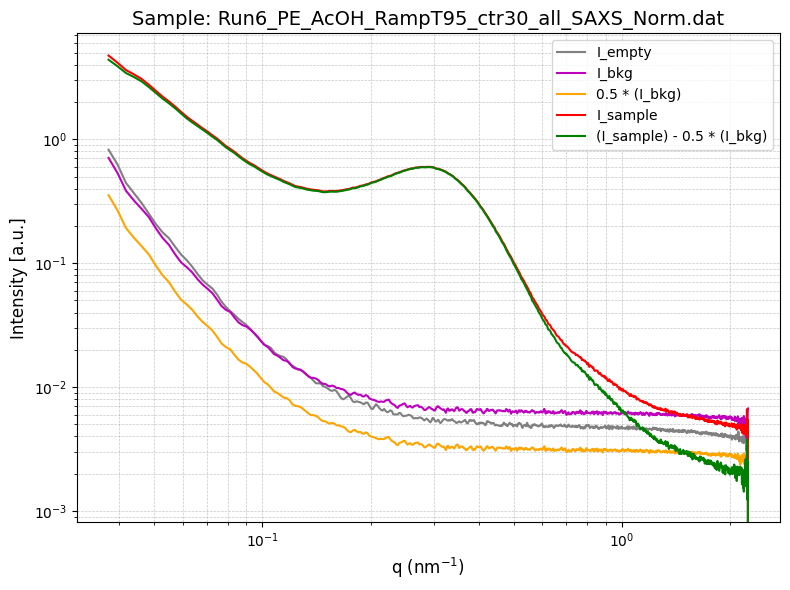

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT95_ctr30_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT97_ctr31_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT97_ctr31_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT97_ctr31_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131501.89333333334, bstop=4.538743333333334, ctemp=98.28188066666667, I0=21.00607666666667
Metadata parsed successfully: Timer=201912.4, bstop=4.79314, ctemp=98.75215633333333, I0=21.09418333333333
Metadata parsed successfully: Timer=101284.55333333334, bstop=5.843393333333332, ctemp=98.96879833333334, I0=20.756583333333335
0.5


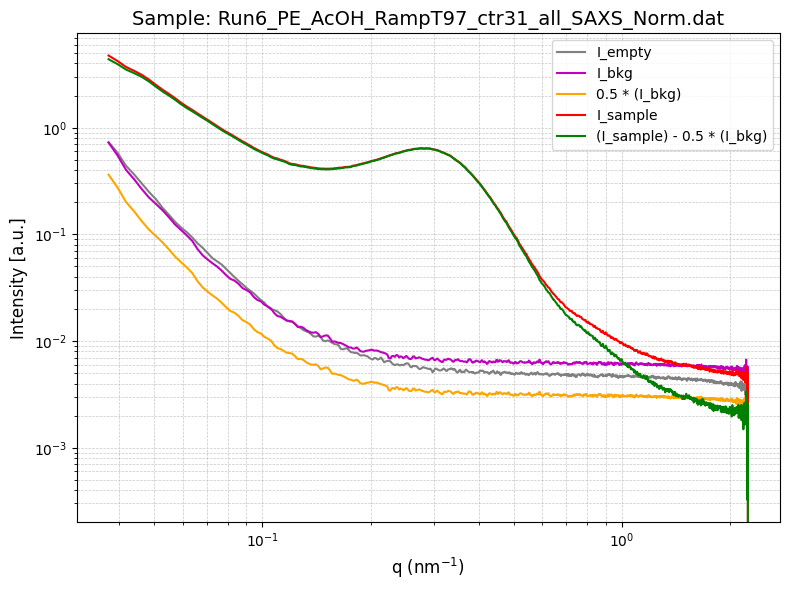

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT97_ctr31_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT100_ctr32_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT100_ctr32_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT100_ctr32_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131595.84333333335, bstop=4.52497, ctemp=102.1275, I0=20.923986666666668
Metadata parsed successfully: Timer=202005.55666666664, bstop=4.780906666666667, ctemp=101.19646666666667, I0=20.985453333333336
Metadata parsed successfully: Timer=101365.75333333334, bstop=5.818543333333333, ctemp=101.3848, I0=20.657466666666668
0.5


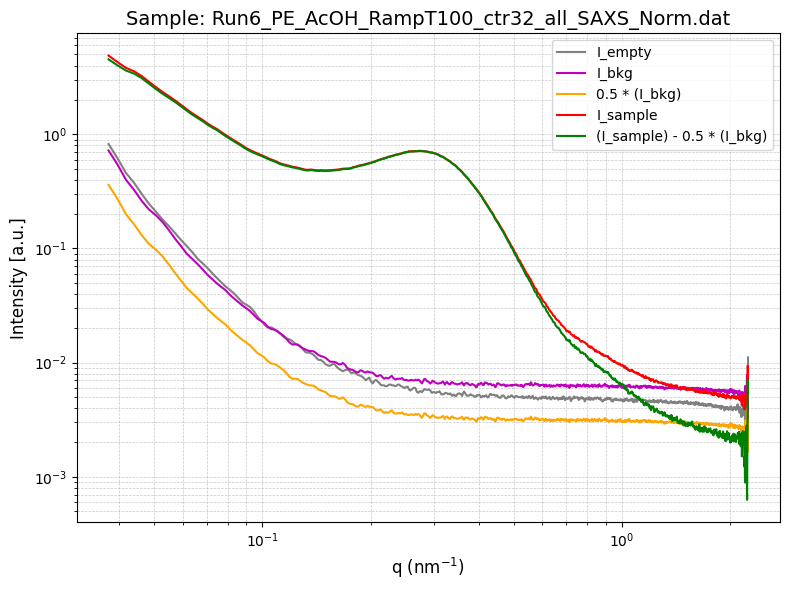

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT100_ctr32_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT102_ctr33_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT102_ctr33_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT102_ctr33_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131687.85333333336, bstop=4.552746666666667, ctemp=103.7401, I0=20.980306666666667
Metadata parsed successfully: Timer=202096.56666666665, bstop=4.761583333333333, ctemp=103.66873333333335, I0=20.900746666666667
Metadata parsed successfully: Timer=101446.65666666666, bstop=5.87716, ctemp=103.7817, I0=20.85352333333333
0.5


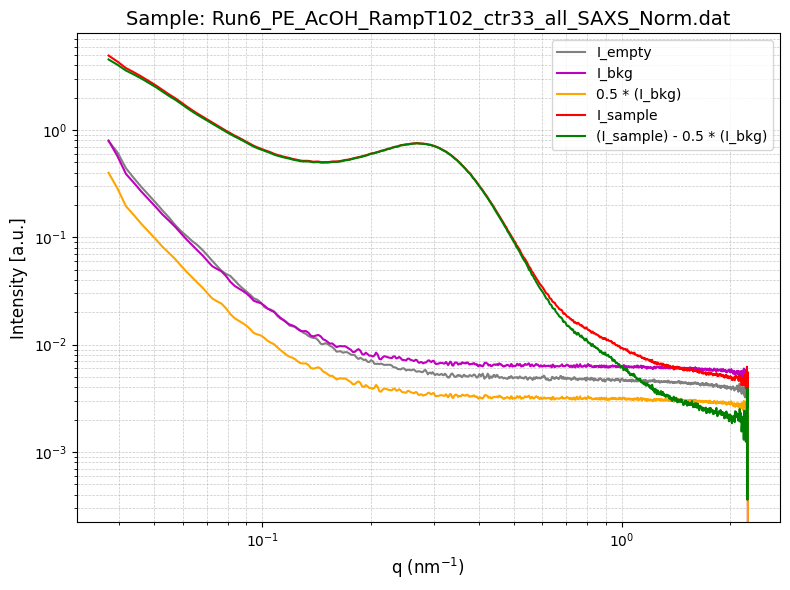

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT102_ctr33_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT105_ctr34_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT105_ctr34_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT105_ctr34_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131784.84333333332, bstop=4.558466666666667, ctemp=105.73513333333334, I0=21.00406
Metadata parsed successfully: Timer=202189.34333333335, bstop=4.780993333333333, ctemp=106.03860000000002, I0=20.957293333333332
Metadata parsed successfully: Timer=101527.97666666668, bstop=5.85748, ctemp=106.1372, I0=20.799333333333333
0.5


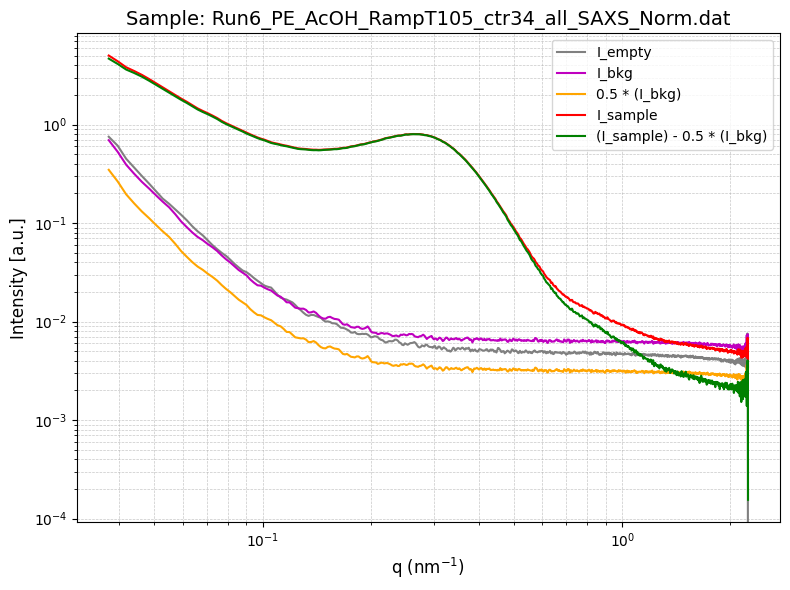

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT105_ctr34_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT107_ctr35_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT107_ctr35_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT107_ctr35_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131874.55000000002, bstop=4.53934, ctemp=108.25900000000001, I0=20.898823333333336
Metadata parsed successfully: Timer=202281.44999999998, bstop=4.8005700000000004, ctemp=108.44243333333333, I0=21.012056666666666
Metadata parsed successfully: Timer=101607.91333333333, bstop=5.835113333333333, ctemp=108.57373333333334, I0=20.70527
0.5


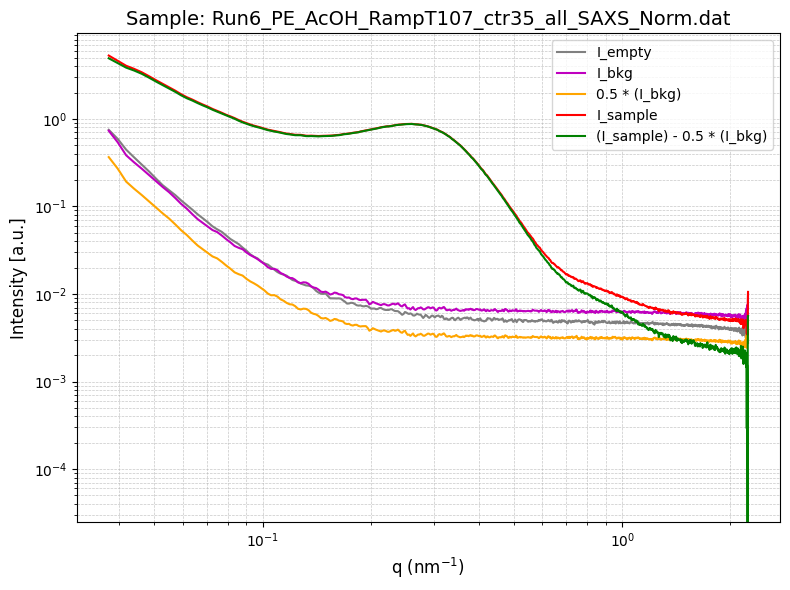

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT107_ctr35_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT110_ctr36_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT110_ctr36_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT110_ctr36_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=131964.74333333332, bstop=4.5159899999999995, ctemp=110.78943333333332, I0=20.838693333333335
Metadata parsed successfully: Timer=202373.81999999998, bstop=4.786073333333333, ctemp=110.81080000000001, I0=20.90017
Metadata parsed successfully: Timer=101686.15333333332, bstop=5.87229, ctemp=111.01943333333334, I0=20.828453333333332
0.5


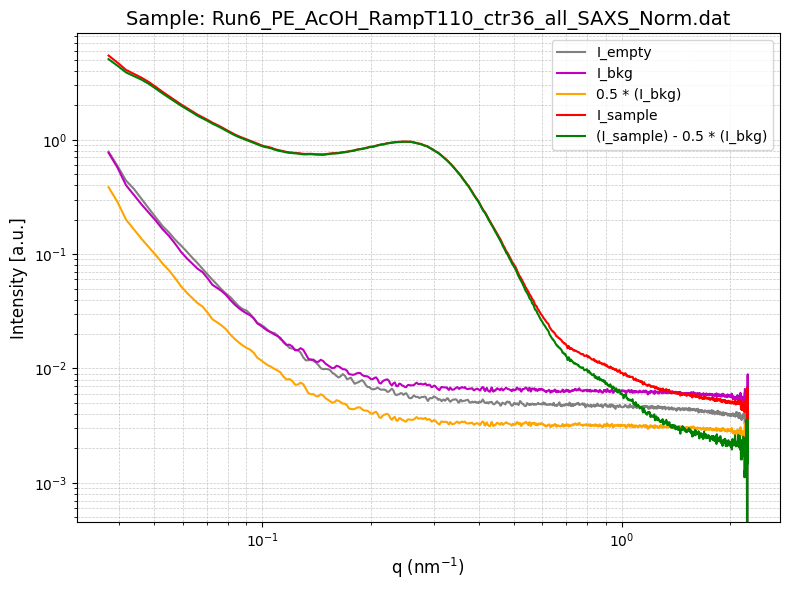

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT110_ctr36_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT112_ctr37_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT112_ctr37_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT112_ctr37_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132056.85666666666, bstop=4.552323333333334, ctemp=113.14893333333333, I0=21.00261
Metadata parsed successfully: Timer=202464.44666666668, bstop=4.76804, ctemp=113.26780000000001, I0=20.816326666666665
Metadata parsed successfully: Timer=101765.72333333333, bstop=5.87947, ctemp=113.41543333333334, I0=20.846613333333334
0.5


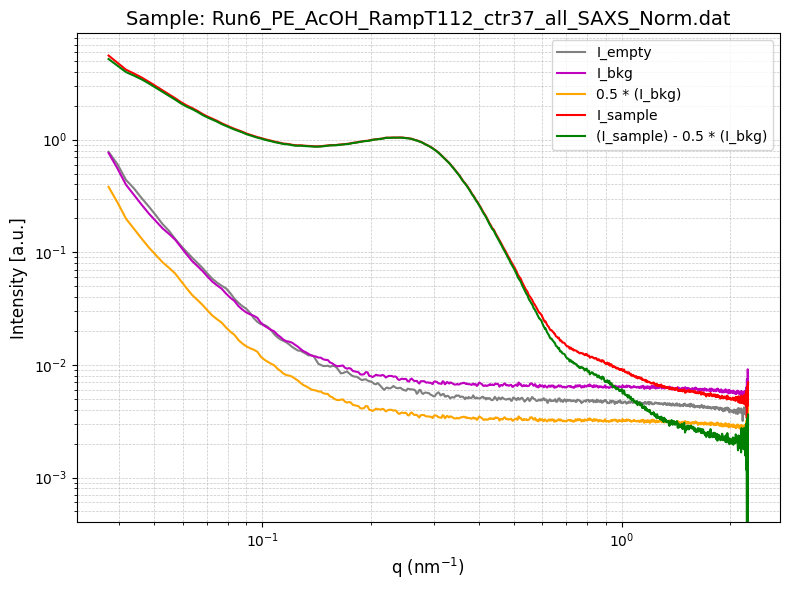

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT112_ctr37_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT115_ctr38_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT115_ctr38_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT115_ctr38_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132148.14, bstop=4.533196666666666, ctemp=115.56276666666668, I0=20.94739
Metadata parsed successfully: Timer=202557.02000000002, bstop=4.817060000000001, ctemp=115.65556666666667, I0=21.052366666666668
Metadata parsed successfully: Timer=101844.71666666666, bstop=5.8613333333333335, ctemp=115.7777, I0=20.761313333333334
0.5


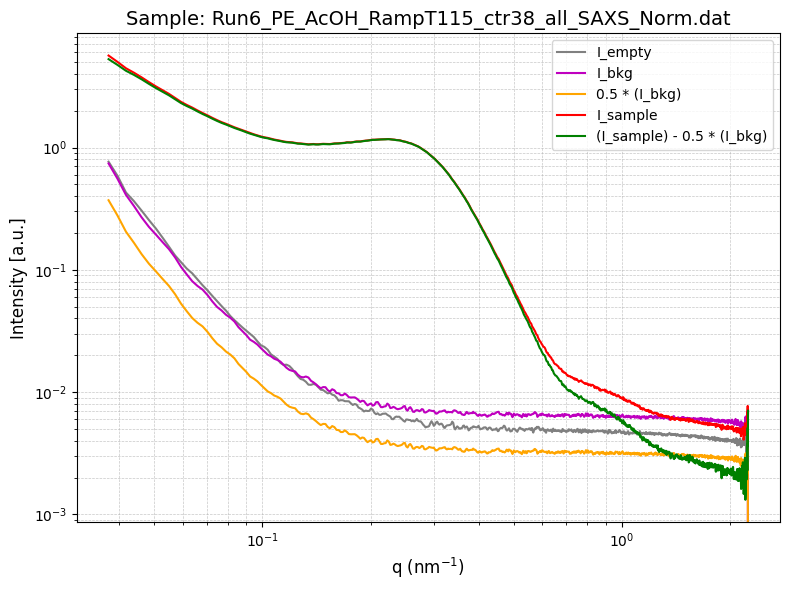

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT115_ctr38_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT117_ctr39_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT117_ctr39_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT117_ctr39_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132239.22, bstop=4.515023333333333, ctemp=118.00106666666666, I0=20.855416666666667
Metadata parsed successfully: Timer=202649.52000000002, bstop=4.79776, ctemp=118.05536666666667, I0=20.96854
Metadata parsed successfully: Timer=101921.36333333334, bstop=5.838793333333332, ctemp=118.22833333333334, I0=20.67021
0.5


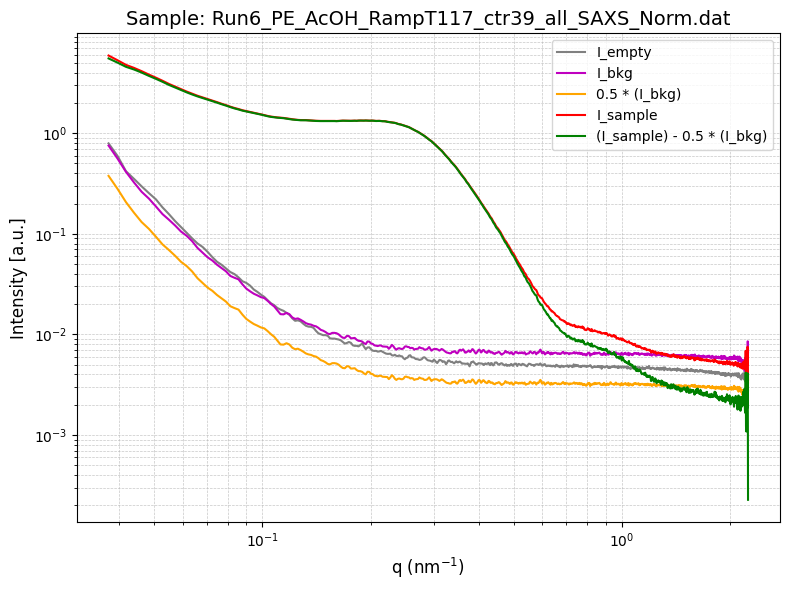

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT117_ctr39_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT120_ctr40_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT120_ctr40_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT120_ctr40_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132331.32, bstop=4.561303333333334, ctemp=120.38250000000001, I0=21.039396666666665
Metadata parsed successfully: Timer=202740.92333333334, bstop=4.781976666666666, ctemp=120.49013333333333, I0=20.825646666666668
Metadata parsed successfully: Timer=101997.87333333334, bstop=5.894159999999999, ctemp=120.70866666666666, I0=20.884656666666668
0.5


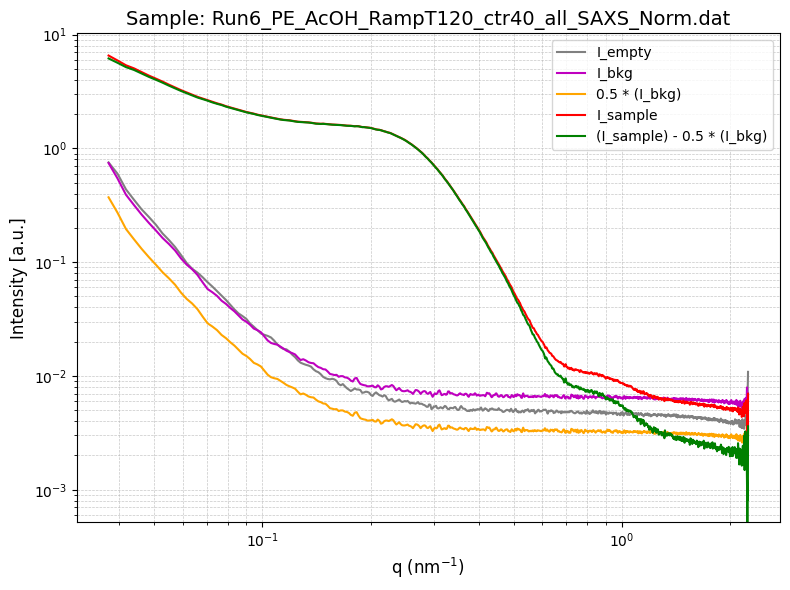

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT120_ctr40_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT122_ctr41_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT122_ctr41_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT122_ctr41_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132424.12333333335, bstop=4.54076, ctemp=122.77926666666667, I0=20.909573333333334
Metadata parsed successfully: Timer=202834.42333333334, bstop=4.8279966666666665, ctemp=122.90323333333333, I0=21.049656666666667
Metadata parsed successfully: Timer=102077.51666666666, bstop=5.88088, ctemp=122.96679999999999, I0=20.854836666666667
0.5


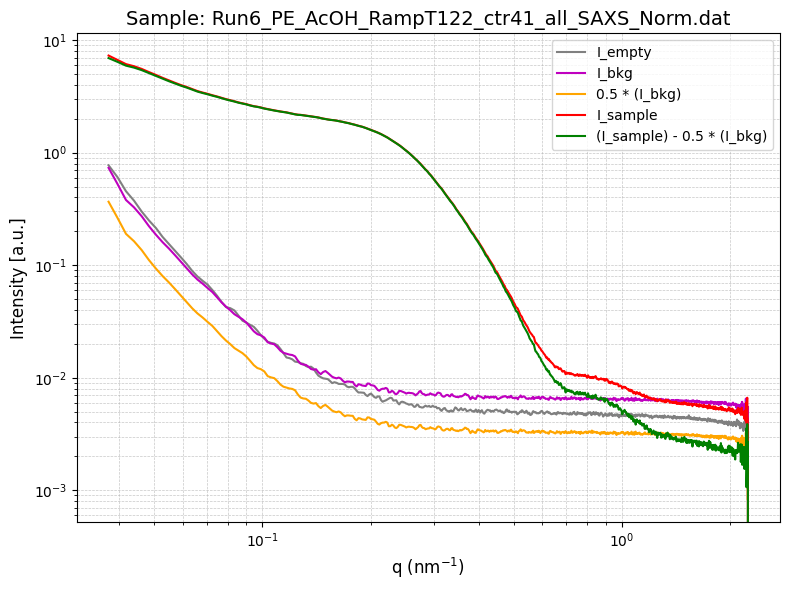

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT122_ctr41_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT125_ctr42_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT125_ctr42_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT125_ctr42_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132517.49666666667, bstop=4.509603333333334, ctemp=125.18666666666667, I0=20.832516666666667
Metadata parsed successfully: Timer=202927.78666666665, bstop=4.810223333333333, ctemp=125.32903333333333, I0=20.94071
Metadata parsed successfully: Timer=102152.88333333335, bstop=5.861236666666667, ctemp=125.50953333333332, I0=20.75476
0.5


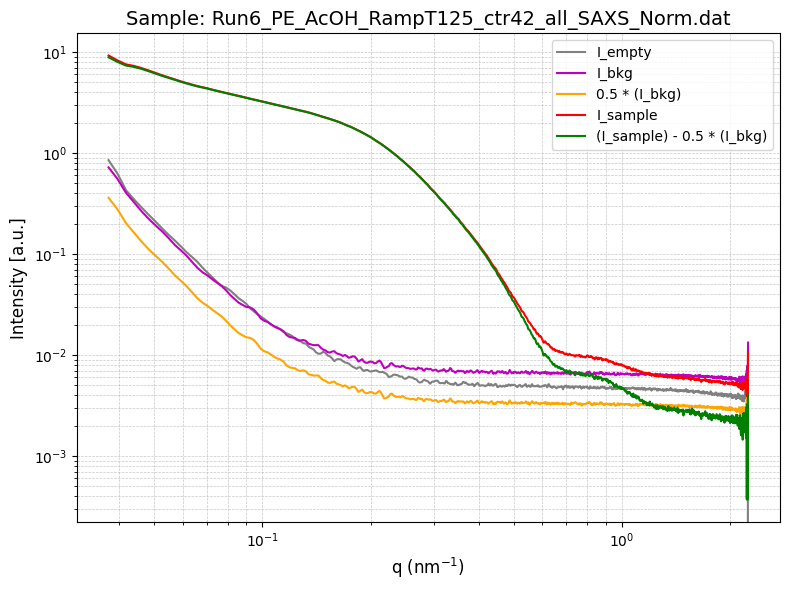

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT125_ctr42_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT127_ctr43_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT127_ctr43_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT127_ctr43_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132611.82666666666, bstop=4.534120000000001, ctemp=127.60303333333333, I0=21.046563333333335
Metadata parsed successfully: Timer=203022.94000000003, bstop=4.79945, ctemp=127.64843333333333, I0=20.84051666666667
Metadata parsed successfully: Timer=102230.46666666667, bstop=5.84212, ctemp=127.87820333333332, I0=20.640953333333332
0.5


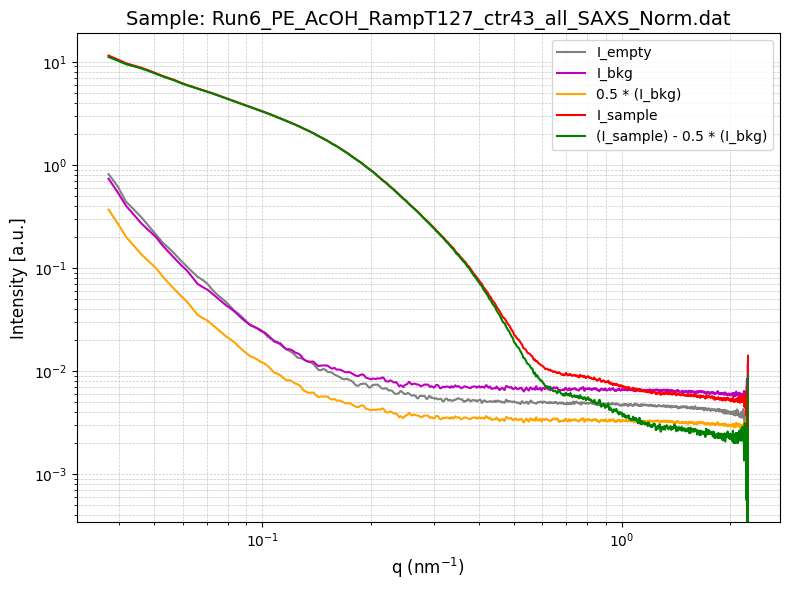

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT127_ctr43_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT130_ctr44_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT130_ctr44_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT130_ctr44_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132706.73, bstop=4.538726666666666, ctemp=130.00276, I0=20.922963333333332
Metadata parsed successfully: Timer=203117.00666666668, bstop=4.848066666666667, ctemp=130.12096666666665, I0=21.073913333333333
Metadata parsed successfully: Timer=102307.45666666667, bstop=5.910903333333334, ctemp=130.27946666666665, I0=20.89997333333333
0.5


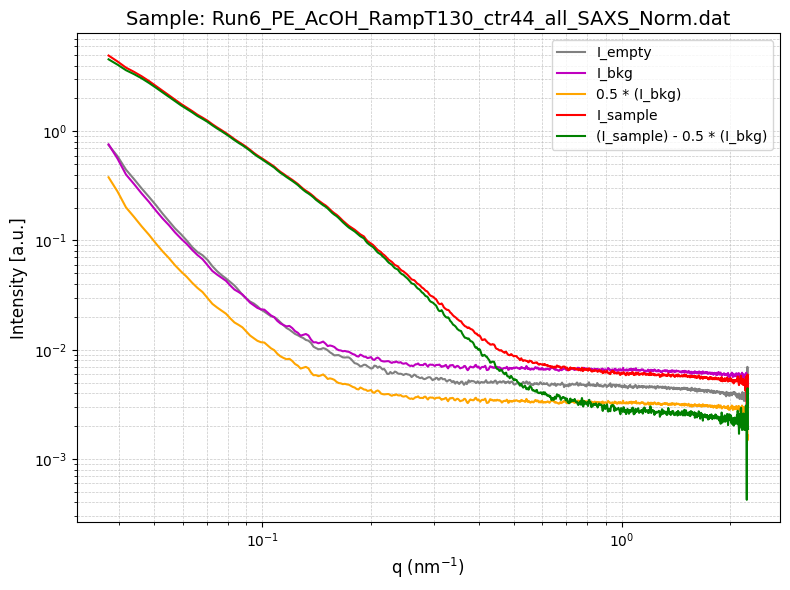

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT130_ctr44_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT132_ctr45_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT132_ctr45_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT132_ctr45_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132800.91333333336, bstop=4.53848, ctemp=132.56222666666667, I0=20.84808
Metadata parsed successfully: Timer=203213.30333333334, bstop=4.82732, ctemp=132.51306666666667, I0=20.959106666666667
Metadata parsed successfully: Timer=102384.39, bstop=5.887523333333334, ctemp=132.65090333333333, I0=20.81502
0.5


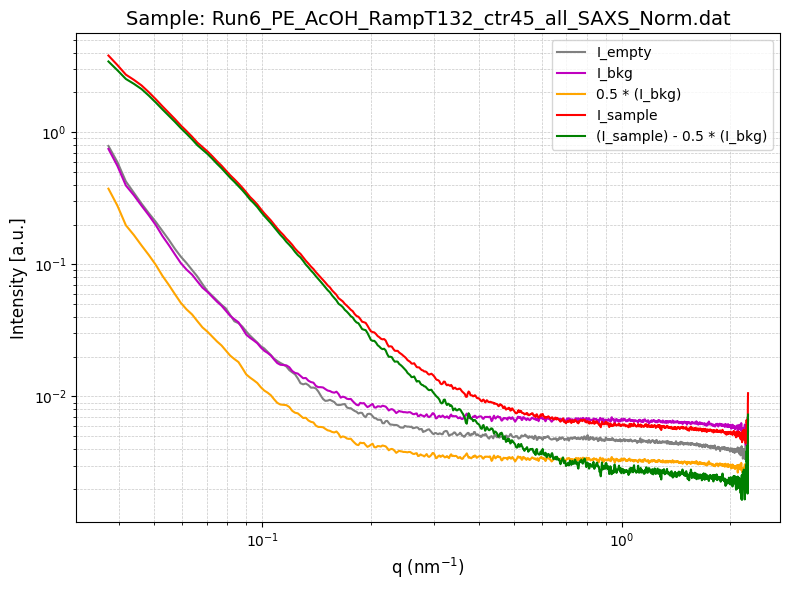

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT132_ctr45_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT135_ctr46_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT135_ctr46_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT135_ctr46_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132899.04333333333, bstop=4.58231, ctemp=134.93776666666665, I0=21.010256666666667
Metadata parsed successfully: Timer=203309.67333333334, bstop=4.81506, ctemp=134.9564, I0=20.847426666666667
Metadata parsed successfully: Timer=102460.00333333334, bstop=5.866363333333333, ctemp=135.16080333333332, I0=20.70958
0.5


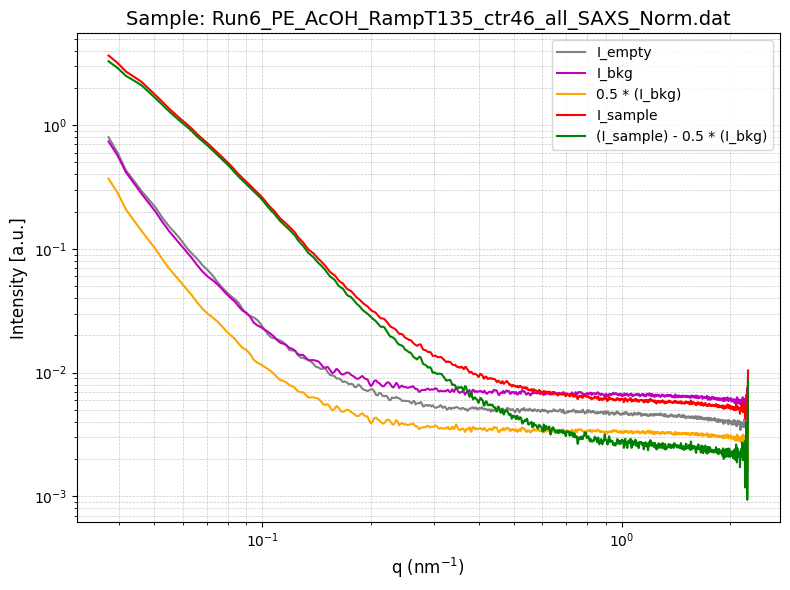

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT135_ctr46_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT137_ctr47_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT137_ctr47_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT137_ctr47_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=132998.07666666666, bstop=4.57566, ctemp=137.31610333333333, I0=20.937473333333333
Metadata parsed successfully: Timer=203408.40666666665, bstop=4.8614766666666664, ctemp=137.37393666666665, I0=21.090506666666666
Metadata parsed successfully: Timer=102539.01333333332, bstop=5.84506, ctemp=137.52160333333333, I0=20.62396
0.5


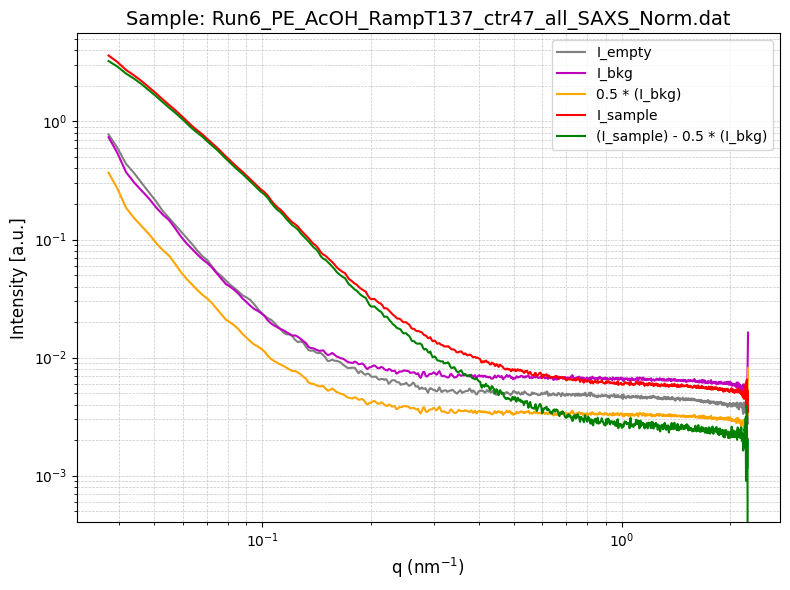

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT137_ctr47_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT140_ctr48_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT140_ctr48_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT140_ctr48_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133096.78, bstop=4.55837, ctemp=139.81126666666668, I0=20.838913333333334
Metadata parsed successfully: Timer=203508.86666666667, bstop=4.841196666666667, ctemp=139.76359333333335, I0=20.9844
Metadata parsed successfully: Timer=102616.71, bstop=5.910679999999999, ctemp=139.96979666666667, I0=20.85699
0.5


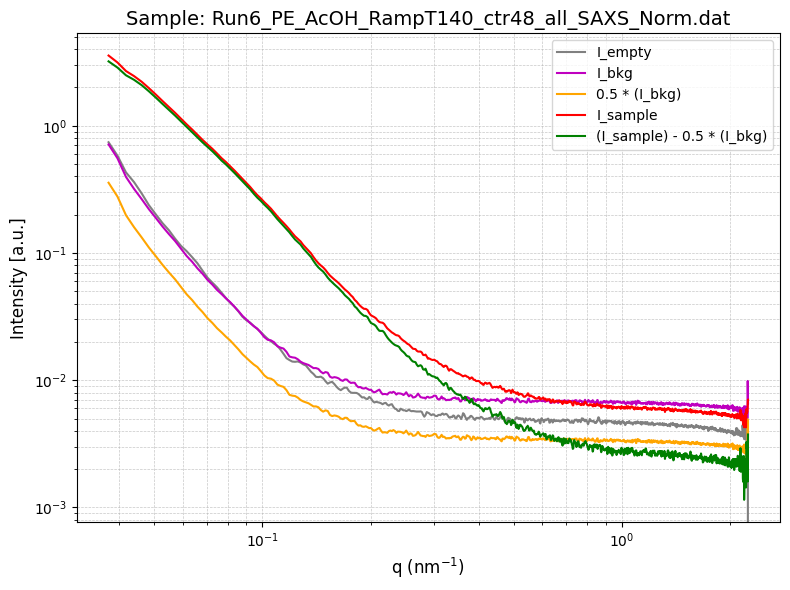

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT140_ctr48_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT142_ctr49_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT142_ctr49_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT142_ctr49_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133199.83666666667, bstop=4.598496666666667, ctemp=142.22546333333332, I0=20.95727666666667
Metadata parsed successfully: Timer=203610.27333333335, bstop=4.82554, ctemp=142.23000333333334, I0=20.86812
Metadata parsed successfully: Timer=102694.35999999999, bstop=5.888343333333334, ctemp=142.41393000000002, I0=20.762629999999998
0.5


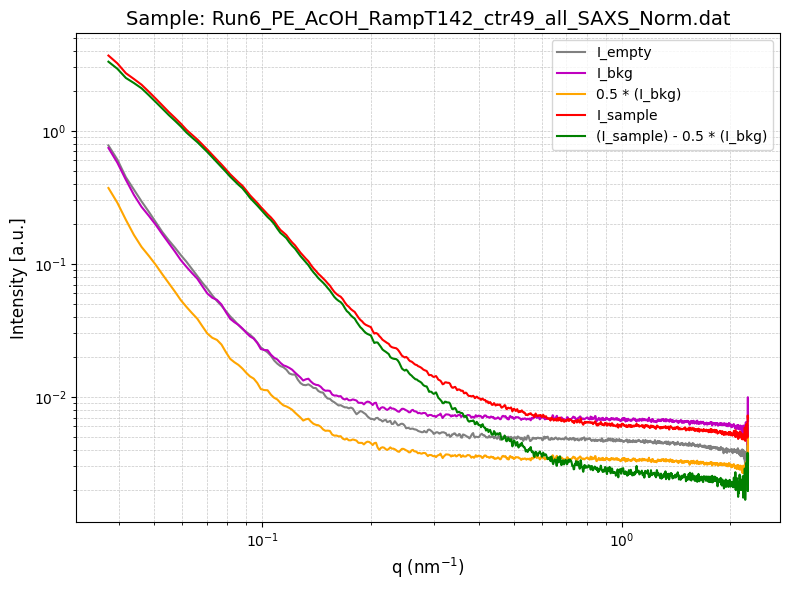

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT142_ctr49_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT145_ctr50_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT145_ctr50_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT145_ctr50_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133303.72, bstop=4.591516666666666, ctemp=144.67409666666666, I0=20.85127
Metadata parsed successfully: Timer=203713.27, bstop=4.878603333333333, ctemp=144.70163333333332, I0=21.074520000000003
Metadata parsed successfully: Timer=102773.23333333334, bstop=5.869, ctemp=144.77586666666664, I0=20.680526666666665
0.5


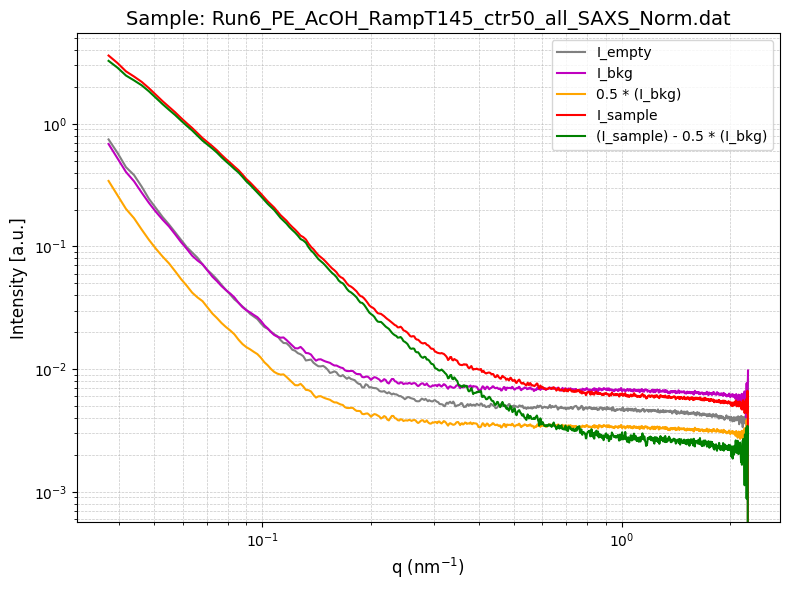

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT145_ctr50_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT147_ctr51_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT147_ctr51_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT147_ctr51_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133410.34, bstop=4.573286666666667, ctemp=147.1027333333333, I0=20.775503333333333
Metadata parsed successfully: Timer=203819.6, bstop=4.858976666666667, ctemp=147.09099666666665, I0=20.97511666666667
Metadata parsed successfully: Timer=102851.96666666667, bstop=5.846633333333334, ctemp=147.21906333333334, I0=20.58438333333333
0.5


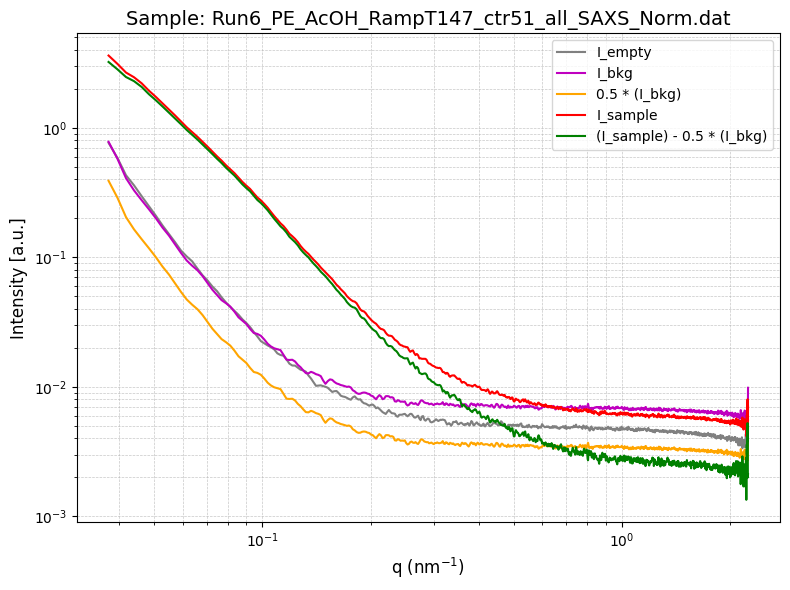

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT147_ctr51_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT150_ctr52_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT150_ctr52_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT150_ctr52_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133518.79666666666, bstop=4.621903333333333, ctemp=149.53719666666666, I0=20.92663333333333
Metadata parsed successfully: Timer=203927.1433333333, bstop=4.839393333333333, ctemp=149.53213333333335, I0=20.84603
Metadata parsed successfully: Timer=102930.88333333335, bstop=5.9028566666666675, ctemp=149.70884, I0=20.775716666666668
0.5


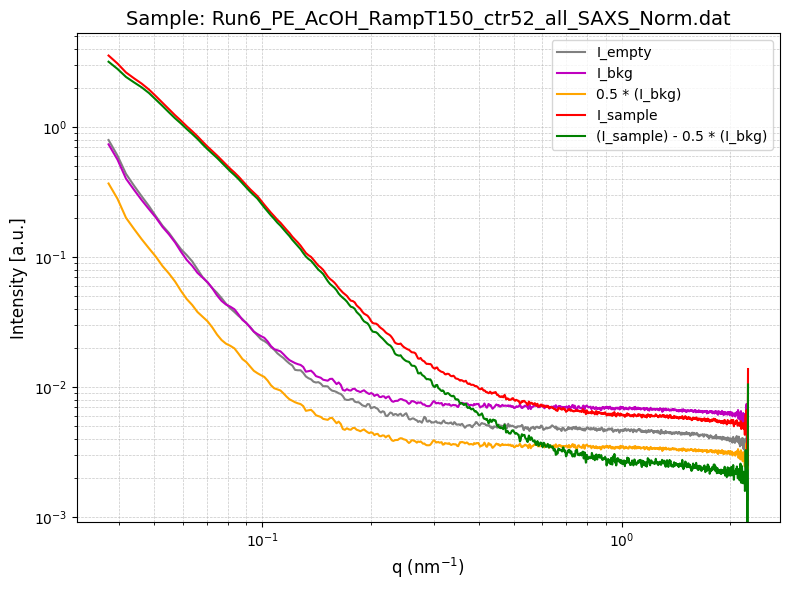

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT150_ctr52_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT152_ctr53_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT152_ctr53_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT152_ctr53_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133629.31333333332, bstop=4.60995, ctemp=152.0456, I0=20.84051666666667
Metadata parsed successfully: Timer=204036.51333333334, bstop=4.882416666666667, ctemp=152.04306666666665, I0=21.020860000000003
Metadata parsed successfully: Timer=103010.74666666666, bstop=5.886886666666666, ctemp=152.16656333333333, I0=20.72554333333333
0.5


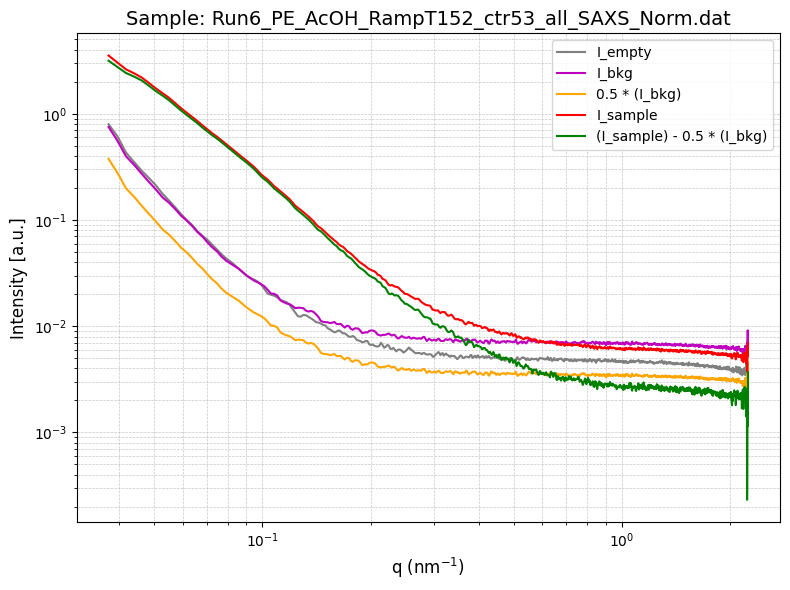

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT152_ctr53_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT155_ctr54_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT155_ctr54_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT155_ctr54_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133743.61666666667, bstop=4.60219, ctemp=154.522, I0=20.718186666666668
Metadata parsed successfully: Timer=204149.22333333336, bstop=4.861903333333333, ctemp=154.5053, I0=20.921923333333336
Metadata parsed successfully: Timer=103092.09999999999, bstop=5.863433333333333, ctemp=154.57296666666667, I0=20.659209999999998
0.5


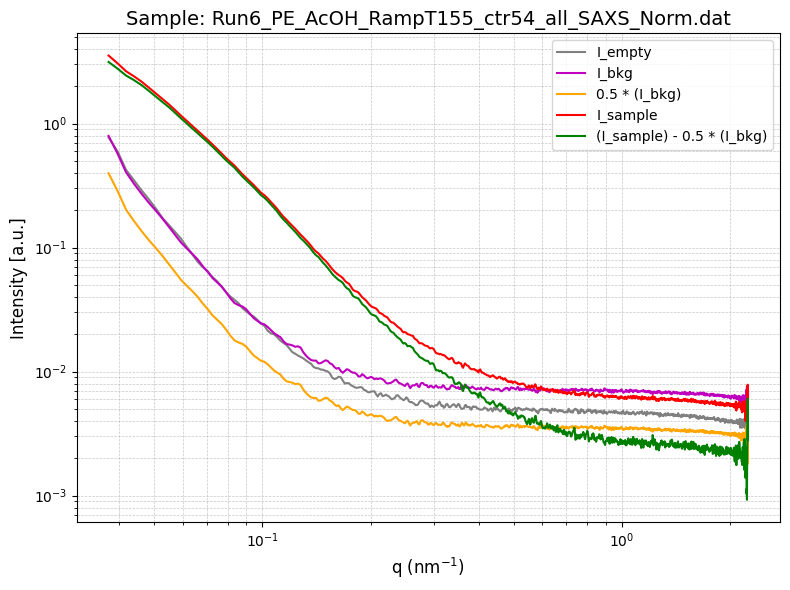

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT155_ctr54_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT157_ctr55_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT157_ctr55_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT157_ctr55_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133861.96333333335, bstop=4.656586666666667, ctemp=156.9715666666667, I0=20.88226
Metadata parsed successfully: Timer=204265.42333333334, bstop=4.84565, ctemp=157.03413333333336, I0=20.789716666666667
Metadata parsed successfully: Timer=103174.56999999999, bstop=5.867896666666667, ctemp=156.98930333333334, I0=20.618550000000003
0.5


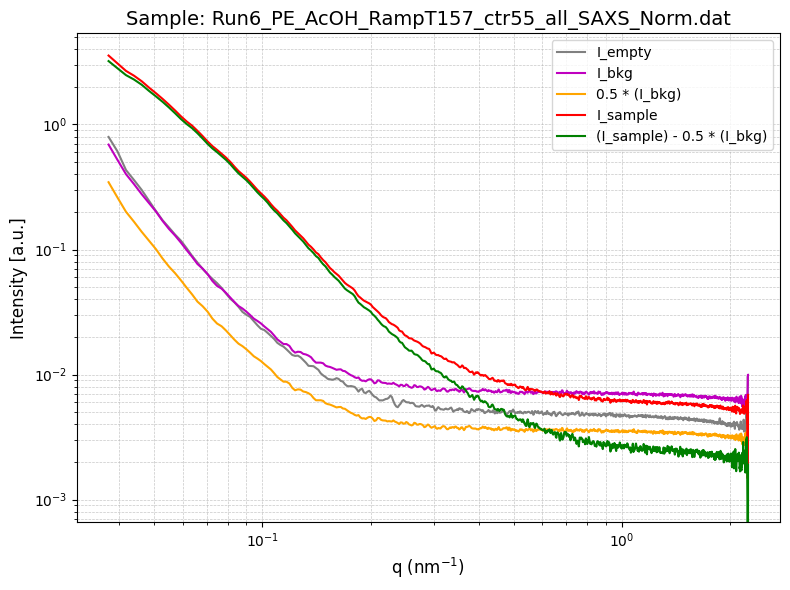

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT157_ctr55_all_SAXS_Norm_sub.dat
Sample: Run6_PE_AcOH_RampT160_ctr56_all_SAXS_Norm.dat
Background: Run10_AcOH_RampT160_ctr56_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT160_ctr56_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=133984.41666666666, bstop=4.651223333333333, ctemp=159.39366666666666, I0=20.735780000000002
Metadata parsed successfully: Timer=204386.05333333332, bstop=4.88164, ctemp=159.44422999999998, I0=20.93062
Metadata parsed successfully: Timer=103256.08333333333, bstop=5.905593333333333, ctemp=159.43426666666667, I0=20.784166666666668
0.5


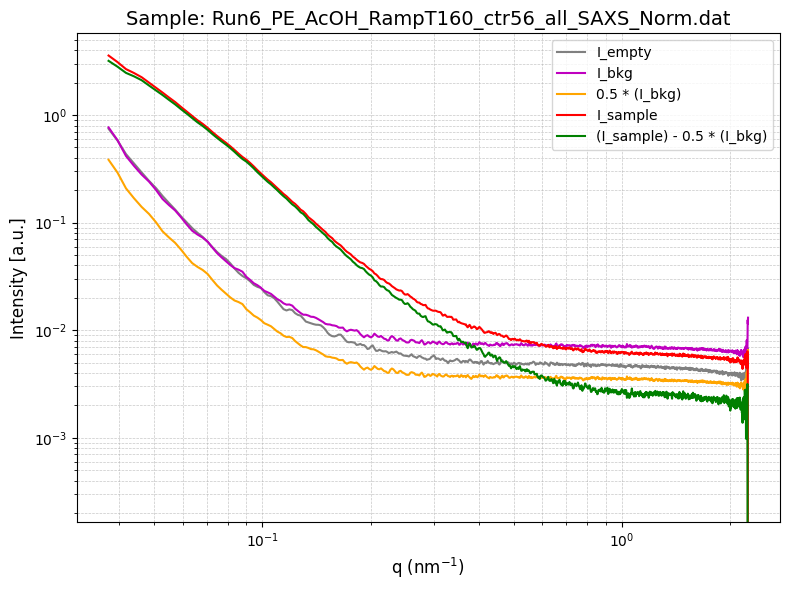

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run6_PE_AcOH_RampT160_ctr56_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT20_ctr0_all_SAXS_Norm.dat
Background: Run14_Salt_RampT20_ctr0_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT20_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=180927.71, bstop=4.74753, ctemp=25.489786666666664, I0=20.770956666666667
Metadata parsed successfully: Timer=232463.16, bstop=4.1611400000000005, ctemp=23.60089066666667, I0=20.767226666666666
Metadata parsed successfully: Timer=99307.11033333333, bstop=5.840843333333333, ctemp=34.443570666666666, I0=20.938636666666667
0.5


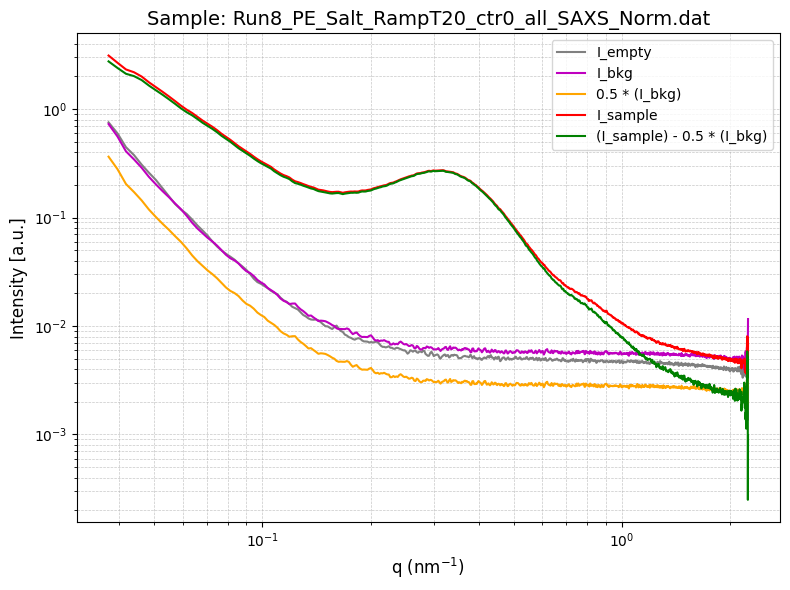

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT20_ctr0_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT22_ctr1_all_SAXS_Norm.dat
Background: Run14_Salt_RampT22_ctr1_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT22_ctr1_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=180974.04333333333, bstop=4.737283333333333, ctemp=25.447500333333334, I0=20.72266
Metadata parsed successfully: Timer=232509.49, bstop=4.203413333333333, ctemp=23.586149666666667, I0=21.005726666666668
Metadata parsed successfully: Timer=99365.84433333333, bstop=5.830806666666667, ctemp=33.97231933333333, I0=20.921406666666666
0.5


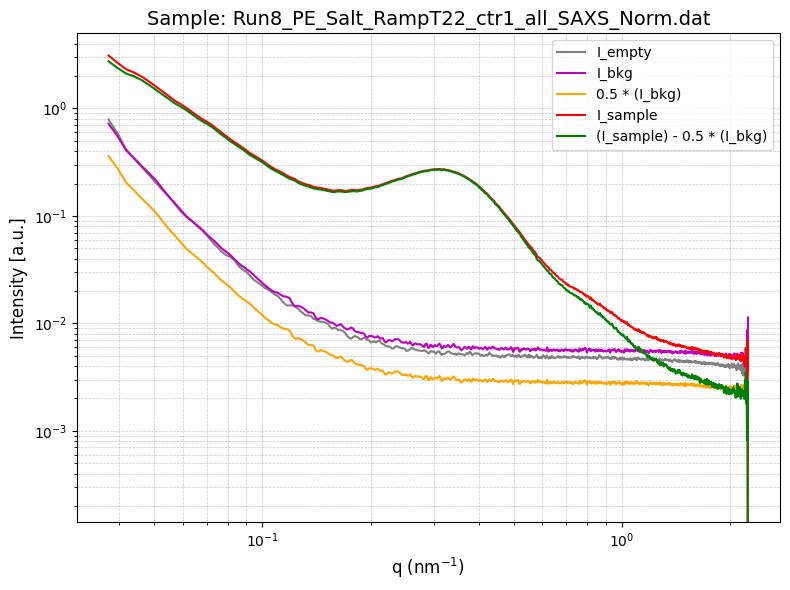

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT22_ctr1_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT25_ctr2_all_SAXS_Norm.dat
Background: Run14_Salt_RampT25_ctr2_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT25_ctr2_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181019.1, bstop=4.723153333333333, ctemp=25.405586, I0=20.68992
Metadata parsed successfully: Timer=232588.58666666667, bstop=4.194793333333334, ctemp=29.17830033333333, I0=20.951330000000002
Metadata parsed successfully: Timer=99423.16733333333, bstop=5.810923333333332, ctemp=33.551553, I0=20.893069999999998
0.5


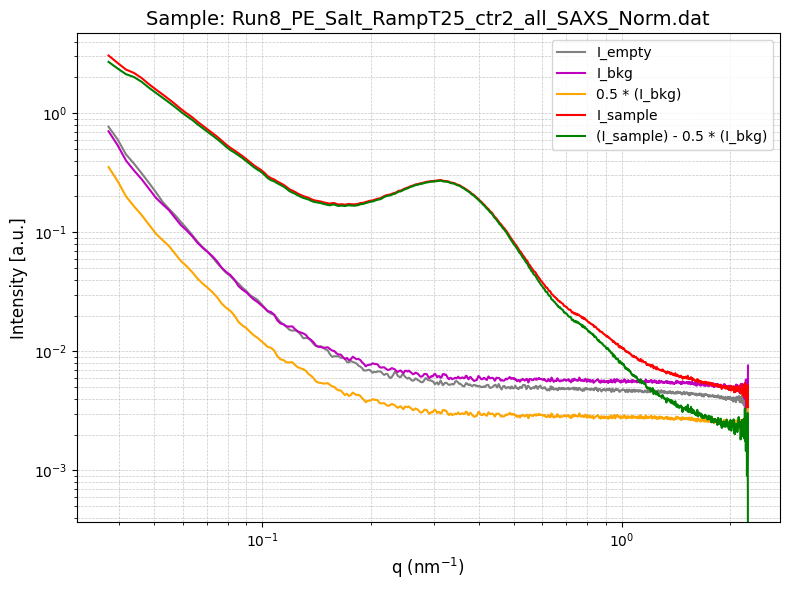

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT25_ctr2_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT27_ctr3_all_SAXS_Norm.dat
Background: Run14_Salt_RampT27_ctr3_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT27_ctr3_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181094.79, bstop=4.7158066666666665, ctemp=31.668273, I0=20.617606666666667
Metadata parsed successfully: Timer=232634.80666666664, bstop=4.187196666666666, ctemp=29.333666333333337, I0=20.900686666666665
Metadata parsed successfully: Timer=99468.67166666668, bstop=5.799493333333333, ctemp=33.214679999999994, I0=20.83780333333333
0.5


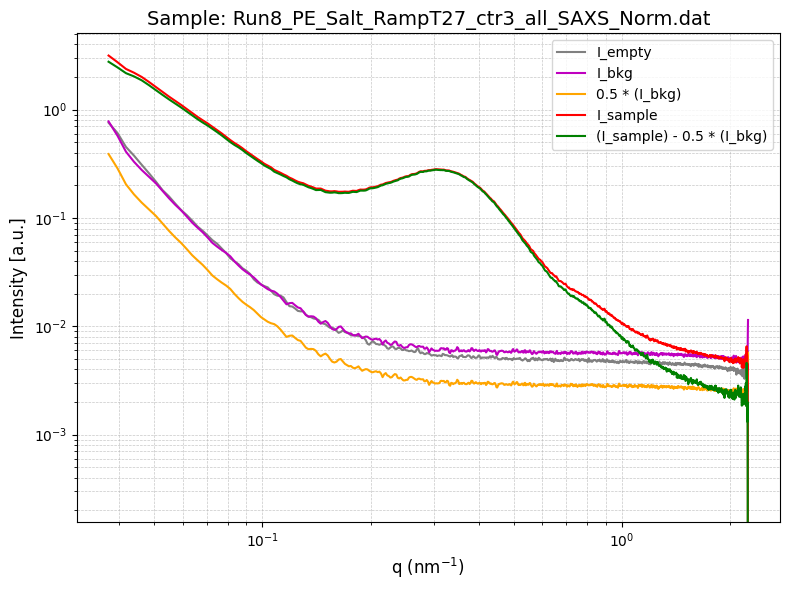

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT27_ctr3_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT30_ctr4_all_SAXS_Norm.dat
Background: Run14_Salt_RampT30_ctr4_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT30_ctr4_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181139.93000000002, bstop=4.7029, ctemp=32.05538, I0=20.57220666666667
Metadata parsed successfully: Timer=232706.80333333334, bstop=4.18037, ctemp=33.51053866666666, I0=20.809596666666668
Metadata parsed successfully: Timer=99513.91933333332, bstop=5.787286666666667, ctemp=32.918487666666664, I0=20.73201
0.5


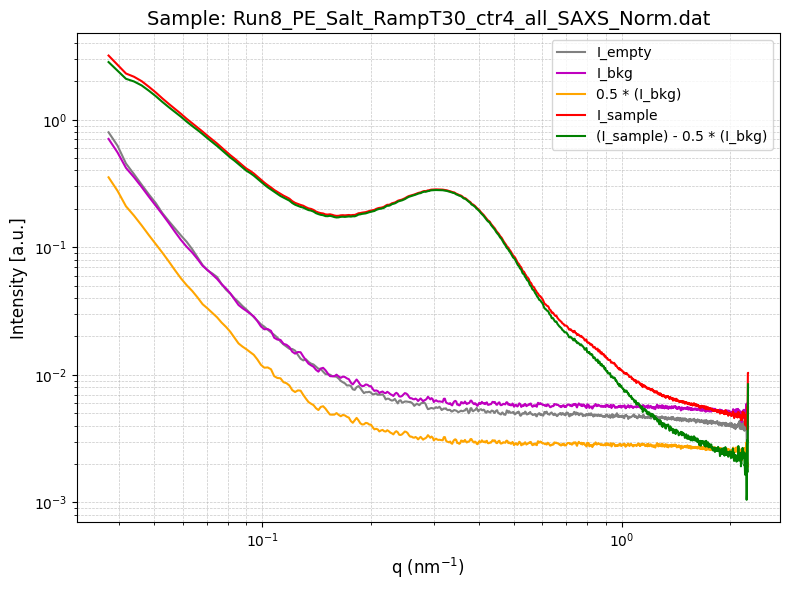

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT30_ctr4_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT32_ctr5_all_SAXS_Norm.dat
Background: Run14_Salt_RampT32_ctr5_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT32_ctr5_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181211.29666666663, bstop=4.756923333333333, ctemp=36.05521666666667, I0=20.86673
Metadata parsed successfully: Timer=232755.8933333333, bstop=4.17499, ctemp=33.75966666666667, I0=20.775199999999998
Metadata parsed successfully: Timer=99559.58, bstop=5.78169, ctemp=32.600447333333335, I0=20.742136666666667
0.5


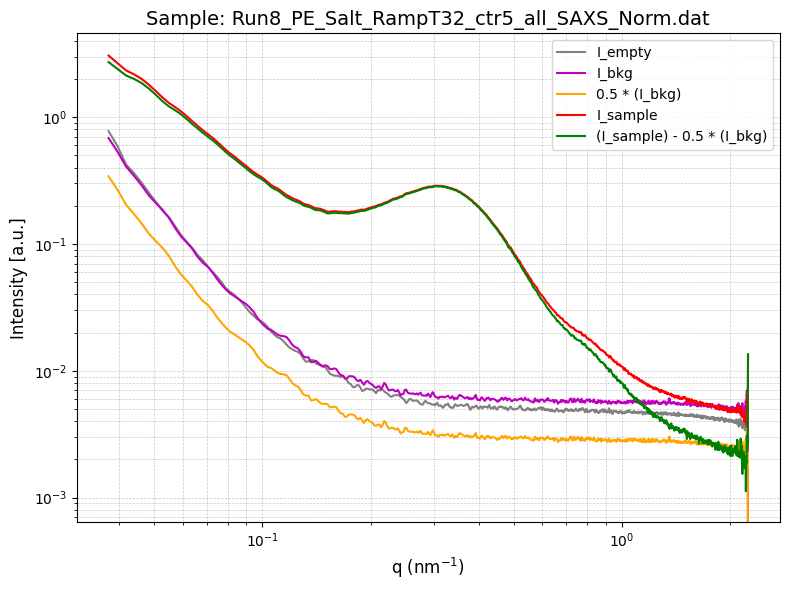

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT32_ctr5_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT35_ctr6_all_SAXS_Norm.dat
Background: Run14_Salt_RampT35_ctr6_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT35_ctr6_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181256.31999999998, bstop=4.747656666666667, ctemp=36.286282666666665, I0=20.762676666666668
Metadata parsed successfully: Timer=232831.34, bstop=4.2221400000000004, ctemp=38.55007066666667, I0=20.937536666666663
Metadata parsed successfully: Timer=99633.86133333335, bstop=5.838693333333334, ctemp=38.843533666666666, I0=20.93518
0.5


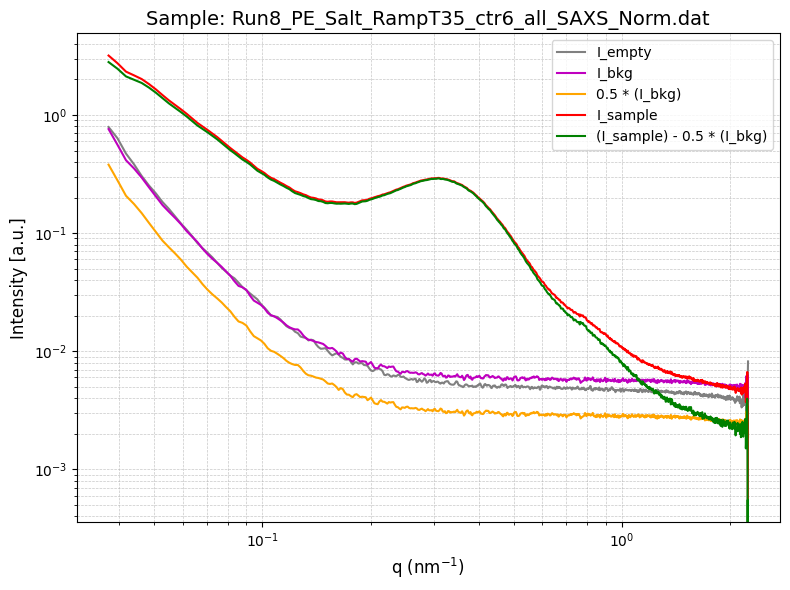

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT35_ctr6_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT37_ctr7_all_SAXS_Norm.dat
Background: Run14_Salt_RampT37_ctr7_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT37_ctr7_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181331.87333333332, bstop=4.733536666666667, ctemp=41.179870666666666, I0=20.676893333333336
Metadata parsed successfully: Timer=232876.7633333333, bstop=4.2115, ctemp=38.38516366666667, I0=20.958940000000002
Metadata parsed successfully: Timer=99679.034, bstop=5.829153333333333, ctemp=38.72539266666667, I0=20.918186666666667
0.5


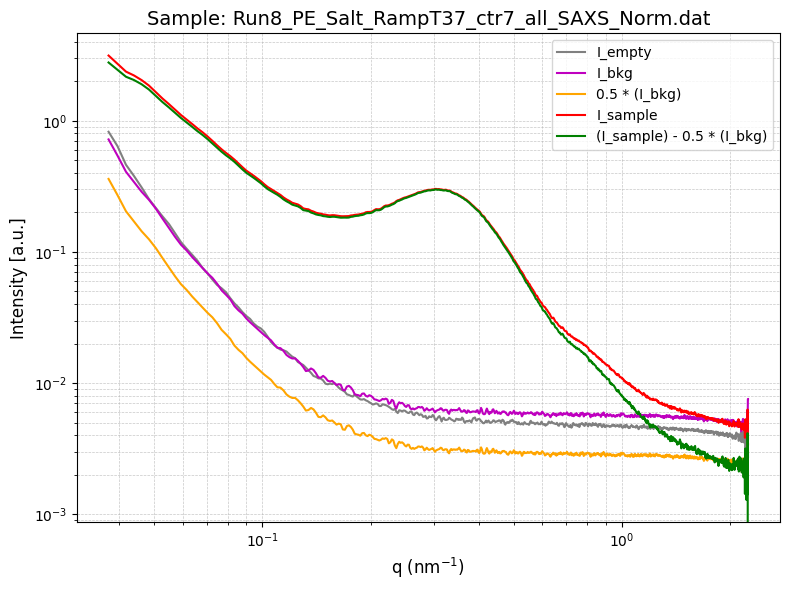

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT37_ctr7_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT40_ctr8_all_SAXS_Norm.dat
Background: Run14_Salt_RampT40_ctr8_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT40_ctr8_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181376.86666666667, bstop=4.72463, ctemp=40.83014933333333, I0=20.68601
Metadata parsed successfully: Timer=232956.5, bstop=4.206213333333333, ctemp=43.448884666666665, I0=20.836413333333336
Metadata parsed successfully: Timer=99750.322, bstop=5.81963, ctemp=43.62077733333333, I0=20.877156666666664
0.5


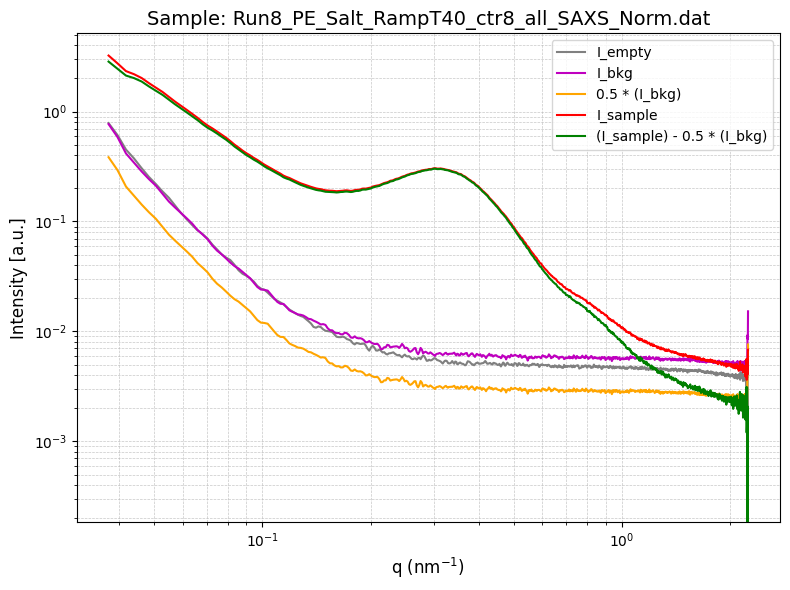

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT40_ctr8_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT42_ctr9_all_SAXS_Norm.dat
Background: Run14_Salt_RampT42_ctr9_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT42_ctr9_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181455.61666666667, bstop=4.714276666666667, ctemp=46.019339, I0=20.54928666666667
Metadata parsed successfully: Timer=233001.56666666665, bstop=4.202590000000001, ctemp=42.878560333333326, I0=20.82045666666667
Metadata parsed successfully: Timer=99795.70766666665, bstop=5.807546666666667, ctemp=43.147533333333335, I0=20.79771666666667
0.5


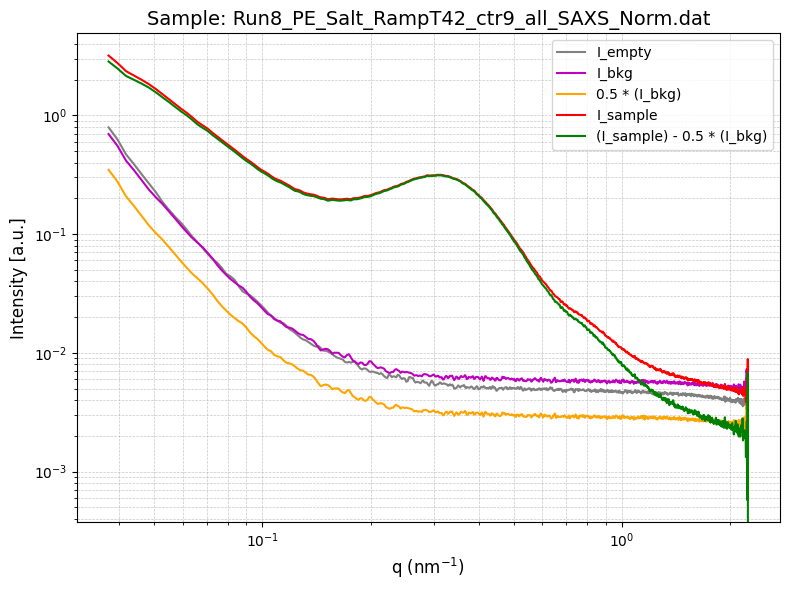

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT42_ctr9_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT45_ctr10_all_SAXS_Norm.dat
Background: Run14_Salt_RampT45_ctr10_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT45_ctr10_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181500.53333333333, bstop=4.76238, ctemp=45.26894000000001, I0=20.818753333333333
Metadata parsed successfully: Timer=233076.86666666667, bstop=4.2106666666666674, ctemp=48.247973, I0=20.828276666666667
Metadata parsed successfully: Timer=99868.68433333332, bstop=5.800446666666667, ctemp=48.465106999999996, I0=20.782663333333332
0.5


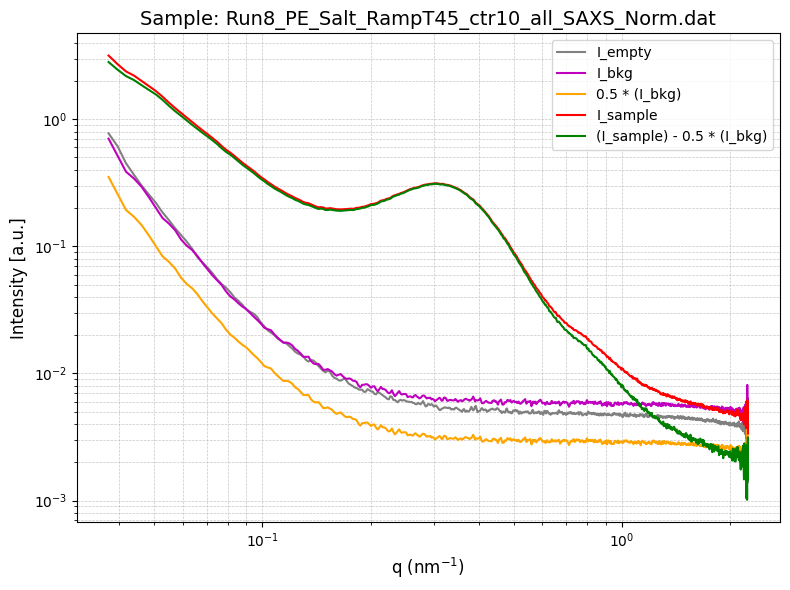

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT45_ctr10_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT47_ctr11_all_SAXS_Norm.dat
Background: Run14_Salt_RampT47_ctr11_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT47_ctr11_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181570.44666666666, bstop=4.753076666666666, ctemp=50.83456433333333, I0=20.744533333333333
Metadata parsed successfully: Timer=233126.0, bstop=4.237513333333333, ctemp=47.46963233333333, I0=20.97756
Metadata parsed successfully: Timer=99913.87799999998, bstop=5.858826666666666, ctemp=47.67397066666666, I0=21.01381333333333
0.5


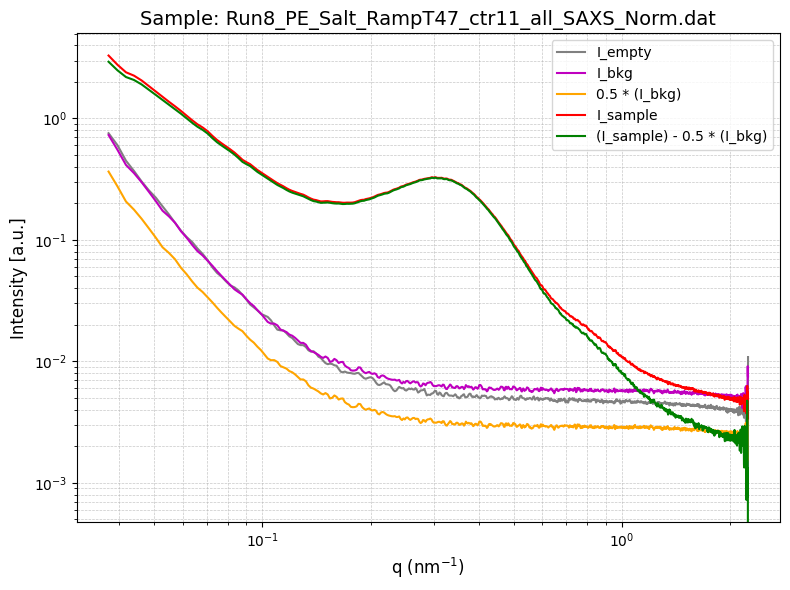

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT47_ctr11_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT50_ctr12_all_SAXS_Norm.dat
Background: Run14_Salt_RampT50_ctr12_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT50_ctr12_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181614.9833333333, bstop=4.747753333333333, ctemp=49.96953566666667, I0=20.728189999999998
Metadata parsed successfully: Timer=233184.86666666667, bstop=4.230823333333333, ctemp=50.492616, I0=20.907236666666666
Metadata parsed successfully: Timer=99978.898, bstop=5.837656666666667, ctemp=53.127939999999995, I0=20.92560333333333
0.5


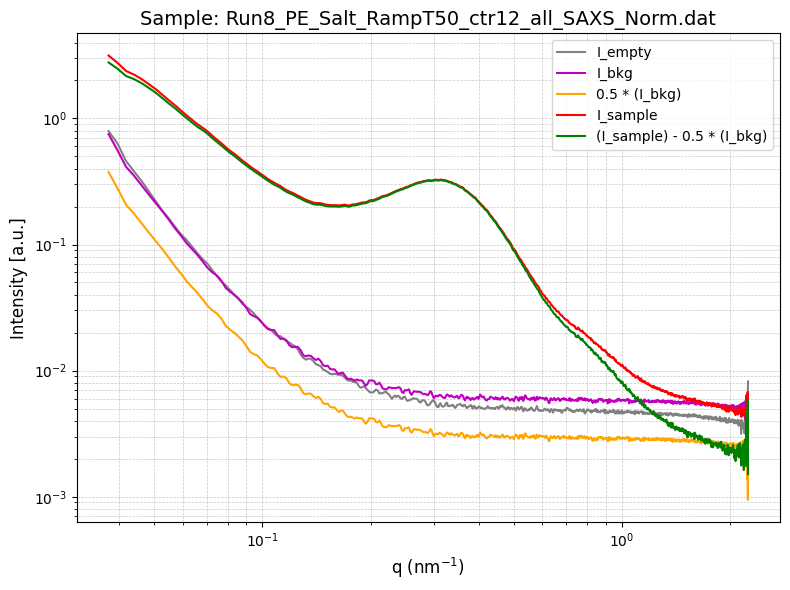

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT50_ctr12_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT52_ctr13_all_SAXS_Norm.dat
Background: Run14_Salt_RampT52_ctr13_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT52_ctr13_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181674.92333333334, bstop=4.74007, ctemp=53.592823, I0=20.64191
Metadata parsed successfully: Timer=233265.8933333333, bstop=4.22635, ctemp=55.48115066666667, I0=20.81612
Metadata parsed successfully: Timer=100023.95333333332, bstop=5.829620000000001, ctemp=52.813783, I0=20.848119999999998
0.5


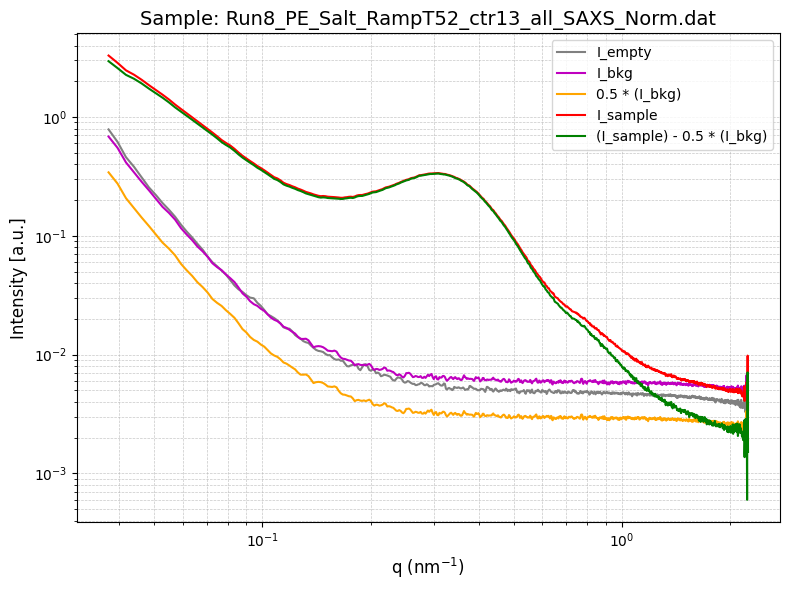

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT52_ctr13_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT55_ctr14_all_SAXS_Norm.dat
Background: Run14_Salt_RampT55_ctr14_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT55_ctr14_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181756.22333333336, bstop=4.723019999999999, ctemp=57.997149, I0=20.57406333333333
Metadata parsed successfully: Timer=233310.49666666667, bstop=4.217973333333333, ctemp=55.086953666666666, I0=20.786126666666664
Metadata parsed successfully: Timer=100076.63, bstop=5.819333333333333, ctemp=54.89452, I0=20.81392
0.5


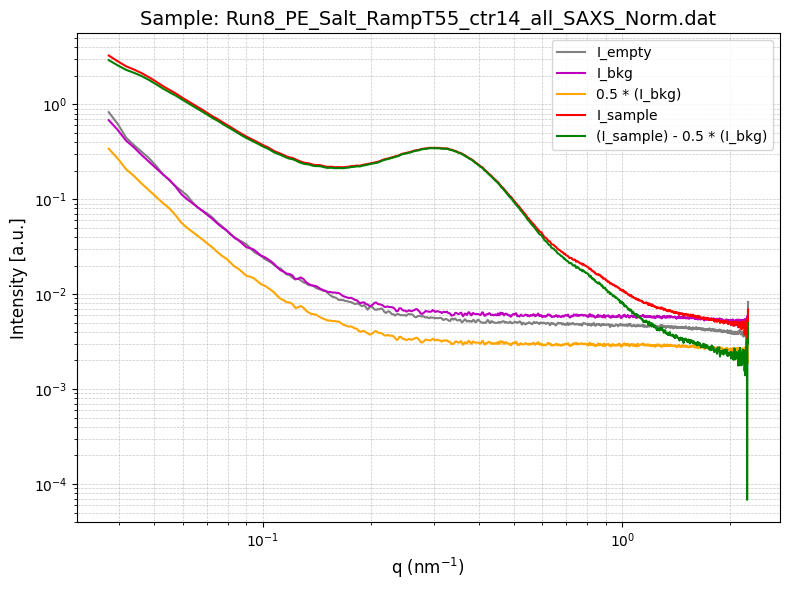

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT55_ctr14_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT57_ctr15_all_SAXS_Norm.dat
Background: Run14_Salt_RampT57_ctr15_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT57_ctr15_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181801.55999999997, bstop=4.769909999999999, ctemp=57.61213066666667, I0=20.781859999999998
Metadata parsed successfully: Timer=233363.04333333333, bstop=4.213076666666666, ctemp=57.63899133333333, I0=20.774559999999997
Metadata parsed successfully: Timer=100136.75333333334, bstop=5.800503333333334, ctemp=57.61553933333334, I0=20.770363333333332
0.5


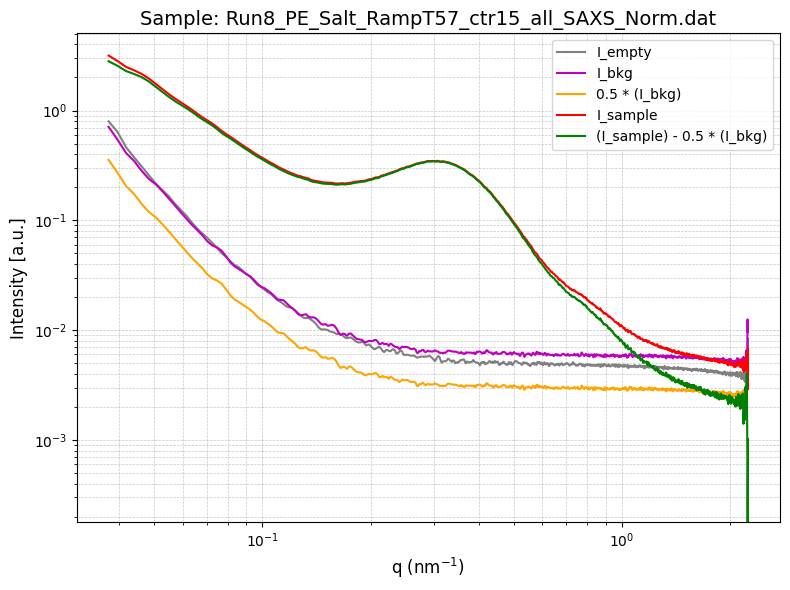

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT57_ctr15_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT60_ctr16_all_SAXS_Norm.dat
Background: Run14_Salt_RampT60_ctr16_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT60_ctr16_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181851.64666666664, bstop=4.762383333333333, ctemp=60.186577, I0=20.777676666666668
Metadata parsed successfully: Timer=233438.04, bstop=4.255883333333334, ctemp=62.674995333333335, I0=20.961956666666666
Metadata parsed successfully: Timer=100203.45, bstop=5.867506666666666, ctemp=62.813933, I0=20.99655
0.5


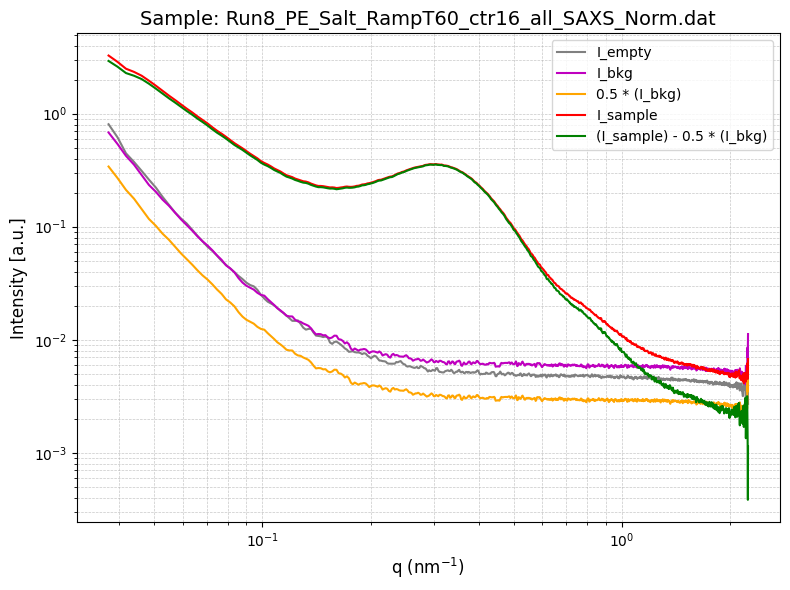

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT60_ctr16_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT62_ctr17_all_SAXS_Norm.dat
Background: Run14_Salt_RampT62_ctr17_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT62_ctr17_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181927.50333333333, bstop=4.75411, ctemp=65.19823466666666, I0=20.67854
Metadata parsed successfully: Timer=233483.13999999998, bstop=4.2468900000000005, ctemp=62.42707300000001, I0=20.910853333333336
Metadata parsed successfully: Timer=100248.33666666667, bstop=5.856400000000001, ctemp=63.165203, I0=20.957256666666666
0.5


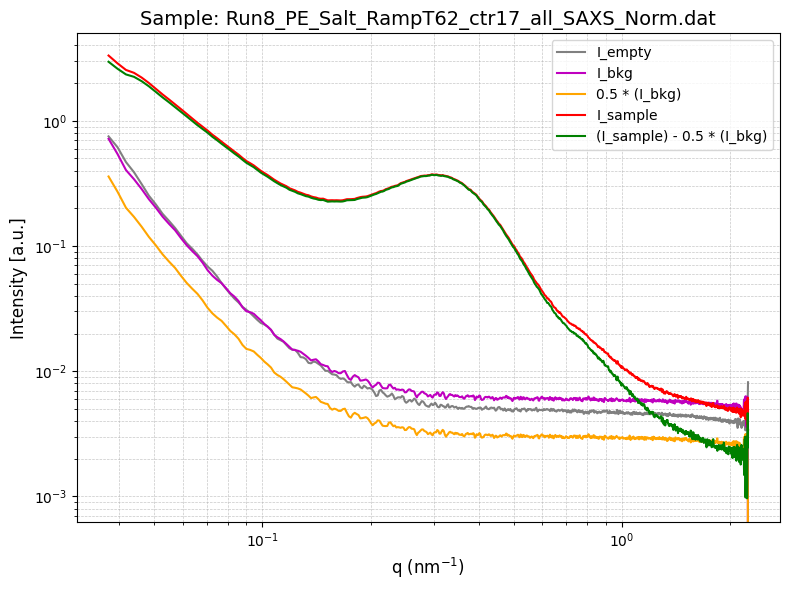

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT62_ctr17_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT65_ctr18_all_SAXS_Norm.dat
Background: Run14_Salt_RampT65_ctr18_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT65_ctr18_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=181971.77000000002, bstop=4.741376666666667, ctemp=64.80197266666666, I0=20.70311
Metadata parsed successfully: Timer=233532.42333333334, bstop=4.244386666666666, ctemp=64.864624, I0=20.870703333333335
Metadata parsed successfully: Timer=100293.22666666668, bstop=5.84461, ctemp=65.00760899999999, I0=20.90917
0.5


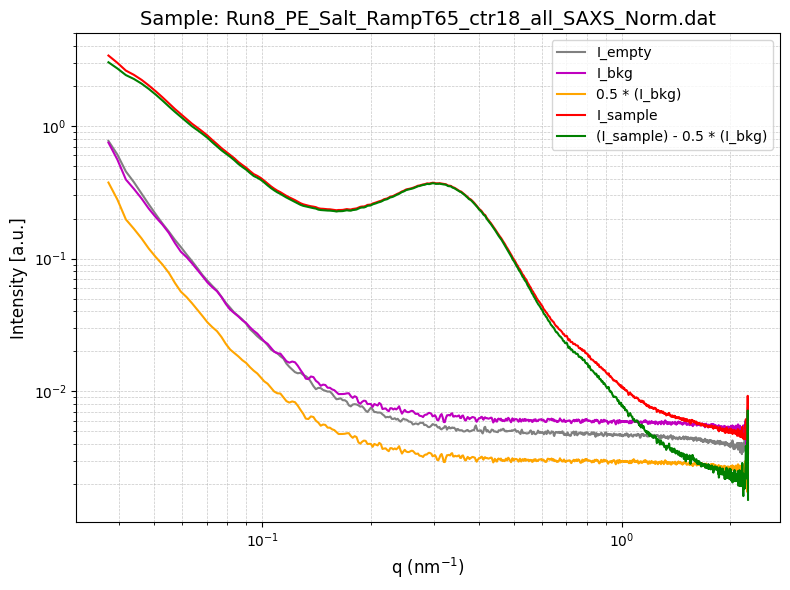

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT65_ctr18_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT67_ctr19_all_SAXS_Norm.dat
Background: Run14_Salt_RampT67_ctr19_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT67_ctr19_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182021.67, bstop=4.736606666666667, ctemp=67.37047299999999, I0=20.59455
Metadata parsed successfully: Timer=233602.59333333335, bstop=4.241813333333333, ctemp=69.869807, I0=20.795393333333333
Metadata parsed successfully: Timer=100353.27666666666, bstop=5.835886666666667, ctemp=69.978709, I0=20.84414
0.5


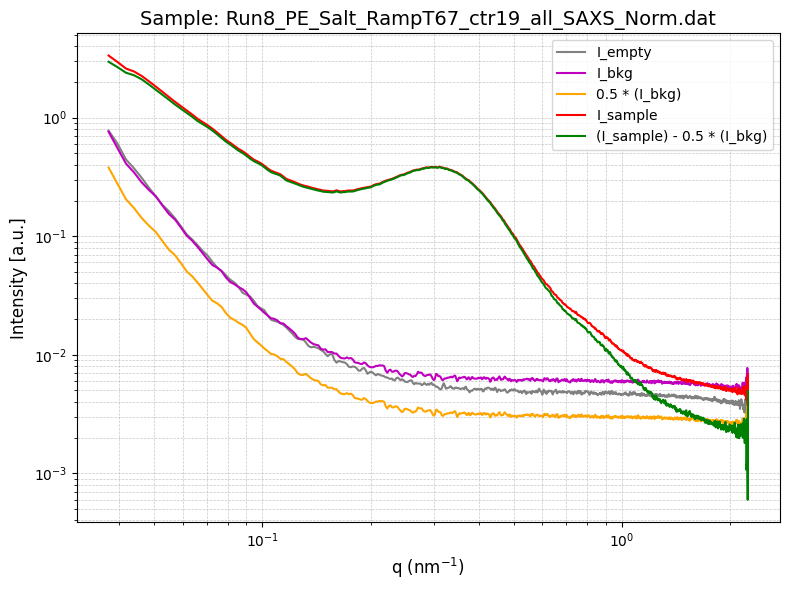

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT67_ctr19_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT70_ctr20_all_SAXS_Norm.dat
Background: Run14_Salt_RampT70_ctr20_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT70_ctr20_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182091.6433333333, bstop=4.767446666666667, ctemp=72.37532533333335, I0=20.735463333333332
Metadata parsed successfully: Timer=233682.68666666665, bstop=4.253616666666667, ctemp=72.27212766666666, I0=20.83084666666667
Metadata parsed successfully: Timer=100425.39999999998, bstop=5.81923, ctemp=72.51002, I0=20.77344666666667
0.5


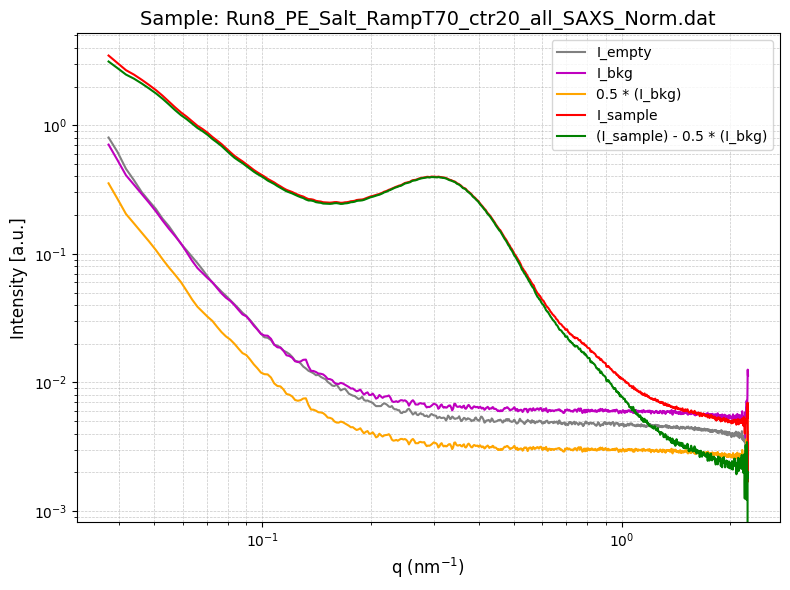

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT70_ctr20_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT72_ctr21_all_SAXS_Norm.dat
Background: Run14_Salt_RampT72_ctr21_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT72_ctr21_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182177.93666666668, bstop=4.766303333333334, ctemp=74.770579, I0=20.74261
Metadata parsed successfully: Timer=233763.7233333333, bstop=4.27199, ctemp=74.69967633333333, I0=20.927456666666668
Metadata parsed successfully: Timer=100498.26666666666, bstop=5.868986666666667, ctemp=74.93459566666667, I0=20.939493333333335
0.5


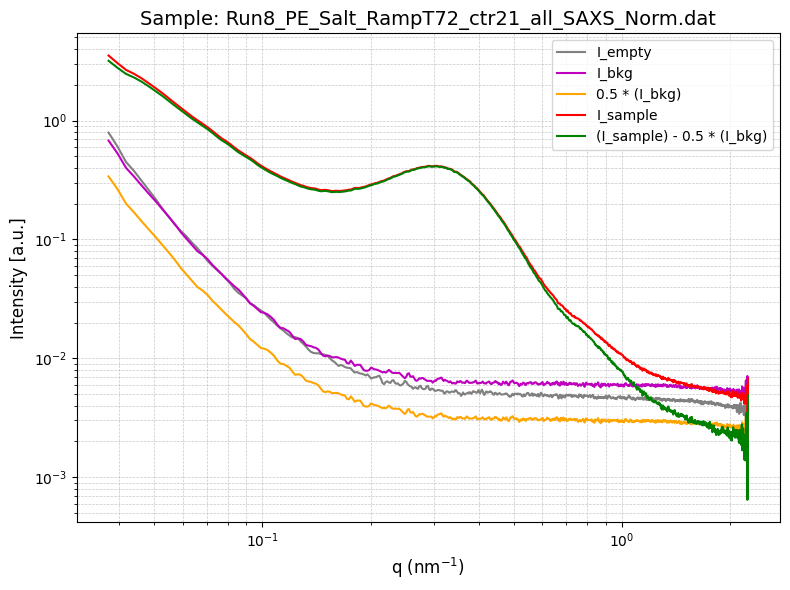

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT72_ctr21_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT75_ctr22_all_SAXS_Norm.dat
Background: Run14_Salt_RampT75_ctr22_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT75_ctr22_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182261.70333333334, bstop=4.7461899999999995, ctemp=77.27234866666667, I0=20.64334666666667
Metadata parsed successfully: Timer=233845.70333333337, bstop=4.260233333333333, ctemp=77.13915233333333, I0=20.854896666666665
Metadata parsed successfully: Timer=100572.14000000001, bstop=5.860913333333333, ctemp=77.36410266666667, I0=20.907236666666666
0.5


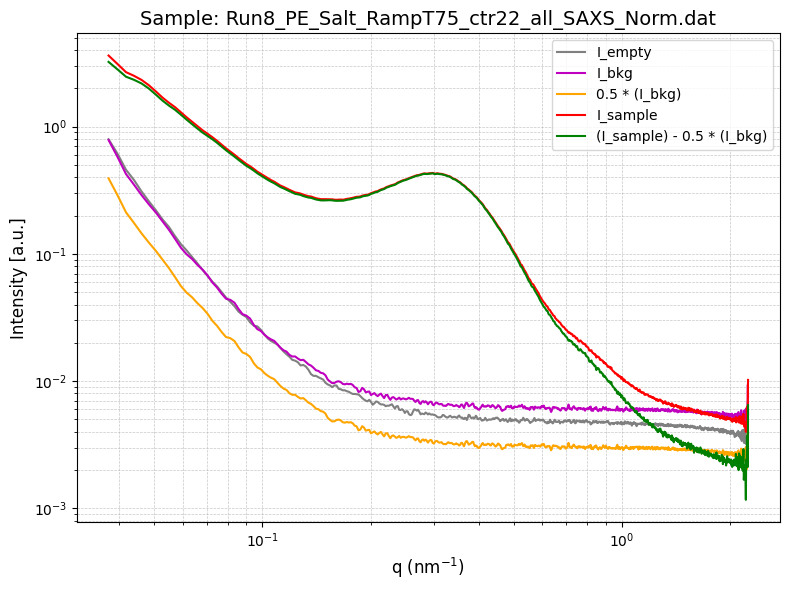

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT75_ctr22_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT77_ctr23_all_SAXS_Norm.dat
Background: Run14_Salt_RampT77_ctr23_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT77_ctr23_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182345.92333333334, bstop=4.7237, ctemp=79.686994, I0=20.58277
Metadata parsed successfully: Timer=233928.8633333333, bstop=4.25047, ctemp=79.59052533333333, I0=20.753383333333336
Metadata parsed successfully: Timer=100647.21, bstop=5.848056666666667, ctemp=79.78662366666667, I0=20.80968
0.5


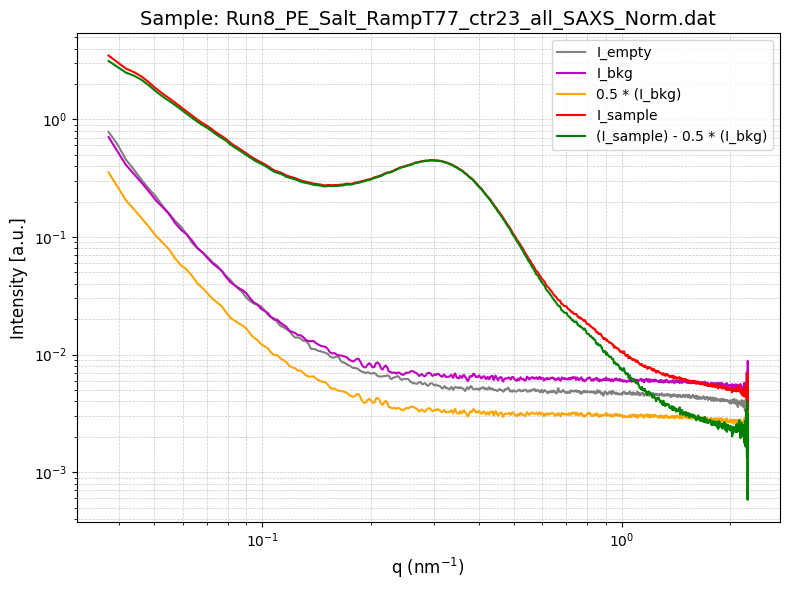

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT77_ctr23_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT80_ctr24_all_SAXS_Norm.dat
Background: Run14_Salt_RampT80_ctr24_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT80_ctr24_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182430.94333333333, bstop=4.767316666666667, ctemp=82.09215033333334, I0=20.807506666666665
Metadata parsed successfully: Timer=234014.33333333334, bstop=4.293216666666667, ctemp=81.98603066666665, I0=20.960873333333335
Metadata parsed successfully: Timer=100723.53333333333, bstop=5.823603333333334, ctemp=82.194275, I0=20.7305
0.5


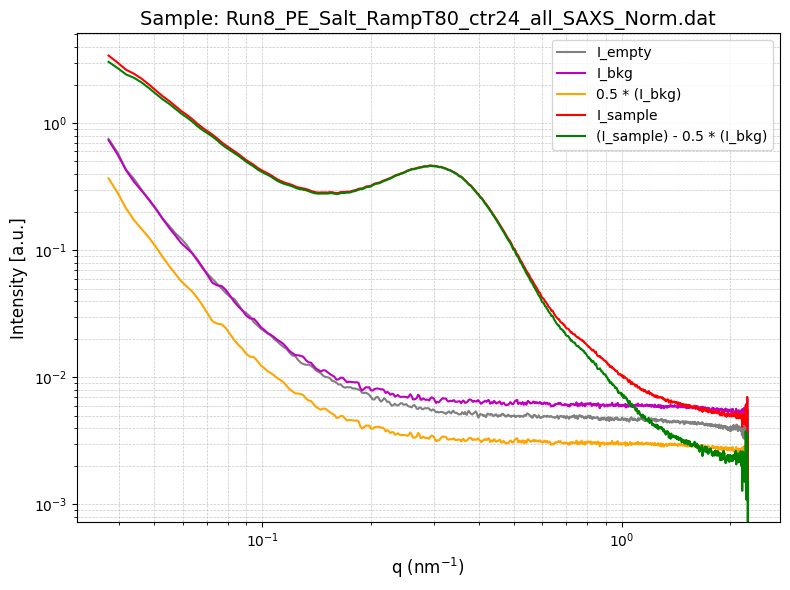

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT80_ctr24_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT82_ctr25_all_SAXS_Norm.dat
Background: Run14_Salt_RampT82_ctr25_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT82_ctr25_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182516.55000000002, bstop=4.754133333333333, ctemp=84.52248133333335, I0=20.696056666666667
Metadata parsed successfully: Timer=234100.35, bstop=4.281076666666666, ctemp=84.412051, I0=20.877683333333334
Metadata parsed successfully: Timer=100801.18333333333, bstop=5.876296666666668, ctemp=84.57542933333333, I0=20.97469
0.5


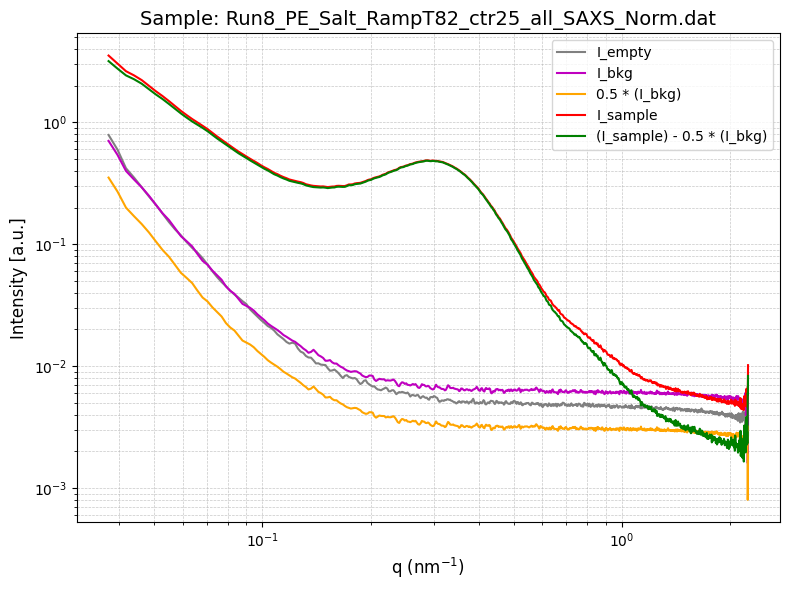

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT82_ctr25_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT85_ctr26_all_SAXS_Norm.dat
Background: Run14_Salt_RampT85_ctr26_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT85_ctr26_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182603.82666666666, bstop=4.736093333333334, ctemp=86.91256700000001, I0=20.592646666666667
Metadata parsed successfully: Timer=234187.31666666665, bstop=4.271233333333333, ctemp=86.80106333333333, I0=20.77370333333333
Metadata parsed successfully: Timer=100880.16333333333, bstop=5.859466666666666, ctemp=86.99566666666668, I0=20.870060000000002
0.5


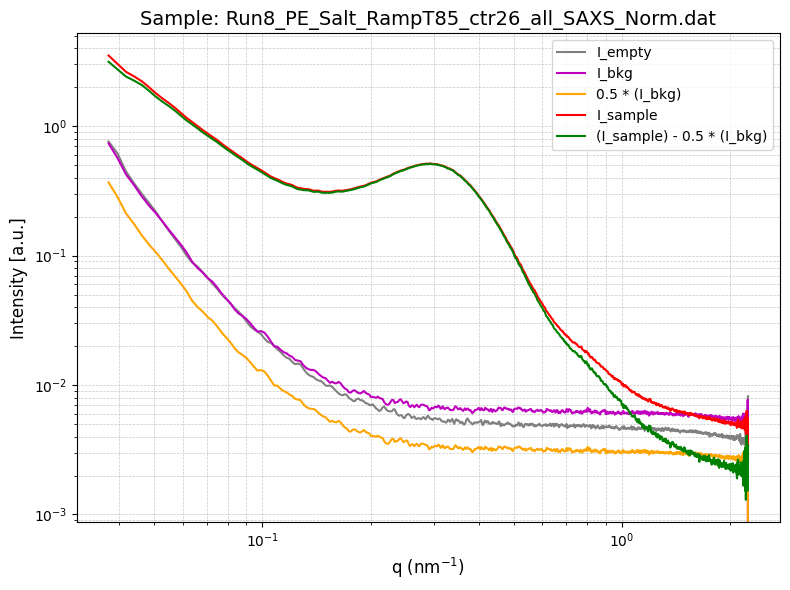

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT85_ctr26_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT87_ctr27_all_SAXS_Norm.dat
Background: Run14_Salt_RampT87_ctr27_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT87_ctr27_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182692.61333333337, bstop=4.75943, ctemp=89.32763933333332, I0=20.72781
Metadata parsed successfully: Timer=234276.49666666667, bstop=4.273476666666666, ctemp=89.24763733333333, I0=20.797063333333334
Metadata parsed successfully: Timer=100959.16666666667, bstop=5.842089999999999, ctemp=89.40471633333334, I0=20.765863333333332
0.5


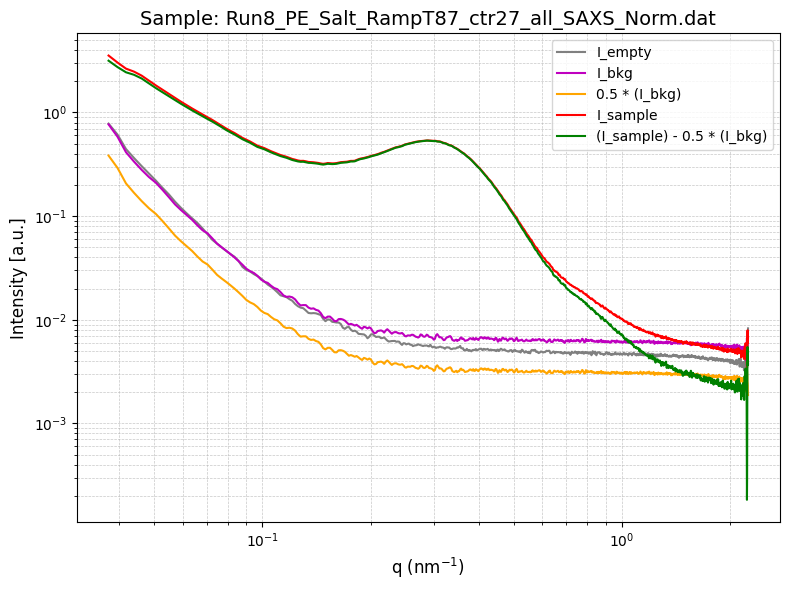

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT87_ctr27_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT90_ctr28_all_SAXS_Norm.dat
Background: Run14_Salt_RampT90_ctr28_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT90_ctr28_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182782.92333333334, bstop=4.76652, ctemp=91.72427366666666, I0=20.742733333333334
Metadata parsed successfully: Timer=234368.25333333333, bstop=4.300106666666667, ctemp=91.60369866666667, I0=20.860863333333334
Metadata parsed successfully: Timer=101039.35000000002, bstop=5.823316666666667, ctemp=91.78409066666667, I0=20.700313333333334
0.5


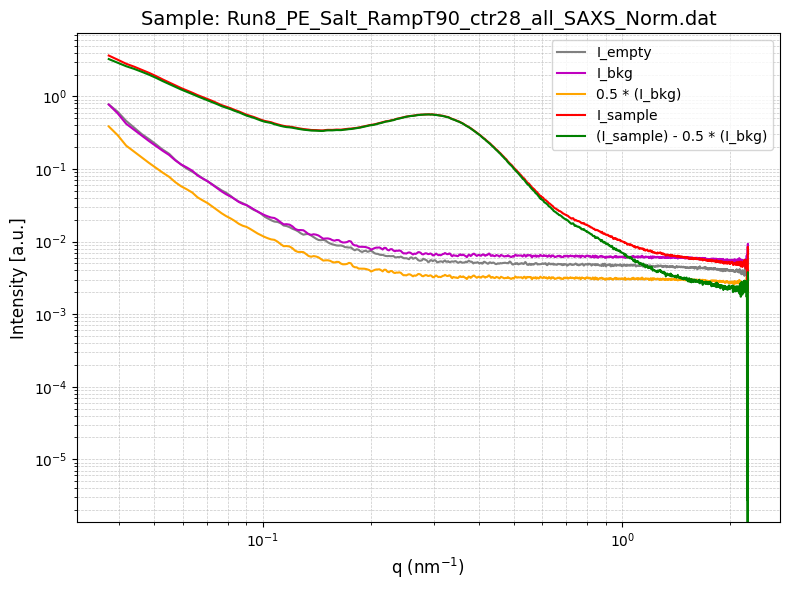

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT90_ctr28_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT92_ctr29_all_SAXS_Norm.dat
Background: Run14_Salt_RampT92_ctr29_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT92_ctr29_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182874.03333333335, bstop=4.756443333333333, ctemp=94.11374133333334, I0=20.643243333333334
Metadata parsed successfully: Timer=234461.33666666667, bstop=4.284916666666667, ctemp=94.007141, I0=20.805766666666667
Metadata parsed successfully: Timer=101120.76000000001, bstop=5.879203333333334, ctemp=94.163137, I0=20.88855
0.5


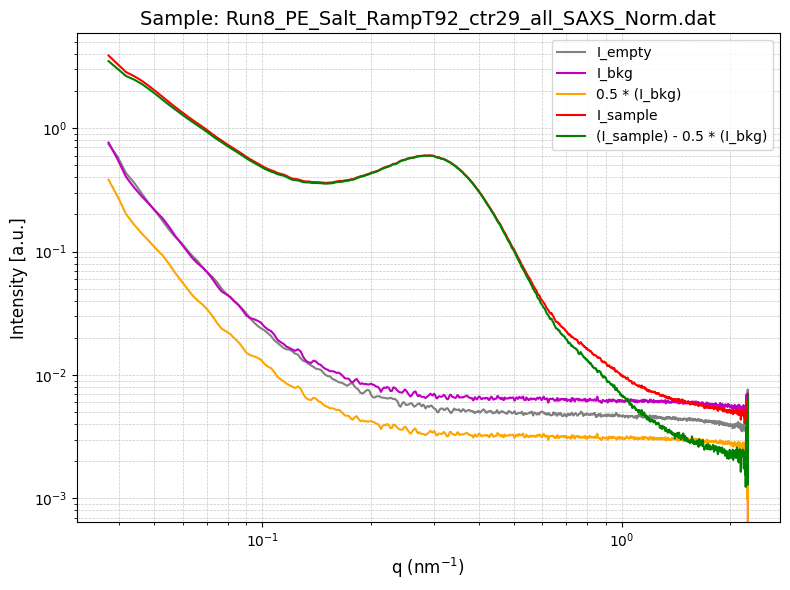

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT92_ctr29_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT95_ctr30_all_SAXS_Norm.dat
Background: Run14_Salt_RampT95_ctr30_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT95_ctr30_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=182965.88, bstop=4.74429, ctemp=96.54251833333335, I0=20.544960000000003
Metadata parsed successfully: Timer=234554.34333333335, bstop=4.27601, ctemp=96.43962633333332, I0=20.698603333333335
Metadata parsed successfully: Timer=101202.0, bstop=5.862333333333333, ctemp=96.58378066666667, I0=20.809070000000002
0.5


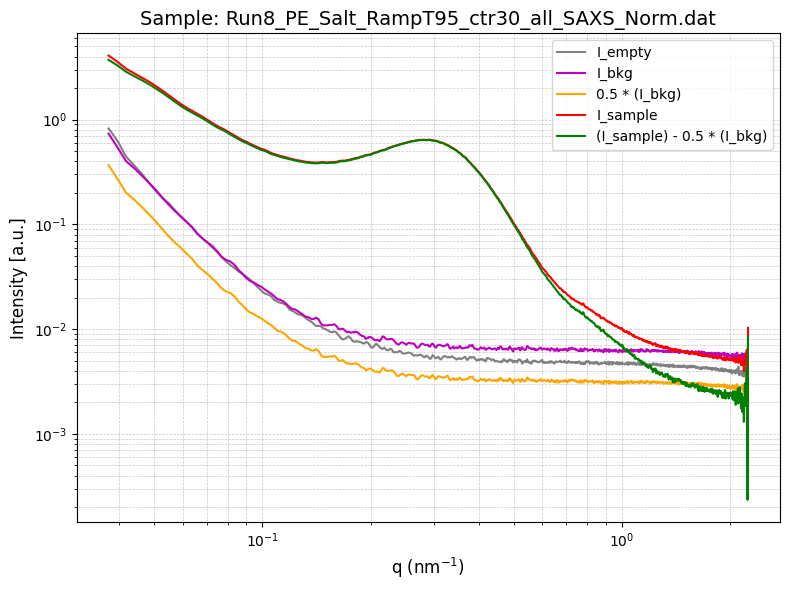

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT95_ctr30_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT97_ctr31_all_SAXS_Norm.dat
Background: Run14_Salt_RampT97_ctr31_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT97_ctr31_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183059.17333333334, bstop=4.792723333333333, ctemp=98.90472900000002, I0=20.728256666666667
Metadata parsed successfully: Timer=234647.44000000003, bstop=4.310926666666667, ctemp=98.86279066666667, I0=20.900656666666666
Metadata parsed successfully: Timer=101284.55333333334, bstop=5.843393333333332, ctemp=98.96879833333334, I0=20.756583333333335
0.5


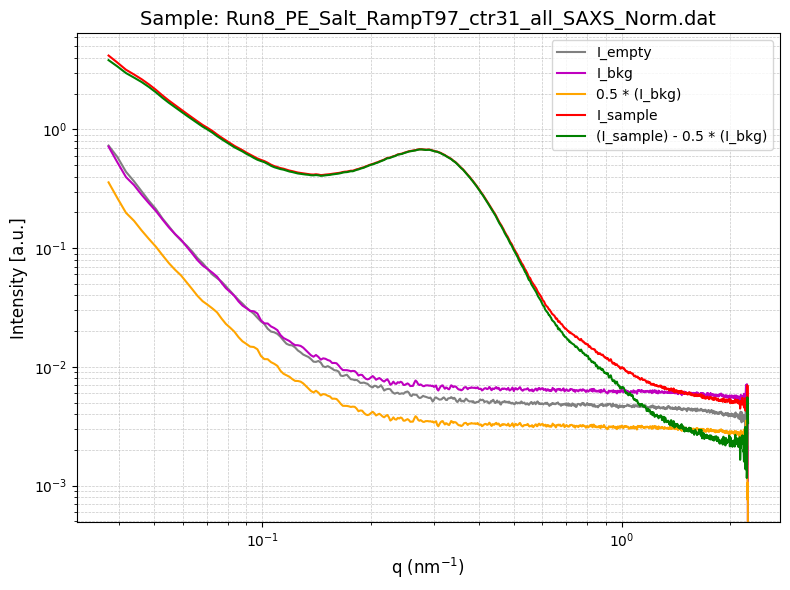

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT97_ctr31_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT100_ctr32_all_SAXS_Norm.dat
Background: Run14_Salt_RampT100_ctr32_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT100_ctr32_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183152.29333333333, bstop=4.77618, ctemp=101.30473333333333, I0=20.617993333333335
Metadata parsed successfully: Timer=234741.79666666666, bstop=4.299526666666667, ctemp=101.2233, I0=20.786640000000002
Metadata parsed successfully: Timer=101365.75333333334, bstop=5.818543333333333, ctemp=101.3848, I0=20.657466666666668
0.5


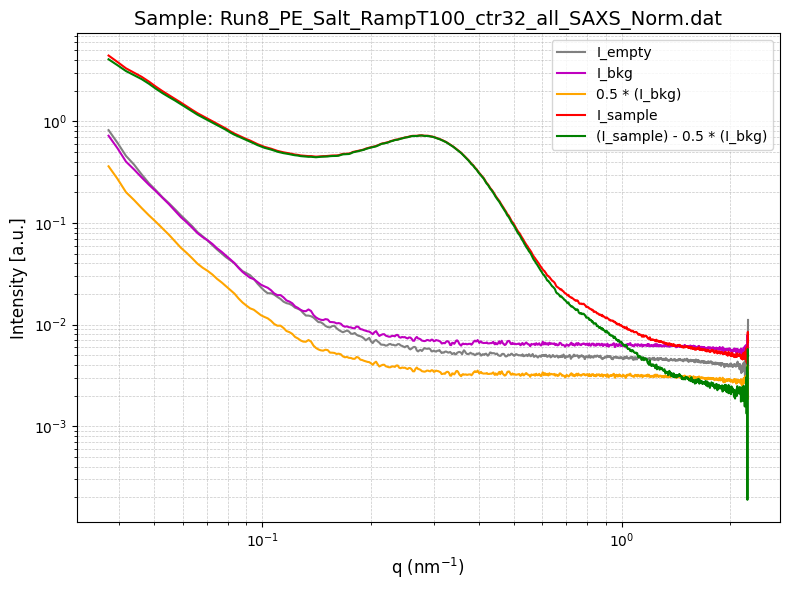

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT100_ctr32_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT102_ctr33_all_SAXS_Norm.dat
Background: Run14_Salt_RampT102_ctr33_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT102_ctr33_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183245.11, bstop=4.756936666666667, ctemp=103.73583333333333, I0=20.57265333333333
Metadata parsed successfully: Timer=234835.27000000002, bstop=4.284823333333333, ctemp=103.6248, I0=20.675463333333337
Metadata parsed successfully: Timer=101446.65666666666, bstop=5.87716, ctemp=103.7817, I0=20.85352333333333
0.5


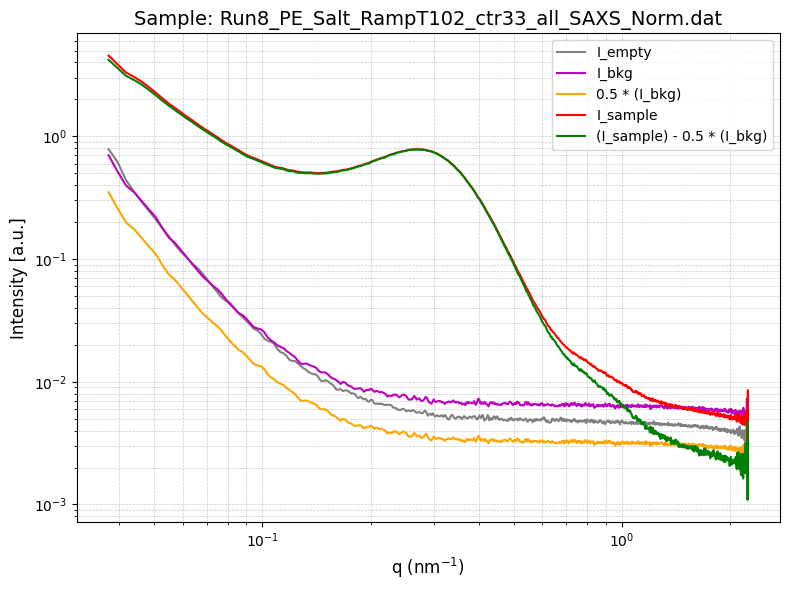

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT102_ctr33_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT105_ctr34_all_SAXS_Norm.dat
Background: Run14_Salt_RampT105_ctr34_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT105_ctr34_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183338.8633333333, bstop=4.804939999999999, ctemp=106.10936666666667, I0=20.770476666666667
Metadata parsed successfully: Timer=234929.54, bstop=4.3229766666666665, ctemp=106.01943333333334, I0=20.894936666666666
Metadata parsed successfully: Timer=101527.97666666668, bstop=5.85748, ctemp=106.1372, I0=20.799333333333333
0.5


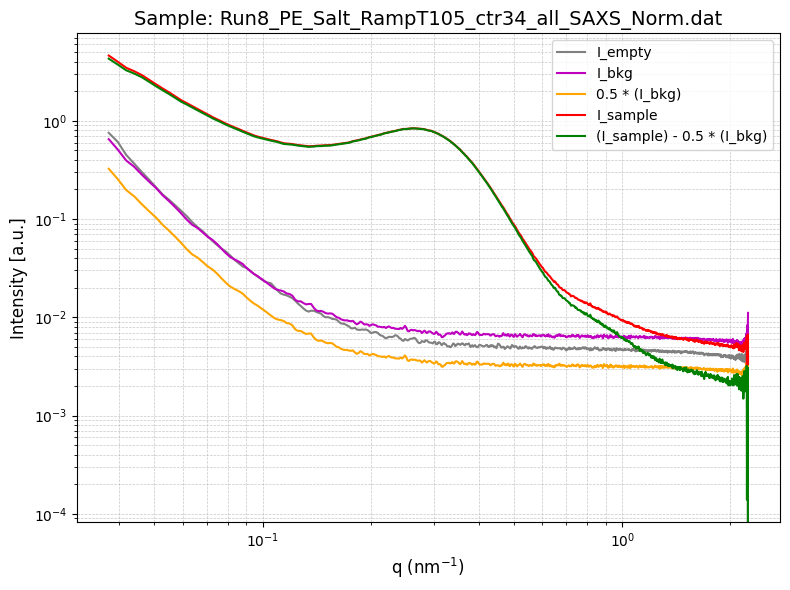

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT105_ctr34_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT107_ctr35_all_SAXS_Norm.dat
Background: Run14_Salt_RampT107_ctr35_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT107_ctr35_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183431.8866666667, bstop=4.780333333333334, ctemp=108.51453333333335, I0=20.639993333333333
Metadata parsed successfully: Timer=235022.91, bstop=4.3136399999999995, ctemp=108.45476666666667, I0=20.80241333333333
Metadata parsed successfully: Timer=101607.91333333333, bstop=5.835113333333333, ctemp=108.57373333333334, I0=20.70527
0.5


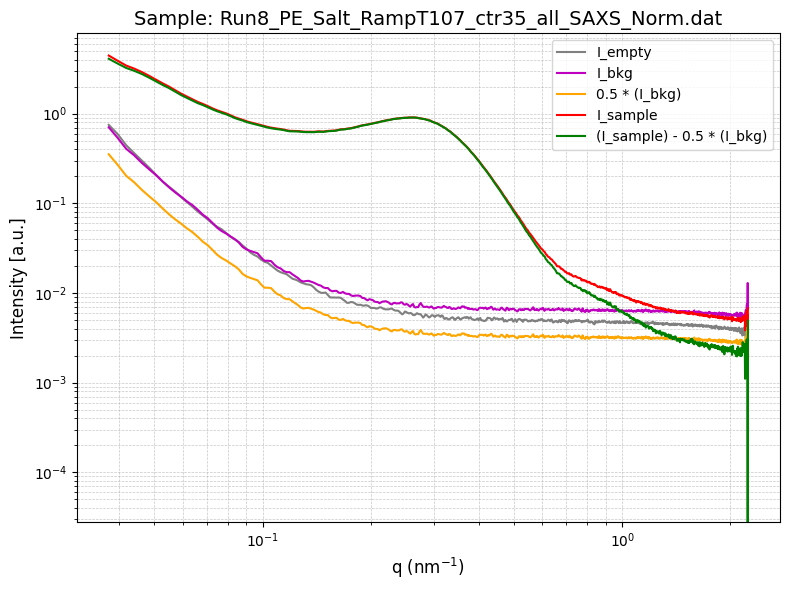

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT107_ctr35_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT110_ctr36_all_SAXS_Norm.dat
Background: Run14_Salt_RampT110_ctr36_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT110_ctr36_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183524.34, bstop=4.758523333333334, ctemp=110.92143333333335, I0=20.551703333333336
Metadata parsed successfully: Timer=235117.4833333333, bstop=4.296436666666667, ctemp=110.843, I0=20.7178
Metadata parsed successfully: Timer=101686.15333333332, bstop=5.87229, ctemp=111.01943333333334, I0=20.828453333333332
0.5


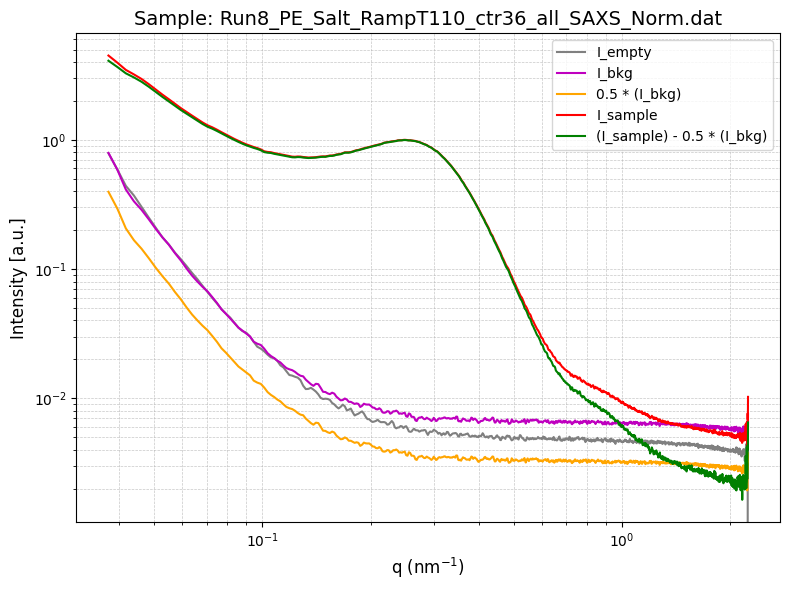

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT110_ctr36_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT112_ctr37_all_SAXS_Norm.dat
Background: Run14_Salt_RampT112_ctr37_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT112_ctr37_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183617.80999999997, bstop=4.7871966666666665, ctemp=113.33846666666666, I0=20.783936666666666
Metadata parsed successfully: Timer=235210.82333333333, bstop=4.3435999999999995, ctemp=113.27293333333334, I0=20.918836666666667
Metadata parsed successfully: Timer=101765.72333333333, bstop=5.87947, ctemp=113.41543333333334, I0=20.846613333333334
0.5


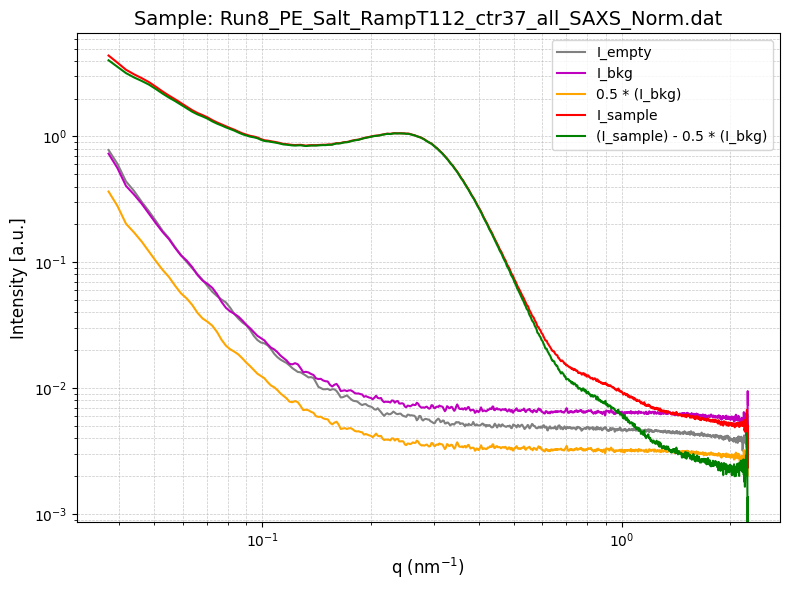

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT112_ctr37_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT115_ctr38_all_SAXS_Norm.dat
Background: Run14_Salt_RampT115_ctr38_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT115_ctr38_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183712.02333333332, bstop=4.770983333333334, ctemp=115.66399999999999, I0=20.622429999999998
Metadata parsed successfully: Timer=235304.83333333334, bstop=4.326630000000001, ctemp=115.66489999999999, I0=20.808609999999998
Metadata parsed successfully: Timer=101844.71666666666, bstop=5.8613333333333335, ctemp=115.7777, I0=20.761313333333334
0.5


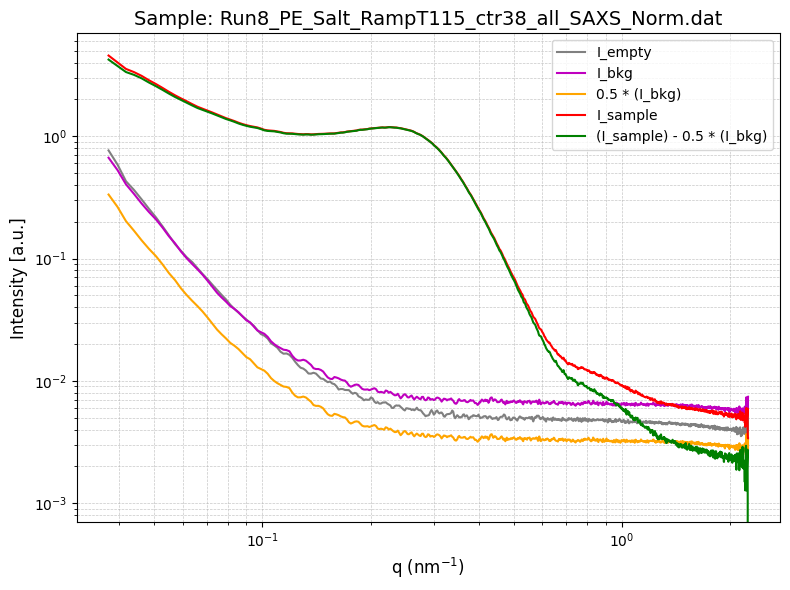

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT115_ctr38_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT117_ctr39_all_SAXS_Norm.dat
Background: Run14_Salt_RampT117_ctr39_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT117_ctr39_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183804.63333333333, bstop=4.747326666666667, ctemp=118.10236666666667, I0=20.55863
Metadata parsed successfully: Timer=235398.29333333333, bstop=4.31677, ctemp=118.13496666666667, I0=20.714996666666664
Metadata parsed successfully: Timer=101921.36333333334, bstop=5.838793333333332, ctemp=118.22833333333334, I0=20.67021
0.5


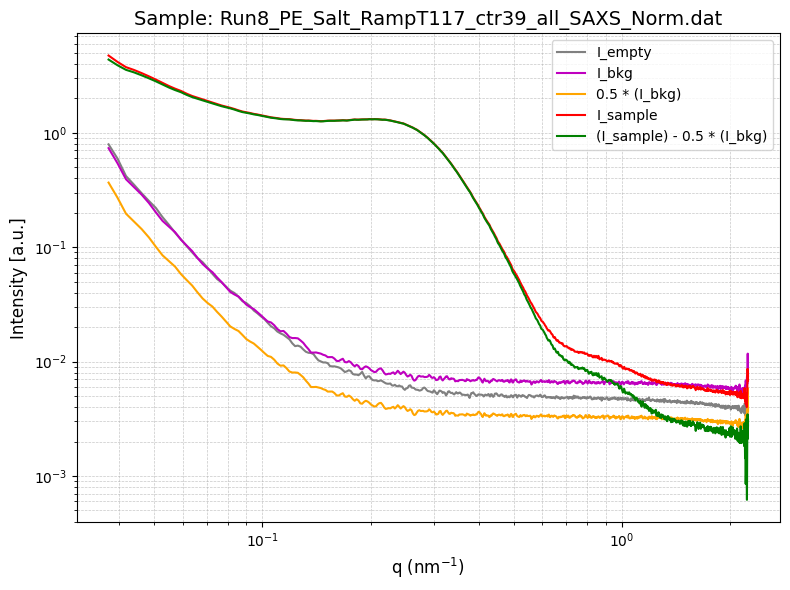

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT117_ctr39_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT120_ctr40_all_SAXS_Norm.dat
Background: Run14_Salt_RampT120_ctr40_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT120_ctr40_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183897.93333333335, bstop=4.77681, ctemp=120.5224, I0=20.725943333333333
Metadata parsed successfully: Timer=235492.83666666667, bstop=4.308696666666666, ctemp=120.53913333333333, I0=20.629423333333335
Metadata parsed successfully: Timer=101997.87333333334, bstop=5.894159999999999, ctemp=120.70866666666666, I0=20.884656666666668
0.5


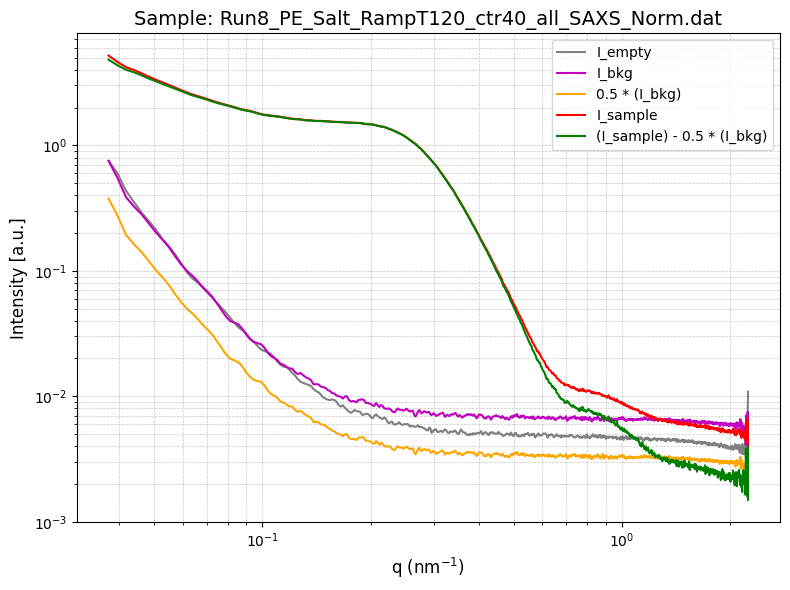

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT120_ctr40_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT122_ctr41_all_SAXS_Norm.dat
Background: Run14_Salt_RampT122_ctr41_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT122_ctr41_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=183992.59666666668, bstop=4.756029999999999, ctemp=122.89663333333333, I0=20.6503
Metadata parsed successfully: Timer=235588.99666666667, bstop=4.29896, ctemp=122.87766666666666, I0=20.55781
Metadata parsed successfully: Timer=102077.51666666666, bstop=5.88088, ctemp=122.96679999999999, I0=20.854836666666667
0.5


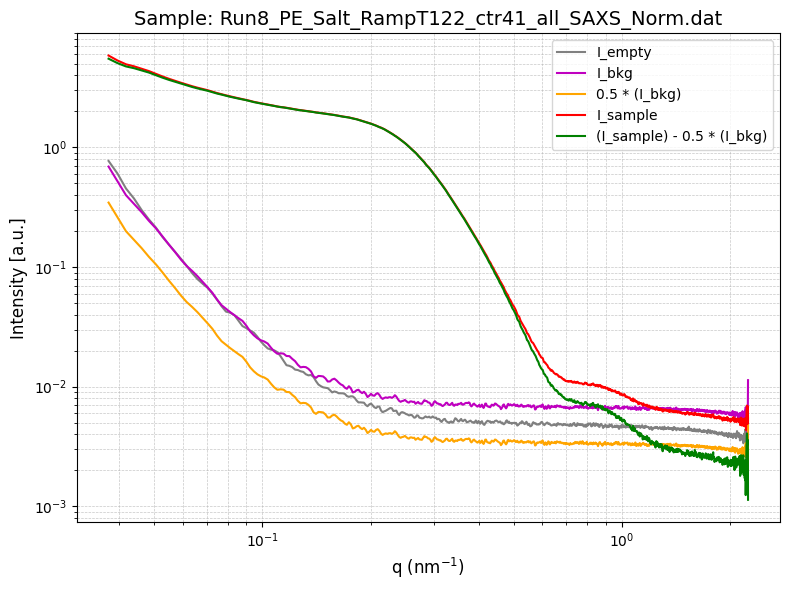

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT122_ctr41_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT125_ctr42_all_SAXS_Norm.dat
Background: Run14_Salt_RampT125_ctr42_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT125_ctr42_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184087.65, bstop=4.733086666666666, ctemp=125.2728, I0=20.572893333333333
Metadata parsed successfully: Timer=235683.70333333334, bstop=4.28034, ctemp=125.37836666666668, I0=20.483430000000002
Metadata parsed successfully: Timer=102152.88333333335, bstop=5.861236666666667, ctemp=125.50953333333332, I0=20.75476
0.5


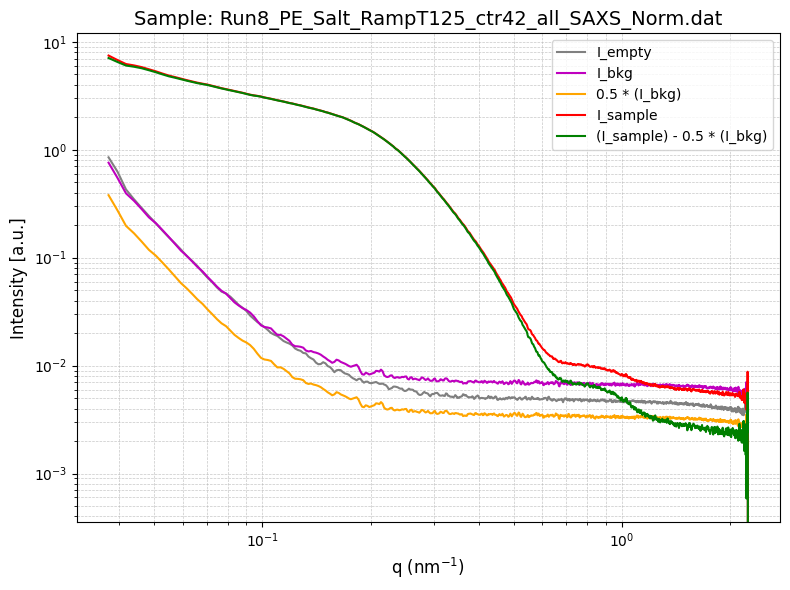

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT125_ctr42_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT127_ctr43_all_SAXS_Norm.dat
Background: Run14_Salt_RampT127_ctr43_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT127_ctr43_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184182.62666666668, bstop=4.744236666666667, ctemp=127.7085, I0=20.576539999999998
Metadata parsed successfully: Timer=235780.42666666667, bstop=4.296003333333334, ctemp=127.76006666666666, I0=20.505570000000002
Metadata parsed successfully: Timer=102230.46666666667, bstop=5.84212, ctemp=127.87820333333332, I0=20.640953333333332
0.5


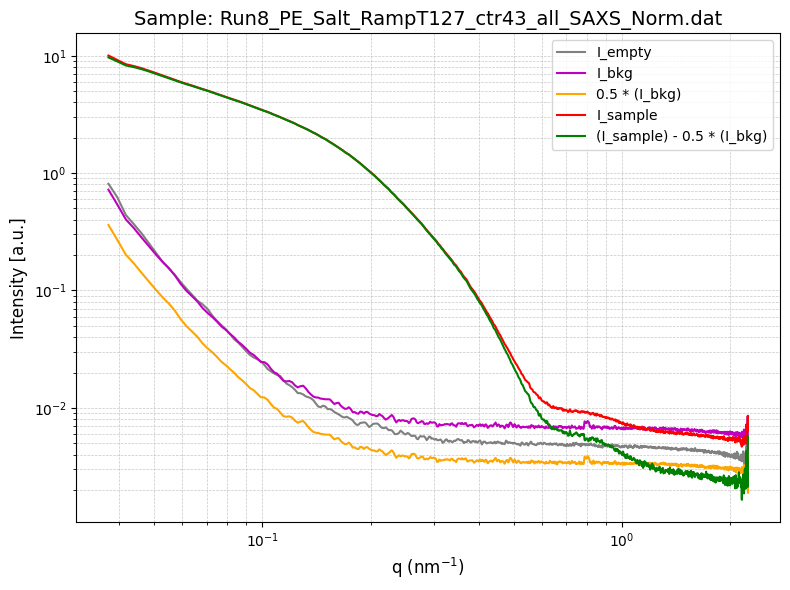

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT127_ctr43_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT130_ctr44_all_SAXS_Norm.dat
Background: Run14_Salt_RampT130_ctr44_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT130_ctr44_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184278.6066666667, bstop=4.776023333333334, ctemp=130.11724, I0=20.645936666666667
Metadata parsed successfully: Timer=235878.4, bstop=4.3559833333333335, ctemp=130.1347, I0=20.861353333333334
Metadata parsed successfully: Timer=102307.45666666667, bstop=5.910903333333334, ctemp=130.27946666666665, I0=20.89997333333333
0.5


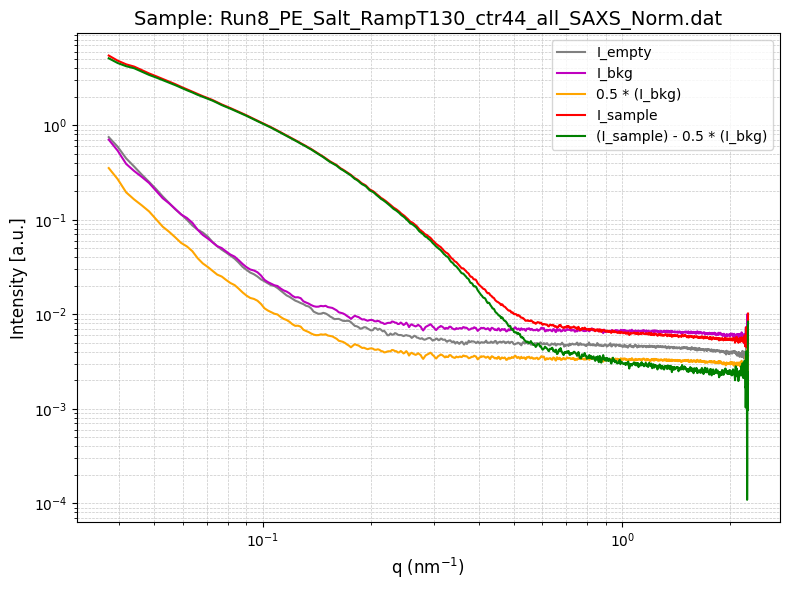

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT130_ctr44_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT132_ctr45_all_SAXS_Norm.dat
Background: Run14_Salt_RampT132_ctr45_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT132_ctr45_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184374.99333333332, bstop=4.756293333333333, ctemp=132.59307, I0=20.55224
Metadata parsed successfully: Timer=235977.42666666667, bstop=4.3404533333333335, ctemp=132.51556, I0=20.74536
Metadata parsed successfully: Timer=102384.39, bstop=5.887523333333334, ctemp=132.65090333333333, I0=20.81502
0.5


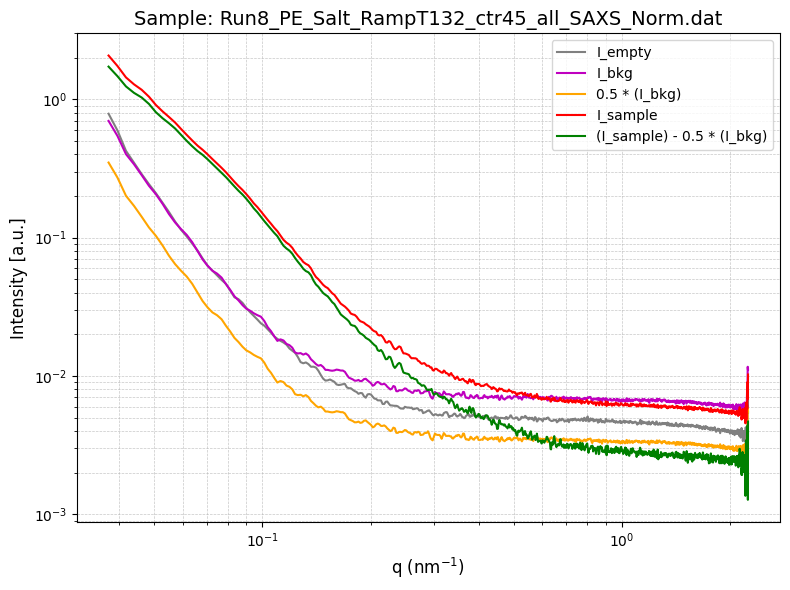

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT132_ctr45_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT135_ctr46_all_SAXS_Norm.dat
Background: Run14_Salt_RampT135_ctr46_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT135_ctr46_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184474.33, bstop=4.743703333333333, ctemp=134.92373666666666, I0=20.508996666666665
Metadata parsed successfully: Timer=236075.75, bstop=4.347956666666667, ctemp=135.03686666666667, I0=20.72923
Metadata parsed successfully: Timer=102460.00333333334, bstop=5.866363333333333, ctemp=135.16080333333332, I0=20.70958
0.5


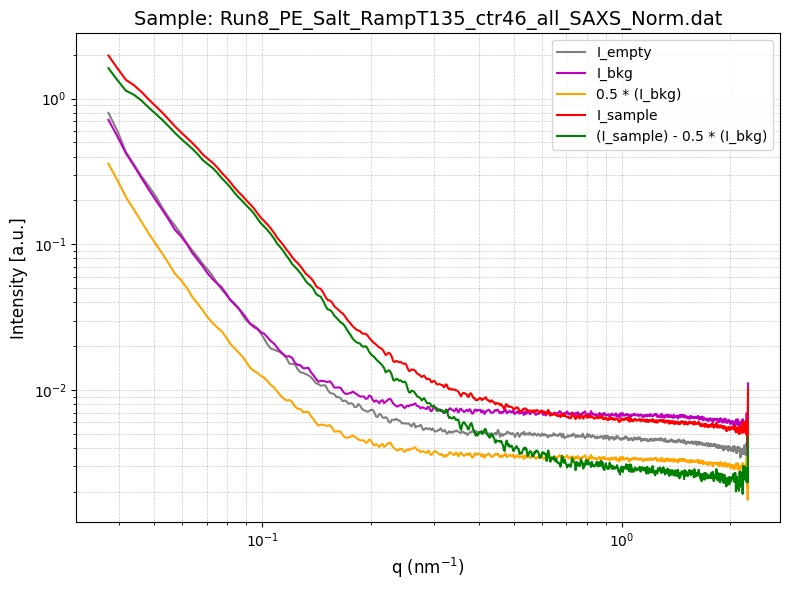

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT135_ctr46_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT137_ctr47_all_SAXS_Norm.dat
Background: Run14_Salt_RampT137_ctr47_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT137_ctr47_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184572.02333333332, bstop=4.773219999999999, ctemp=137.50499666666667, I0=20.642413333333334
Metadata parsed successfully: Timer=236208.6433333333, bstop=4.362496666666666, ctemp=136.11563, I0=20.74663
Metadata parsed successfully: Timer=102539.01333333332, bstop=5.84506, ctemp=137.52160333333333, I0=20.62396
0.5


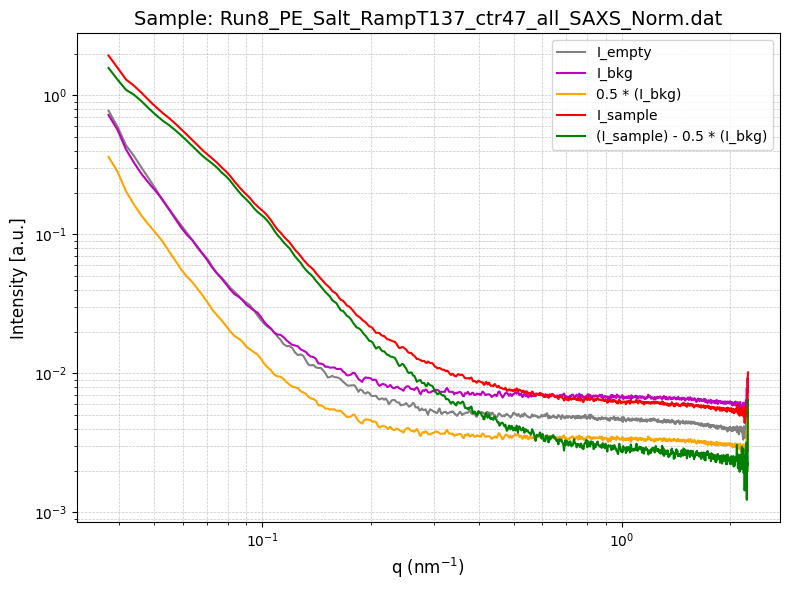

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT137_ctr47_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT140_ctr48_all_SAXS_Norm.dat
Background: Run14_Salt_RampT140_ctr48_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT140_ctr48_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184676.07333333333, bstop=4.754576666666666, ctemp=139.69936666666666, I0=20.519343333333335
Metadata parsed successfully: Timer=236282.72, bstop=4.35202, ctemp=139.8475, I0=20.694836666666664
Metadata parsed successfully: Timer=102616.71, bstop=5.910679999999999, ctemp=139.96979666666667, I0=20.85699
0.5


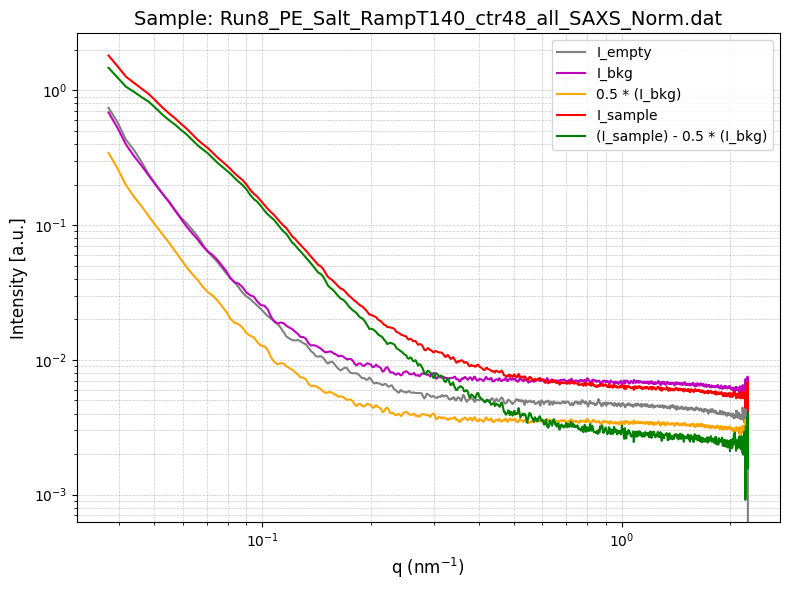

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT140_ctr48_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT142_ctr49_all_SAXS_Norm.dat
Background: Run14_Salt_RampT142_ctr49_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT142_ctr49_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184777.05333333332, bstop=4.7593966666666665, ctemp=142.27057000000002, I0=20.496806666666668
Metadata parsed successfully: Timer=236384.56666666665, bstop=4.369783333333333, ctemp=142.41503, I0=20.732380000000003
Metadata parsed successfully: Timer=102694.35999999999, bstop=5.888343333333334, ctemp=142.41393000000002, I0=20.762629999999998
0.5


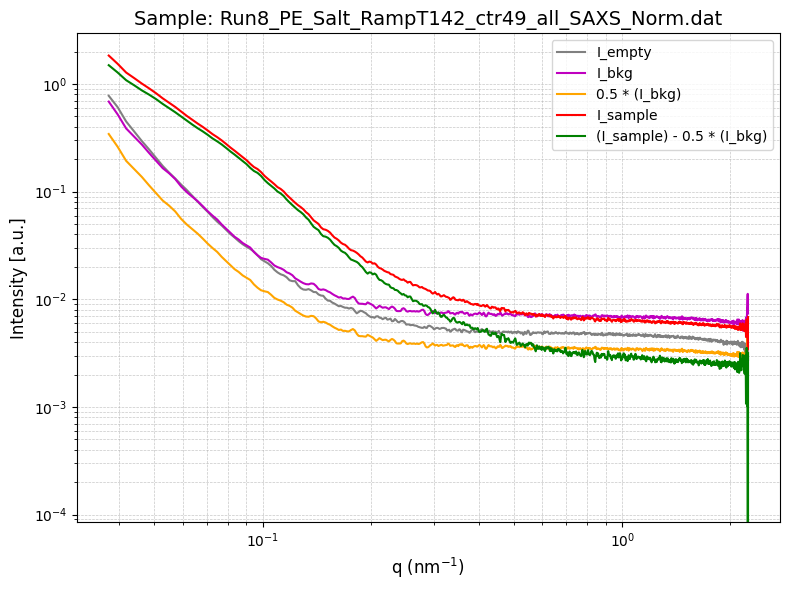

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT142_ctr49_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT145_ctr50_all_SAXS_Norm.dat
Background: Run14_Salt_RampT145_ctr50_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT145_ctr50_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184884.08333333334, bstop=4.787109999999999, ctemp=144.52982999999998, I0=20.631236666666666
Metadata parsed successfully: Timer=236492.02, bstop=4.374739999999999, ctemp=144.79187000000002, I0=20.75709
Metadata parsed successfully: Timer=102773.23333333334, bstop=5.869, ctemp=144.77586666666664, I0=20.680526666666665
0.5


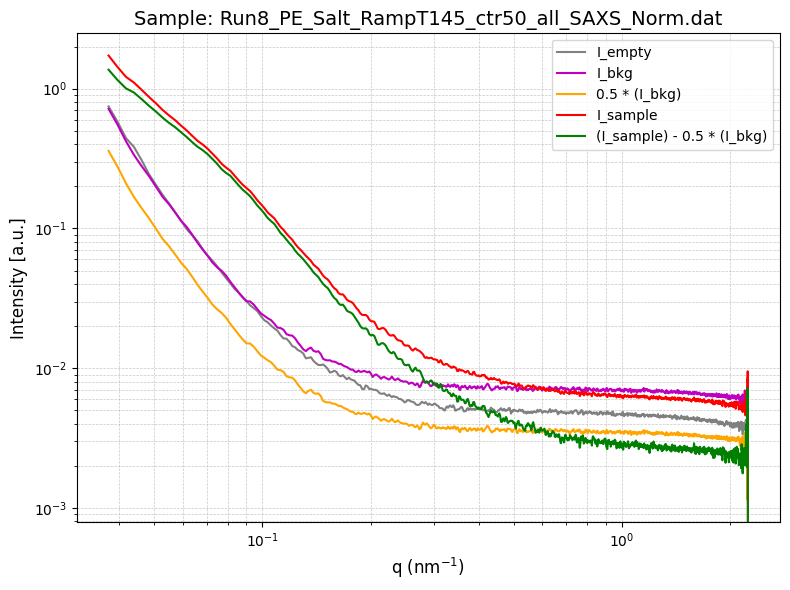

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT145_ctr50_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT147_ctr51_all_SAXS_Norm.dat
Background: Run14_Salt_RampT147_ctr51_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT147_ctr51_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=184987.80333333334, bstop=4.76737, ctemp=147.16616666666667, I0=20.506003333333336
Metadata parsed successfully: Timer=236601.00333333333, bstop=4.360373333333333, ctemp=147.16593, I0=20.615956666666666
Metadata parsed successfully: Timer=102851.96666666667, bstop=5.846633333333334, ctemp=147.21906333333334, I0=20.58438333333333
0.5


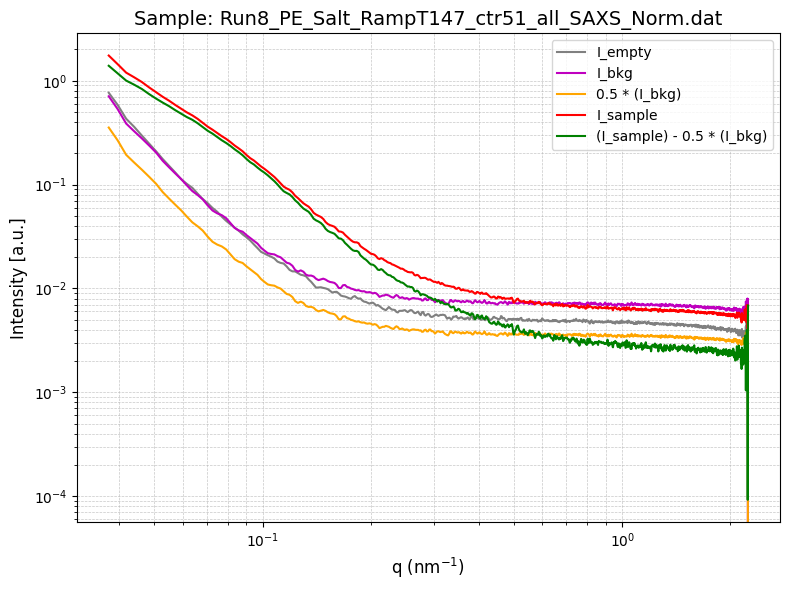

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT147_ctr51_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT150_ctr52_all_SAXS_Norm.dat
Background: Run14_Salt_RampT150_ctr52_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT150_ctr52_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=185098.49, bstop=4.803986666666667, ctemp=149.5234966666667, I0=20.657776666666663
Metadata parsed successfully: Timer=236712.72999999998, bstop=4.399346666666666, ctemp=149.5832, I0=20.783126666666664
Metadata parsed successfully: Timer=102930.88333333335, bstop=5.9028566666666675, ctemp=149.70884, I0=20.775716666666668
0.5


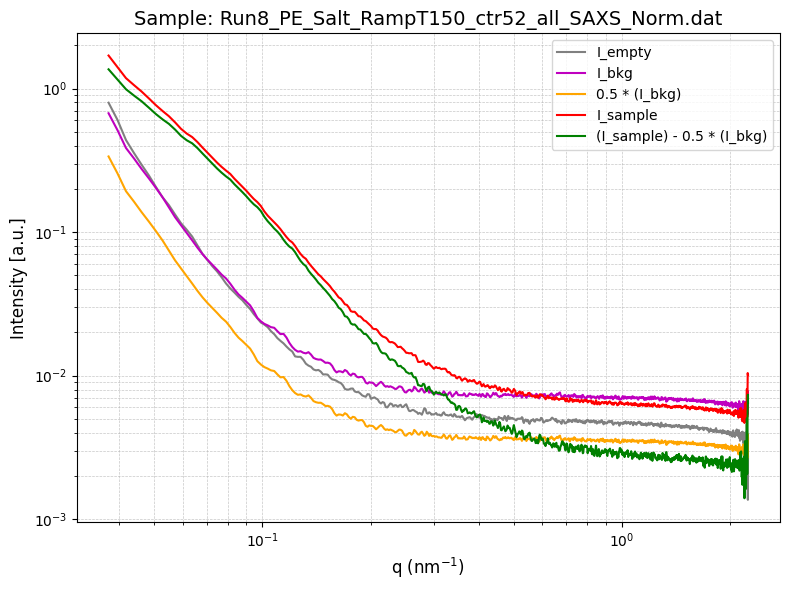

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT150_ctr52_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT152_ctr53_all_SAXS_Norm.dat
Background: Run14_Salt_RampT152_ctr53_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT152_ctr53_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=185209.68000000002, bstop=4.79098, ctemp=152.02039666666667, I0=20.557466666666667
Metadata parsed successfully: Timer=236825.69666666668, bstop=4.379270000000001, ctemp=152.09153333333333, I0=20.70889
Metadata parsed successfully: Timer=103010.74666666666, bstop=5.886886666666666, ctemp=152.16656333333333, I0=20.72554333333333
0.5


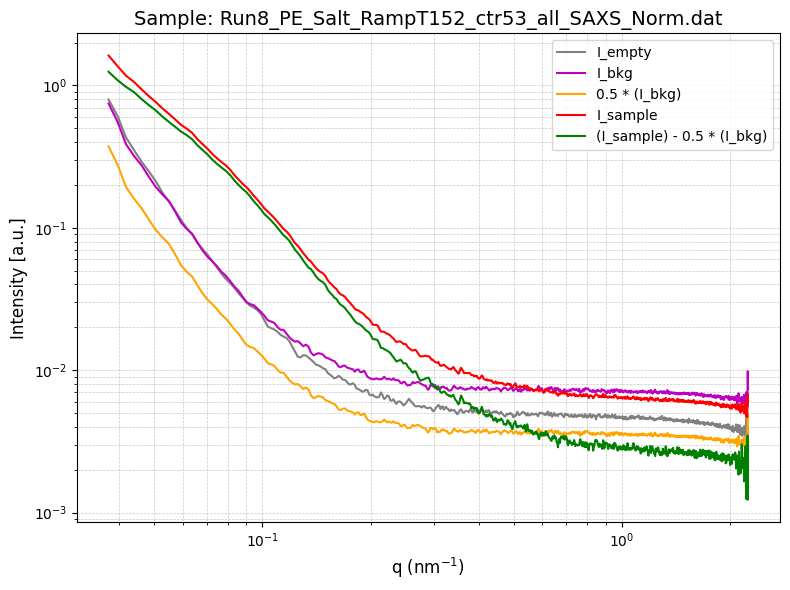

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT152_ctr53_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT155_ctr54_all_SAXS_Norm.dat
Background: Run14_Salt_RampT155_ctr54_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT155_ctr54_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=185324.71666666667, bstop=4.7776266666666665, ctemp=154.50823000000003, I0=20.44184333333333
Metadata parsed successfully: Timer=236941.88999999998, bstop=4.362753333333333, ctemp=154.55449333333334, I0=20.57885333333333
Metadata parsed successfully: Timer=103092.09999999999, bstop=5.863433333333333, ctemp=154.57296666666667, I0=20.659209999999998
0.5


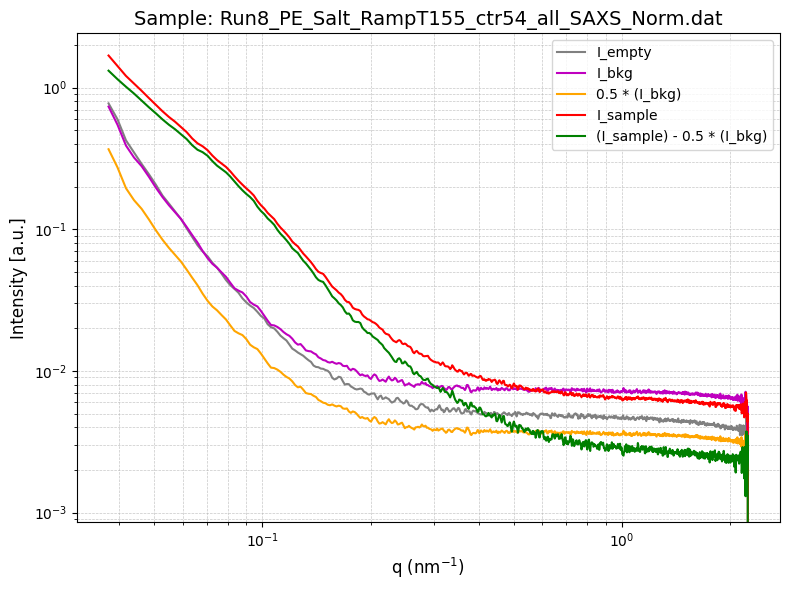

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT155_ctr54_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT157_ctr55_all_SAXS_Norm.dat
Background: Run14_Salt_RampT157_ctr55_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT157_ctr55_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=185441.85333333336, bstop=4.817723333333333, ctemp=157.03063666666665, I0=20.627446666666668
Metadata parsed successfully: Timer=237061.51, bstop=4.402163333333333, ctemp=157.06453333333334, I0=20.70726
Metadata parsed successfully: Timer=103174.56999999999, bstop=5.867896666666667, ctemp=156.98930333333334, I0=20.618550000000003
0.5


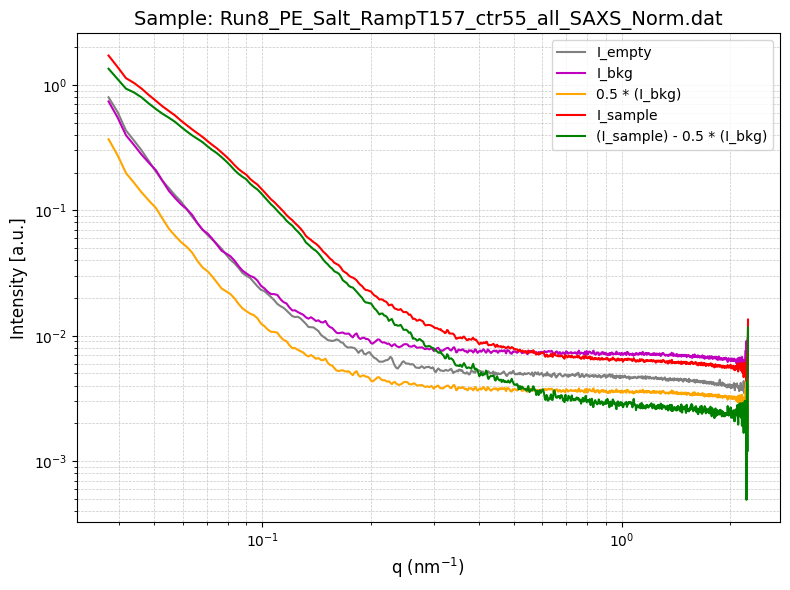

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT157_ctr55_all_SAXS_Norm_sub.dat
Sample: Run8_PE_Salt_RampT160_ctr56_all_SAXS_Norm.dat
Background: Run14_Salt_RampT160_ctr56_all_SAXS_Norm.dat
Empty: Run3_Empty_capi_RampT160_ctr56_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=185565.02000000002, bstop=4.797323333333333, ctemp=159.41039666666666, I0=20.501206666666665
Metadata parsed successfully: Timer=237186.95666666667, bstop=4.38464, ctemp=159.43430333333333, I0=20.60725
Metadata parsed successfully: Timer=103256.08333333333, bstop=5.905593333333333, ctemp=159.43426666666667, I0=20.784166666666668
0.5


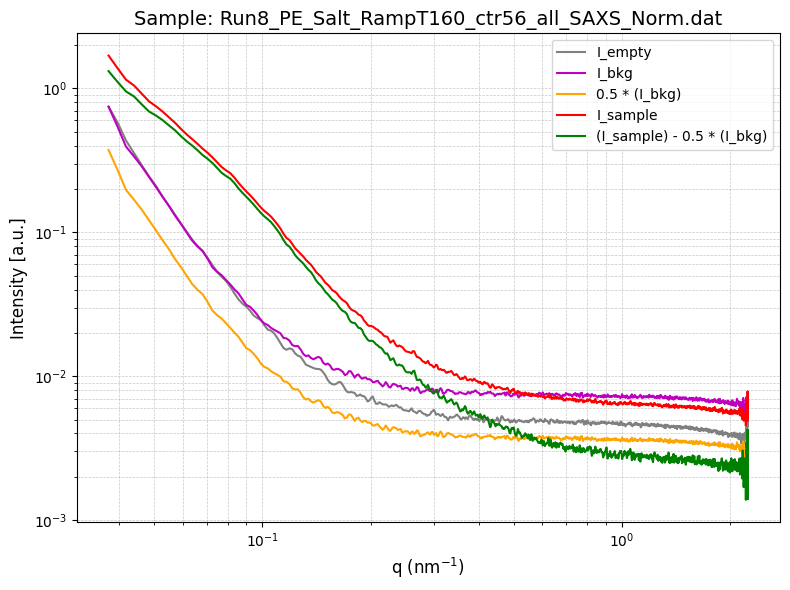

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run8_PE_Salt_RampT160_ctr56_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT20_ctr0_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT20_ctr0_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169619.49, bstop=6.112303333333333, ctemp=23.338906666666663, I0=20.976656666666667
Metadata parsed successfully: Timer=99307.11033333333, bstop=5.840843333333333, ctemp=34.443570666666666, I0=20.938636666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


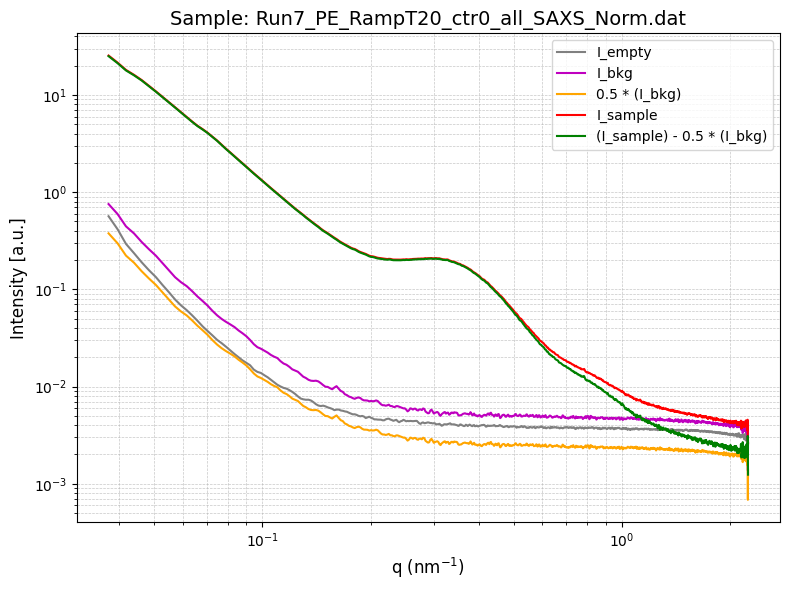

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT20_ctr0_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT22_ctr1_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT22_ctr1_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169664.5, bstop=6.105003333333333, ctemp=23.33892, I0=20.9714
Metadata parsed successfully: Timer=99365.84433333333, bstop=5.830806666666667, ctemp=33.97231933333333, I0=20.921406666666666
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


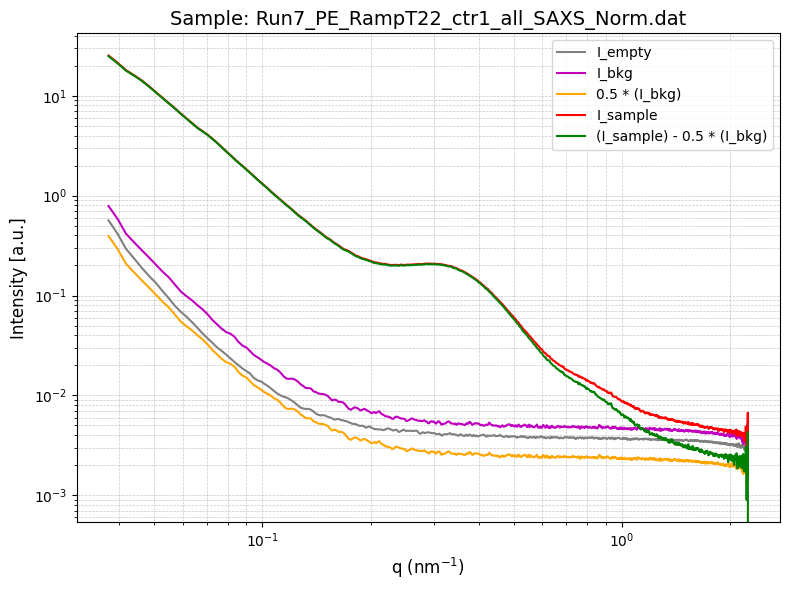

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT22_ctr1_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT25_ctr2_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT25_ctr2_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169740.65333333335, bstop=6.082703333333334, ctemp=28.724680000000003, I0=20.85784
Metadata parsed successfully: Timer=99423.16733333333, bstop=5.810923333333332, ctemp=33.551553, I0=20.893069999999998
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


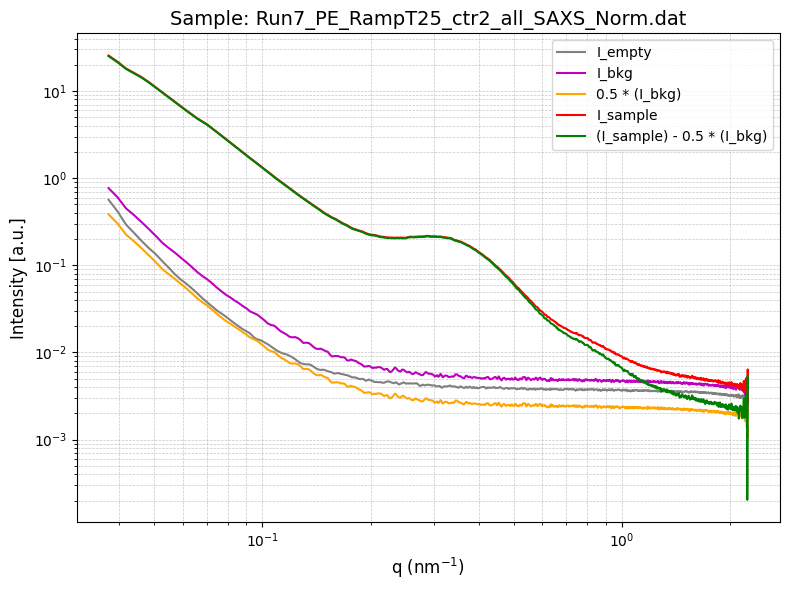

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT25_ctr2_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT27_ctr3_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT27_ctr3_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169785.9233333333, bstop=6.117249999999999, ctemp=29.292980333333333, I0=20.971663333333336
Metadata parsed successfully: Timer=99468.67166666668, bstop=5.799493333333333, ctemp=33.214679999999994, I0=20.83780333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


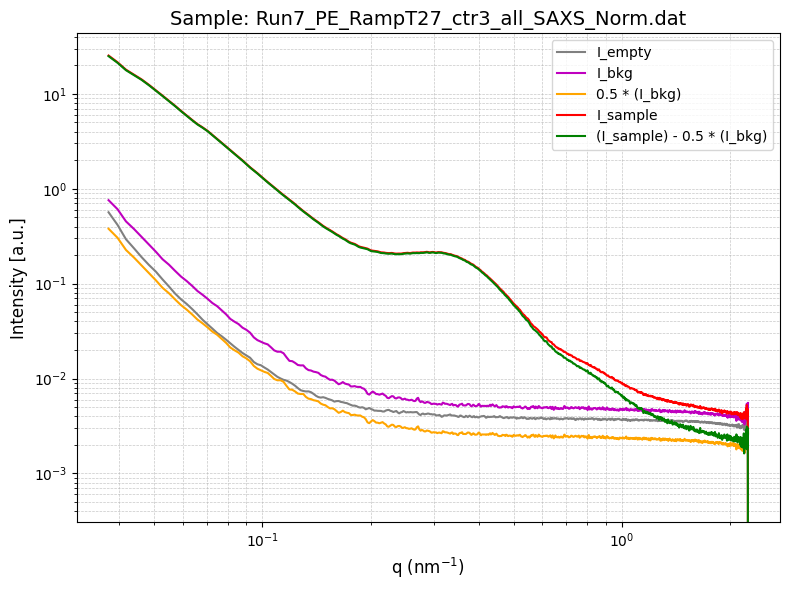

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT27_ctr3_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT30_ctr4_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT30_ctr4_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169857.6433333333, bstop=6.135423333333333, ctemp=33.402396, I0=21.03764
Metadata parsed successfully: Timer=99513.91933333332, bstop=5.787286666666667, ctemp=32.918487666666664, I0=20.73201
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


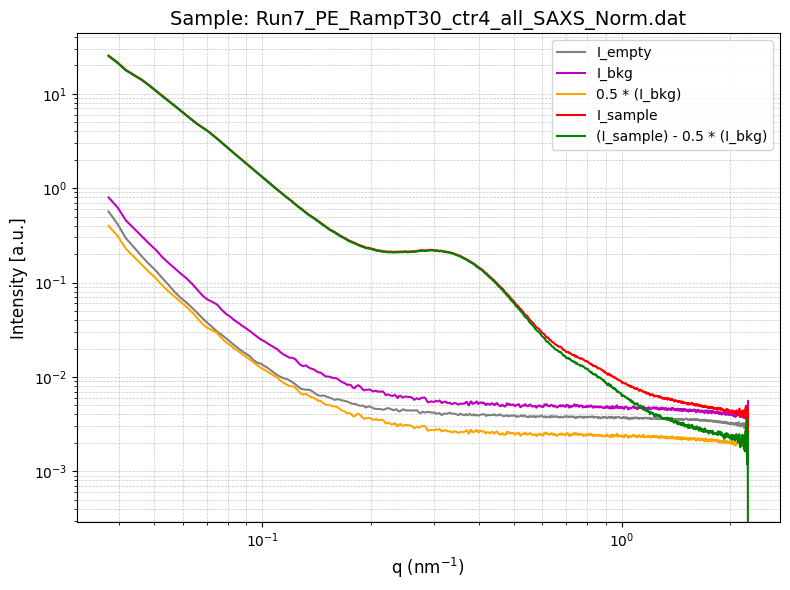

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT30_ctr4_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT32_ctr5_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT32_ctr5_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169902.64, bstop=6.122036666666666, ctemp=33.710713999999996, I0=21.00874333333333
Metadata parsed successfully: Timer=99559.58, bstop=5.78169, ctemp=32.600447333333335, I0=20.742136666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


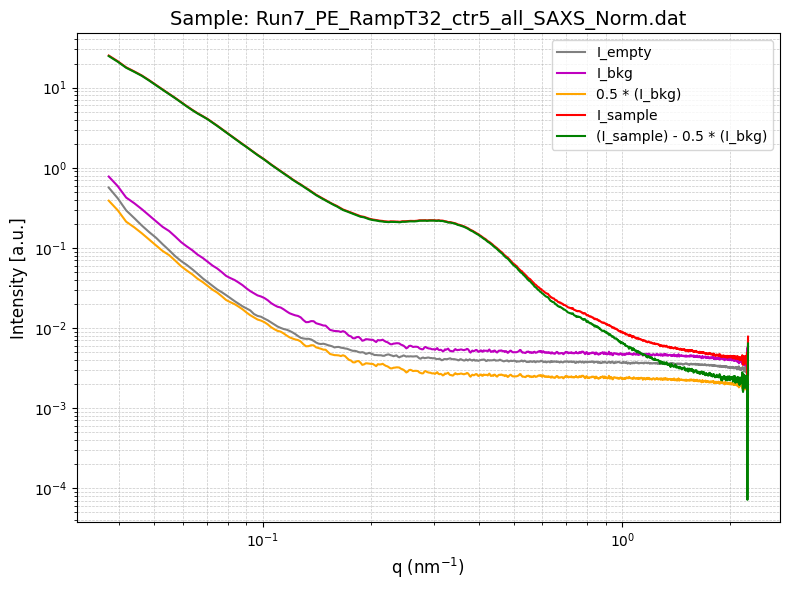

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT32_ctr5_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT35_ctr6_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT35_ctr6_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=169977.01, bstop=6.105323333333334, ctemp=38.40748333333334, I0=20.935386666666666
Metadata parsed successfully: Timer=99633.86133333335, bstop=5.838693333333334, ctemp=38.843533666666666, I0=20.93518
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


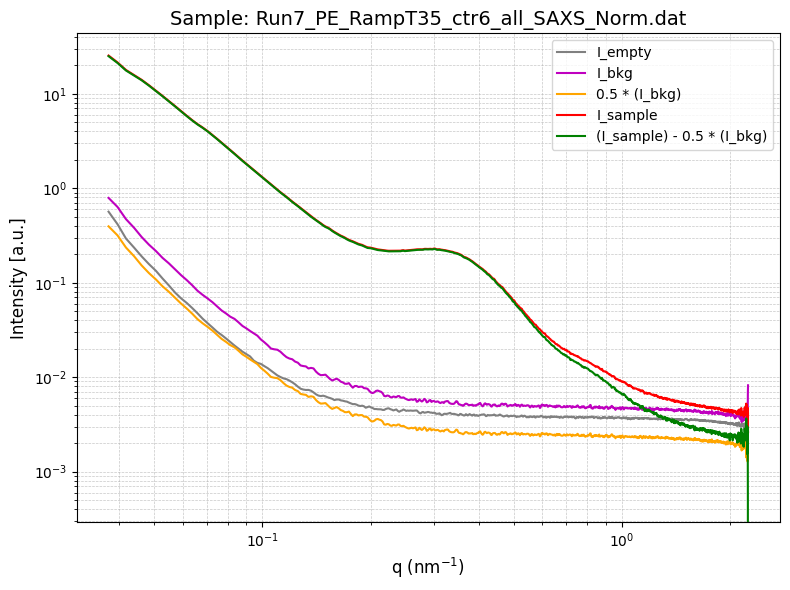

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT35_ctr6_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT37_ctr7_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT37_ctr7_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170022.05999999997, bstop=6.097713333333334, ctemp=38.28417833333333, I0=20.892516666666666
Metadata parsed successfully: Timer=99679.034, bstop=5.829153333333333, ctemp=38.72539266666667, I0=20.918186666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


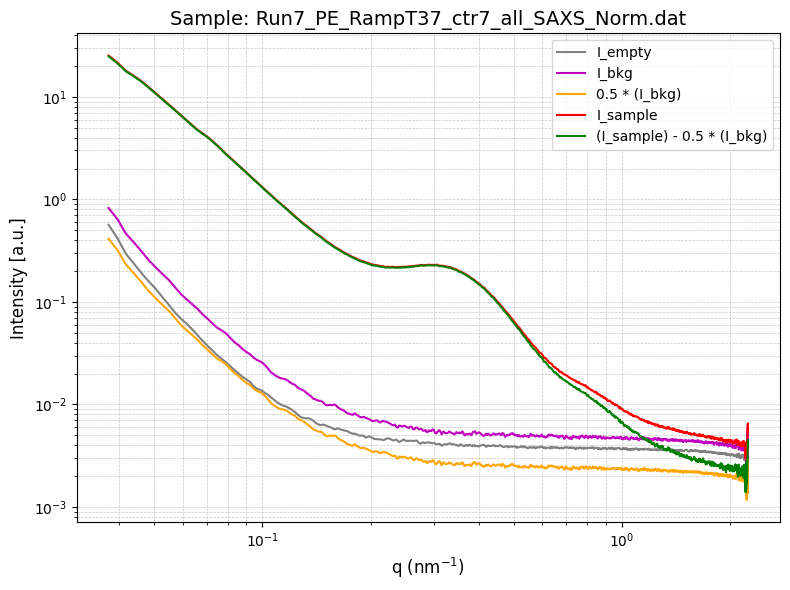

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT37_ctr7_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT40_ctr8_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT40_ctr8_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170104.51333333334, bstop=6.149440000000001, ctemp=43.30892933333334, I0=21.076883333333335
Metadata parsed successfully: Timer=99750.322, bstop=5.81963, ctemp=43.62077733333333, I0=20.877156666666664
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


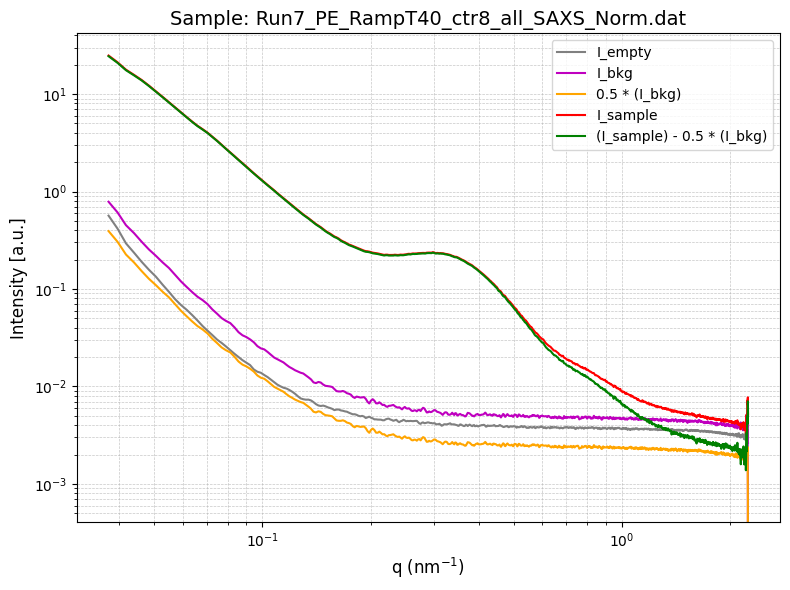

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT40_ctr8_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT42_ctr9_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT42_ctr9_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170148.93666666668, bstop=6.14104, ctemp=42.773029333333334, I0=21.052503333333334
Metadata parsed successfully: Timer=99795.70766666665, bstop=5.807546666666667, ctemp=43.147533333333335, I0=20.79771666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


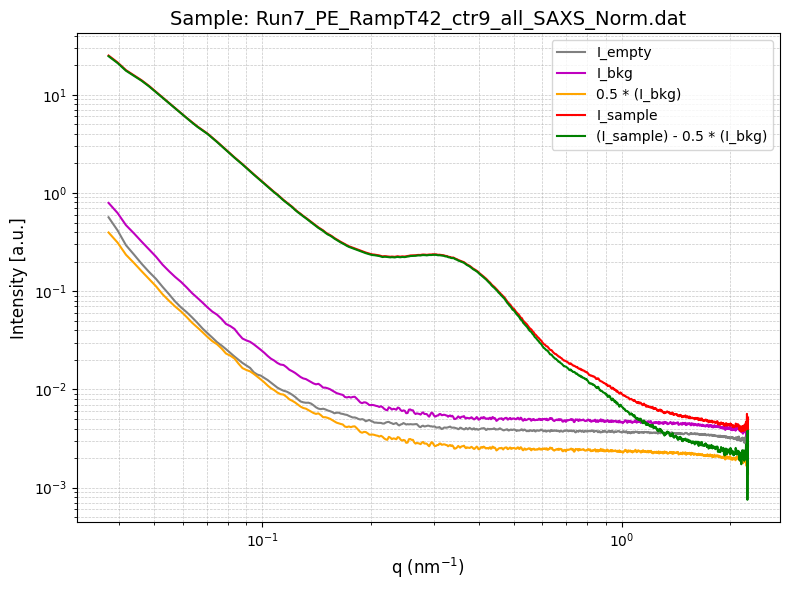

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT42_ctr9_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT45_ctr10_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT45_ctr10_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170222.68, bstop=6.1225, ctemp=48.113457000000004, I0=20.974663333333332
Metadata parsed successfully: Timer=99868.68433333332, bstop=5.800446666666667, ctemp=48.465106999999996, I0=20.782663333333332
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


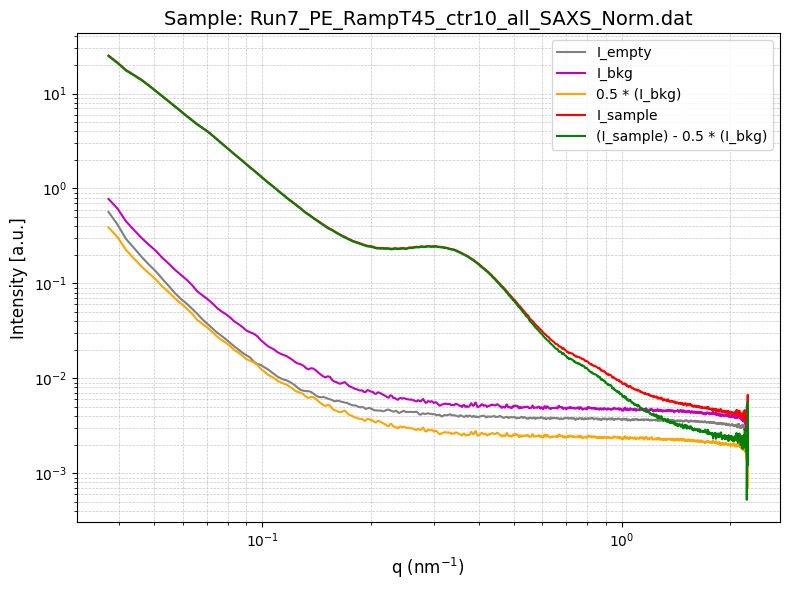

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT45_ctr10_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT47_ctr11_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT47_ctr11_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170266.80999999997, bstop=6.114033333333334, ctemp=47.45837366666666, I0=20.95266666666667
Metadata parsed successfully: Timer=99913.87799999998, bstop=5.858826666666666, ctemp=47.67397066666666, I0=21.01381333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


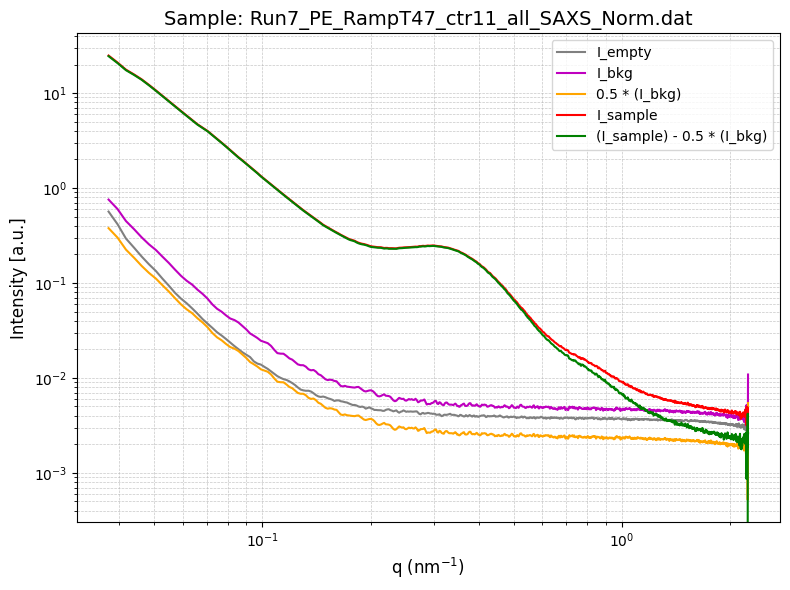

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT47_ctr11_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT50_ctr12_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT50_ctr12_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170326.75666666668, bstop=6.098033333333333, ctemp=50.734487, I0=20.872153333333333
Metadata parsed successfully: Timer=99978.898, bstop=5.837656666666667, ctemp=53.127939999999995, I0=20.92560333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


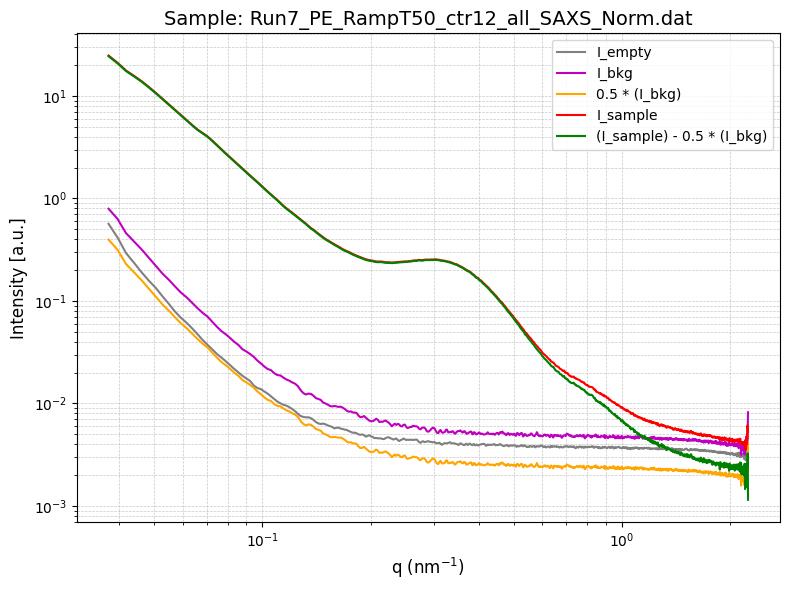

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT50_ctr12_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT52_ctr13_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT52_ctr13_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170407.21, bstop=6.158873333333333, ctemp=55.34498966666666, I0=21.115859999999998
Metadata parsed successfully: Timer=100023.95333333332, bstop=5.829620000000001, ctemp=52.813783, I0=20.848119999999998
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


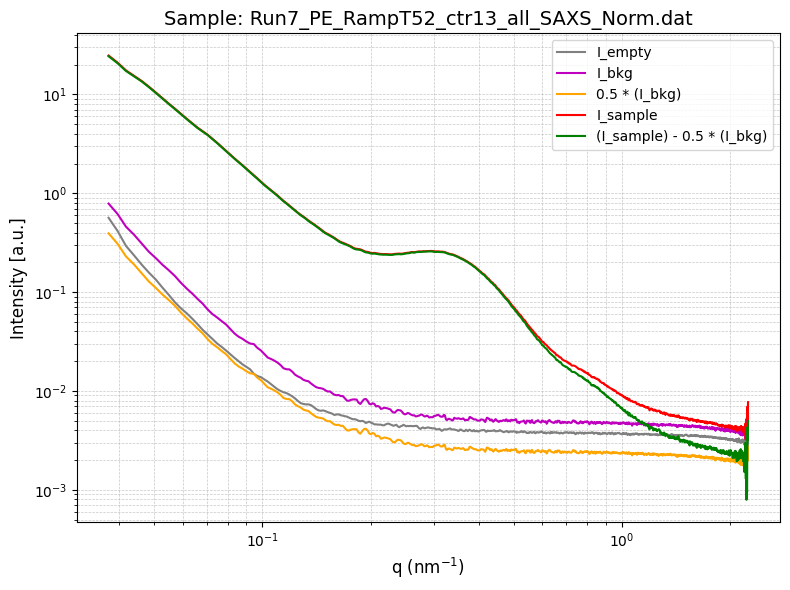

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT52_ctr13_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT55_ctr14_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT55_ctr14_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170452.27666666667, bstop=6.149746666666668, ctemp=55.148865, I0=21.046533333333333
Metadata parsed successfully: Timer=100076.63, bstop=5.819333333333333, ctemp=54.89452, I0=20.81392
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


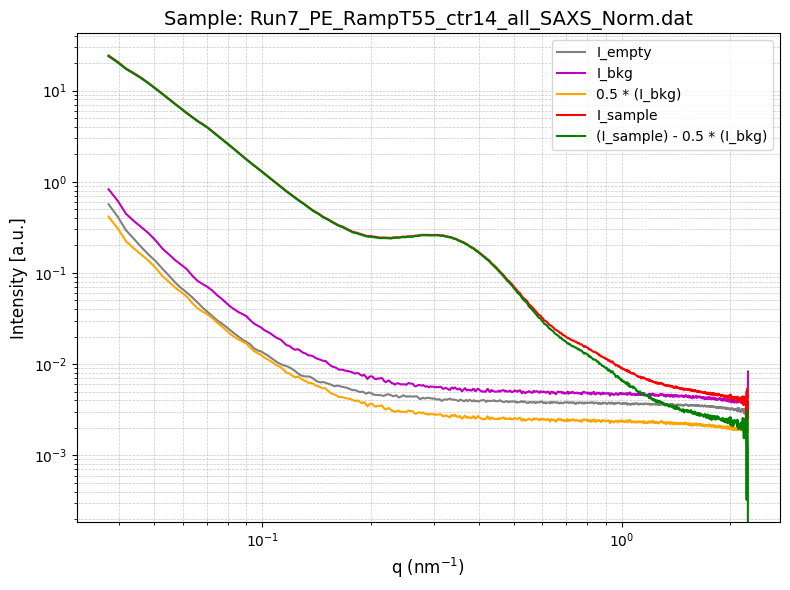

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT55_ctr14_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT57_ctr15_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT57_ctr15_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170503.70333333334, bstop=6.132446666666667, ctemp=57.56532666666667, I0=20.97945
Metadata parsed successfully: Timer=100136.75333333334, bstop=5.800503333333334, ctemp=57.61553933333334, I0=20.770363333333332
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


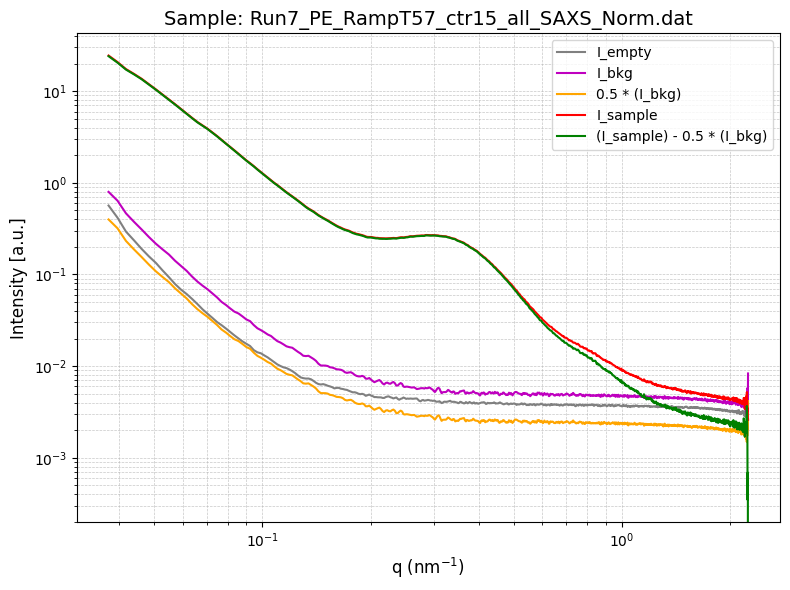

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT57_ctr15_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT60_ctr16_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT60_ctr16_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170576.15333333332, bstop=6.115553333333334, ctemp=62.55229566666667, I0=20.88702333333333
Metadata parsed successfully: Timer=100203.45, bstop=5.867506666666666, ctemp=62.813933, I0=20.99655
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


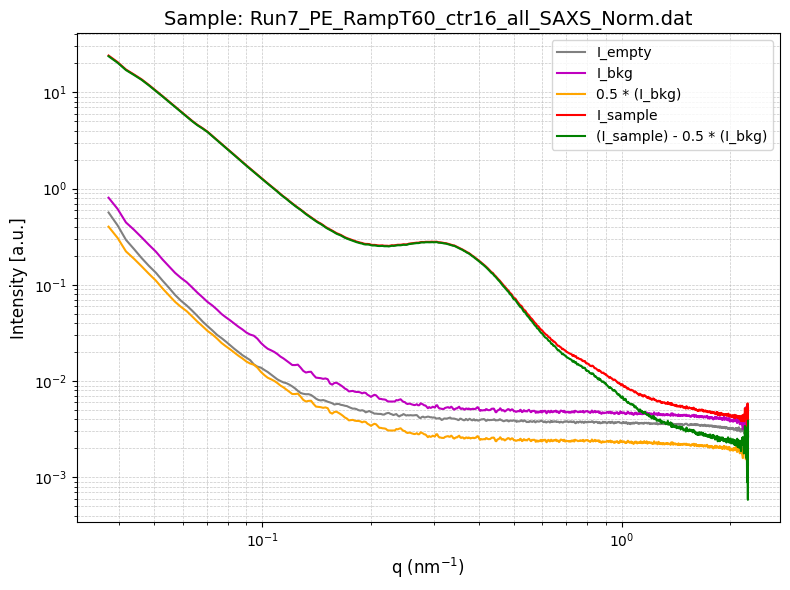

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT60_ctr16_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT62_ctr17_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT62_ctr17_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170621.05666666667, bstop=6.108123333333334, ctemp=62.43059433333334, I0=20.857853333333335
Metadata parsed successfully: Timer=100248.33666666667, bstop=5.856400000000001, ctemp=63.165203, I0=20.957256666666666
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


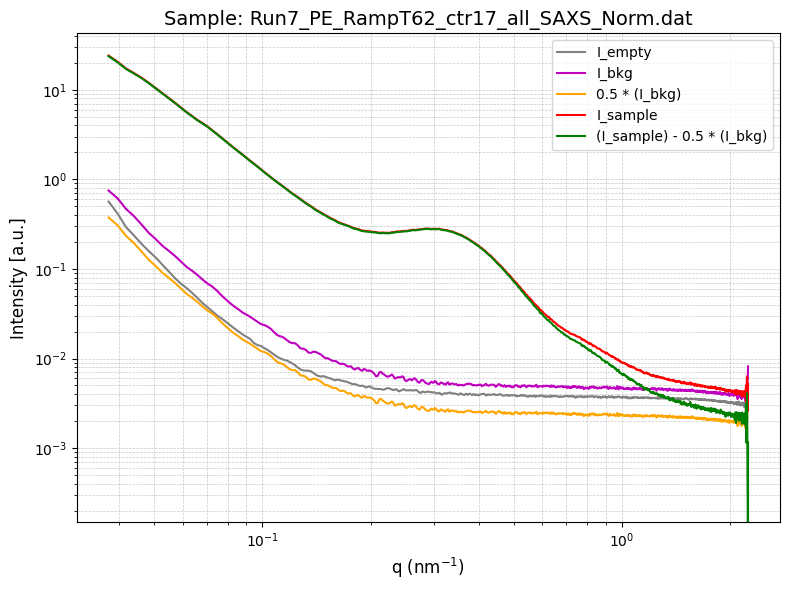

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT62_ctr17_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT65_ctr18_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT65_ctr18_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170670.41666666666, bstop=6.107896666666666, ctemp=64.80741633333332, I0=20.835113333333336
Metadata parsed successfully: Timer=100293.22666666668, bstop=5.84461, ctemp=65.00760899999999, I0=20.90917
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


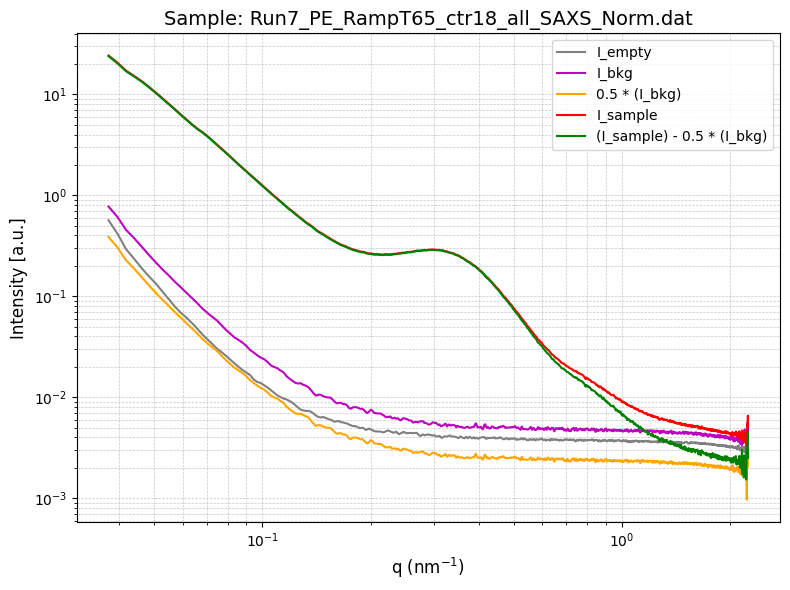

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT65_ctr18_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT67_ctr19_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT67_ctr19_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170738.87, bstop=6.141256666666666, ctemp=69.75322433333334, I0=20.99341
Metadata parsed successfully: Timer=100353.27666666666, bstop=5.835886666666667, ctemp=69.978709, I0=20.84414
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


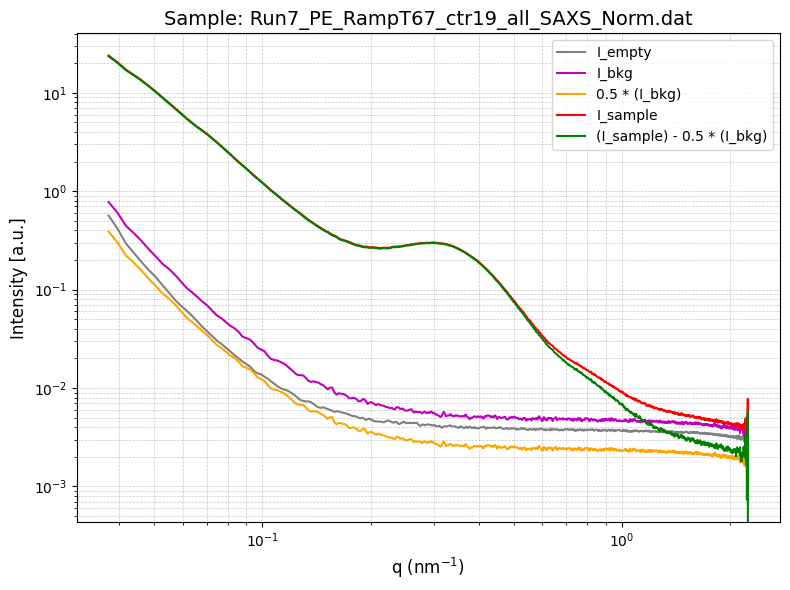

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT67_ctr19_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT70_ctr20_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT70_ctr20_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170818.94000000003, bstop=6.118473333333333, ctemp=72.22266666666667, I0=20.91987333333333
Metadata parsed successfully: Timer=100425.39999999998, bstop=5.81923, ctemp=72.51002, I0=20.77344666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


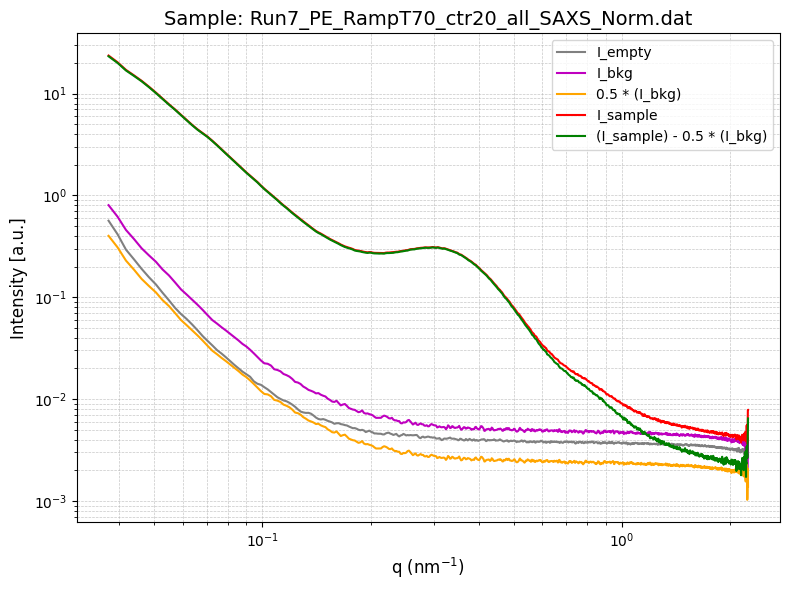

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT70_ctr20_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT72_ctr21_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT72_ctr21_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170899.0166666667, bstop=6.098956666666666, ctemp=74.645917, I0=20.815436666666667
Metadata parsed successfully: Timer=100498.26666666666, bstop=5.868986666666667, ctemp=74.93459566666667, I0=20.939493333333335
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


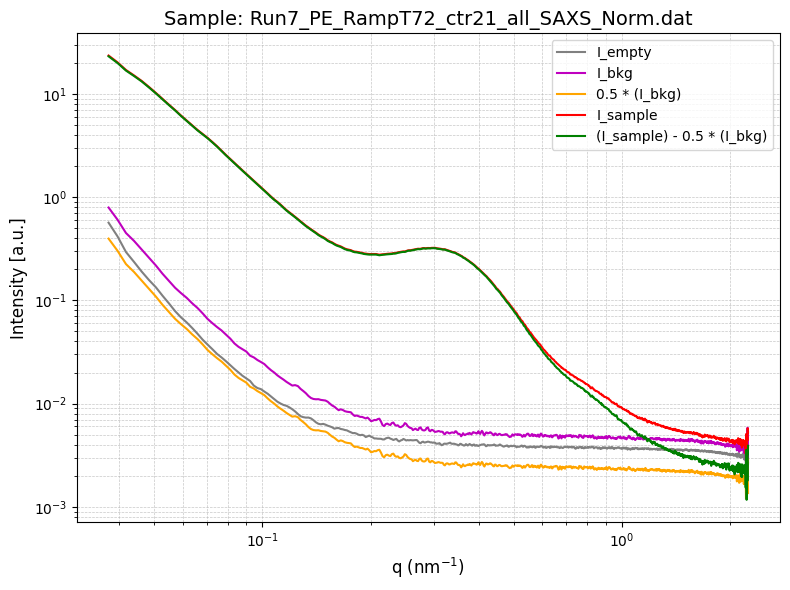

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT72_ctr21_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT75_ctr22_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT75_ctr22_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=170979.46, bstop=6.111483333333333, ctemp=77.09877266666666, I0=20.8267
Metadata parsed successfully: Timer=100572.14000000001, bstop=5.860913333333333, ctemp=77.36410266666667, I0=20.907236666666666
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


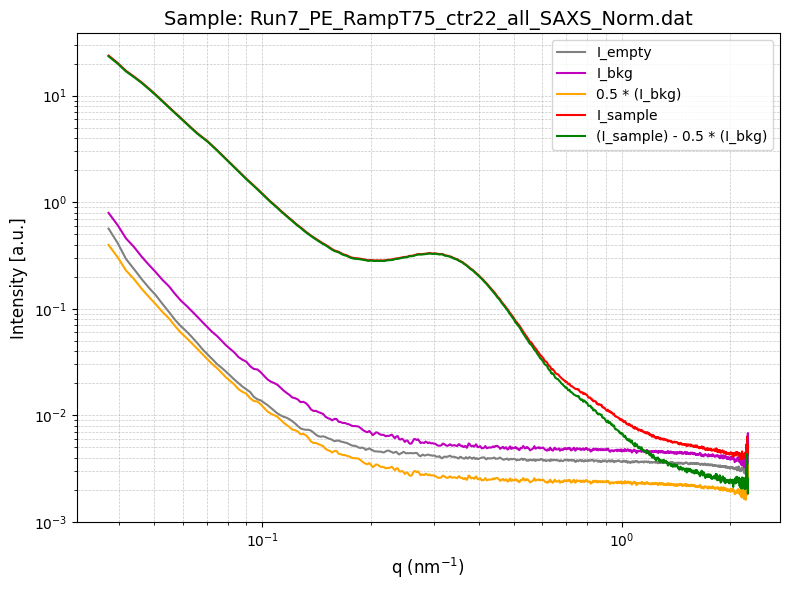

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT75_ctr22_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT77_ctr23_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT77_ctr23_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171061.97, bstop=6.153363333333334, ctemp=79.50071233333334, I0=20.986966666666664
Metadata parsed successfully: Timer=100647.21, bstop=5.848056666666667, ctemp=79.78662366666667, I0=20.80968
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


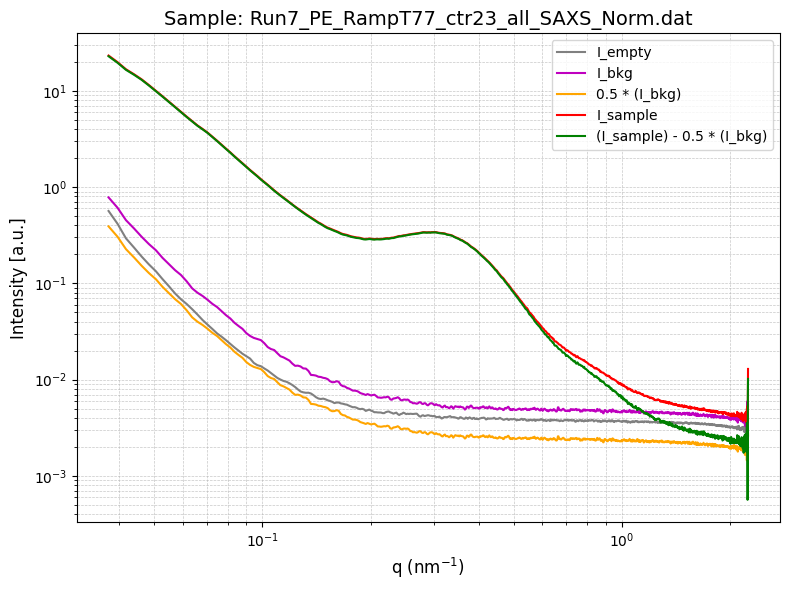

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT77_ctr23_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT80_ctr24_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT80_ctr24_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171145.66333333336, bstop=6.132556666666667, ctemp=81.918274, I0=20.86742333333333
Metadata parsed successfully: Timer=100723.53333333333, bstop=5.823603333333334, ctemp=82.194275, I0=20.7305
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


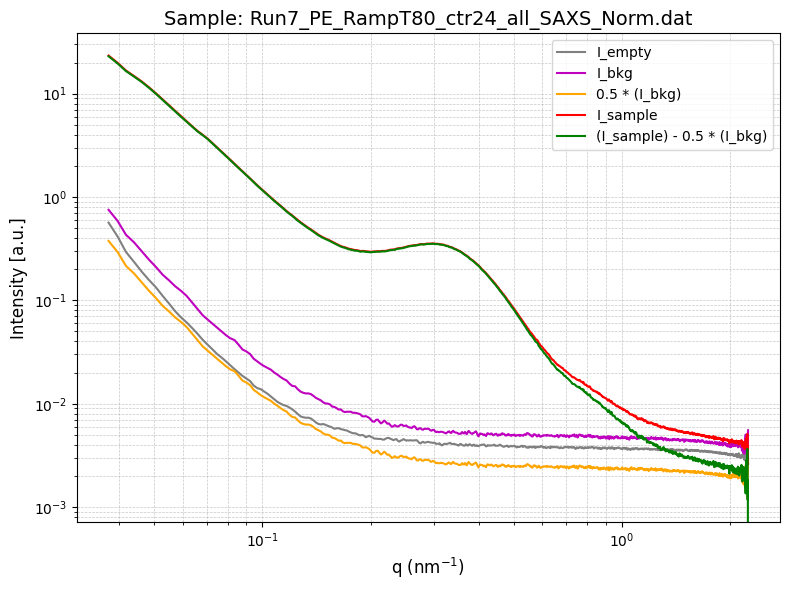

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT80_ctr24_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT82_ctr25_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT82_ctr25_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171232.22, bstop=6.108846666666667, ctemp=84.335126, I0=20.794539999999998
Metadata parsed successfully: Timer=100801.18333333333, bstop=5.876296666666668, ctemp=84.57542933333333, I0=20.97469
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


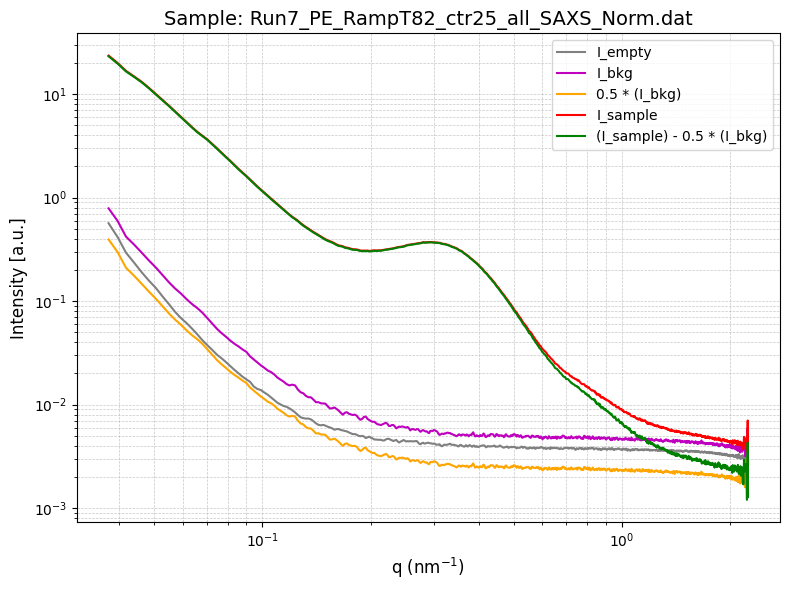

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT82_ctr25_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT85_ctr26_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT85_ctr26_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171319.19666666666, bstop=6.167433333333332, ctemp=86.746602, I0=20.979803333333333
Metadata parsed successfully: Timer=100880.16333333333, bstop=5.859466666666666, ctemp=86.99566666666668, I0=20.870060000000002
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


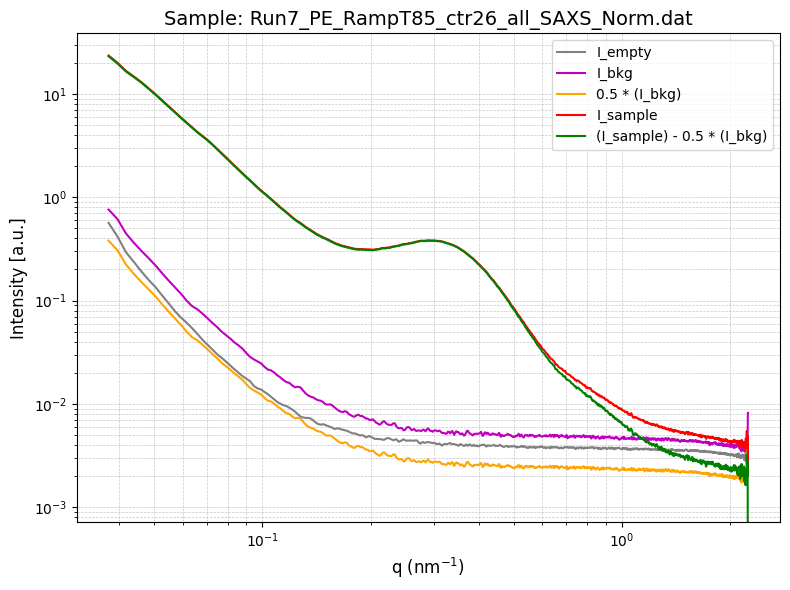

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT85_ctr26_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT87_ctr27_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT87_ctr27_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171407.45333333334, bstop=6.1397466666666665, ctemp=89.124326, I0=20.914023333333333
Metadata parsed successfully: Timer=100959.16666666667, bstop=5.842089999999999, ctemp=89.40471633333334, I0=20.765863333333332
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


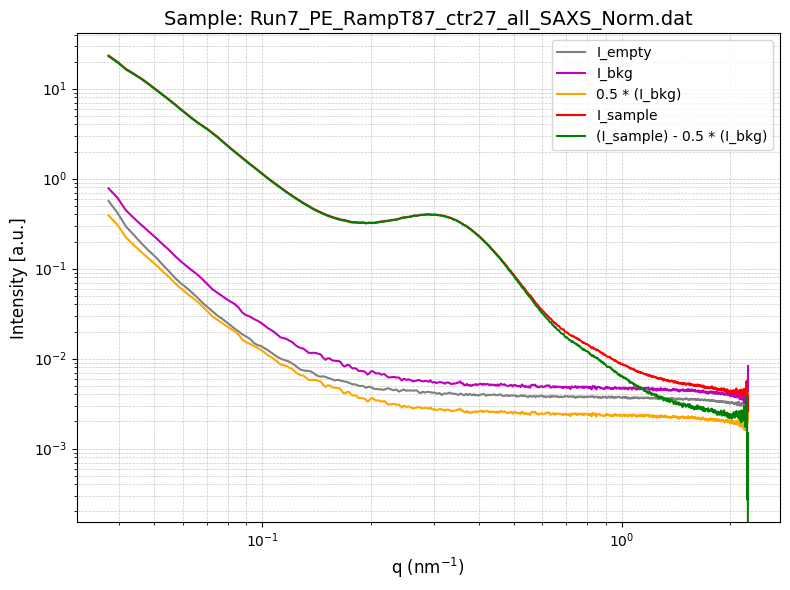

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT87_ctr27_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT90_ctr28_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT90_ctr28_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171496.07333333333, bstop=6.117173333333334, ctemp=91.56876866666666, I0=20.818369999999998
Metadata parsed successfully: Timer=101039.35000000002, bstop=5.823316666666667, ctemp=91.78409066666667, I0=20.700313333333334
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


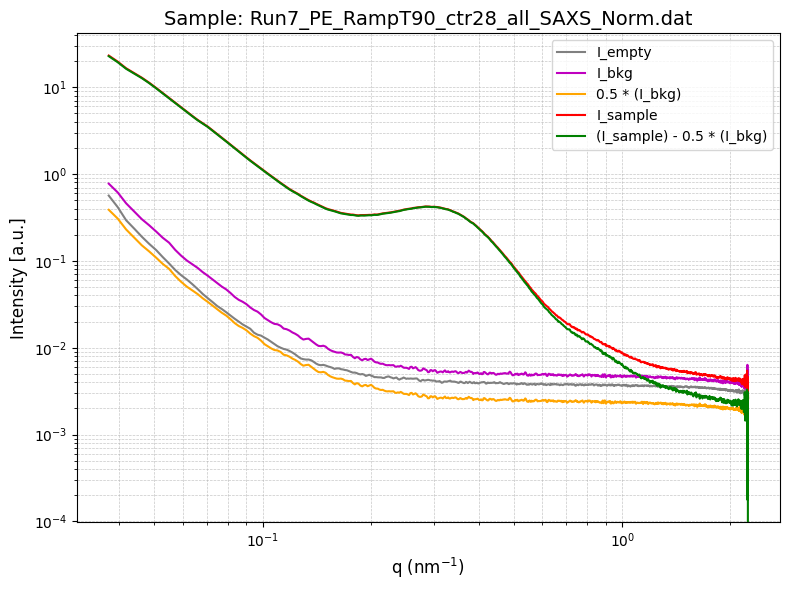

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT90_ctr28_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT92_ctr29_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT92_ctr29_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171586.22333333336, bstop=6.144593333333333, ctemp=94.01152533333334, I0=20.888923333333334
Metadata parsed successfully: Timer=101120.76000000001, bstop=5.879203333333334, ctemp=94.163137, I0=20.88855
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


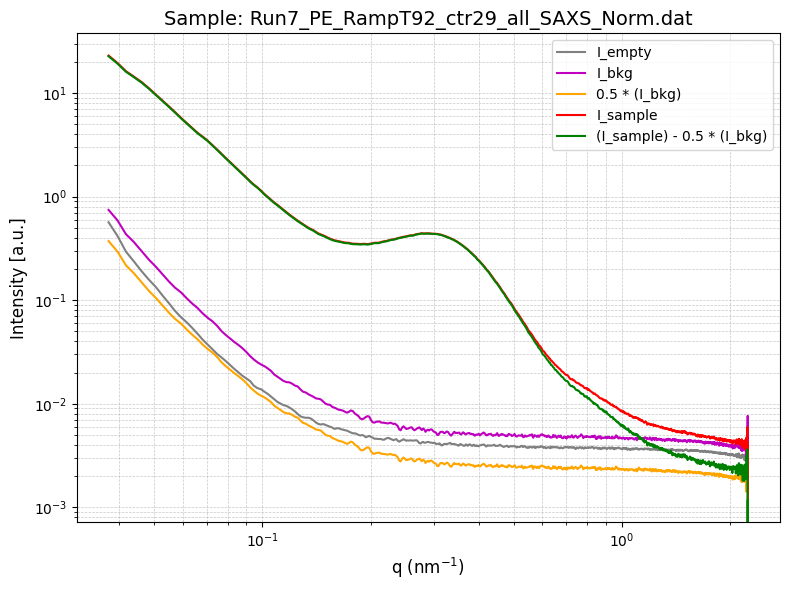

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT92_ctr29_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT95_ctr30_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT95_ctr30_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171678.09, bstop=6.14671, ctemp=96.33691433333333, I0=20.86594
Metadata parsed successfully: Timer=101202.0, bstop=5.862333333333333, ctemp=96.58378066666667, I0=20.809070000000002
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


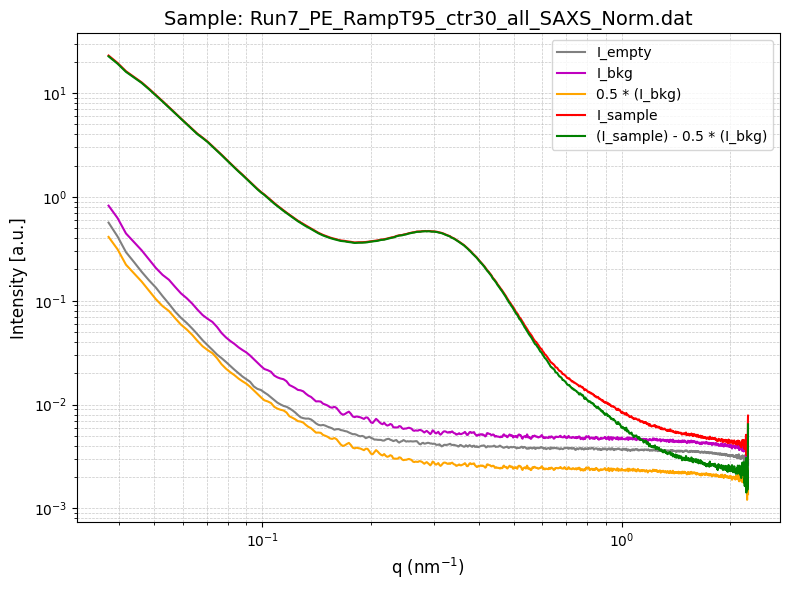

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT95_ctr30_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT97_ctr31_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT97_ctr31_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171770.02, bstop=6.1228066666666665, ctemp=98.75475333333334, I0=20.769343333333335
Metadata parsed successfully: Timer=101284.55333333334, bstop=5.843393333333332, ctemp=98.96879833333334, I0=20.756583333333335
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


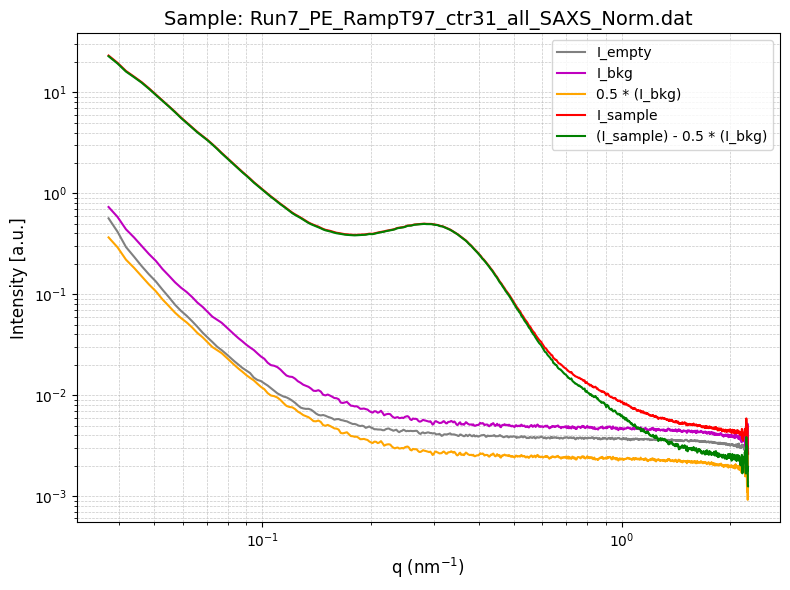

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT97_ctr31_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT100_ctr32_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT100_ctr32_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171863.18, bstop=6.10043, ctemp=101.17446666666666, I0=20.687223333333336
Metadata parsed successfully: Timer=101365.75333333334, bstop=5.818543333333333, ctemp=101.3848, I0=20.657466666666668
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


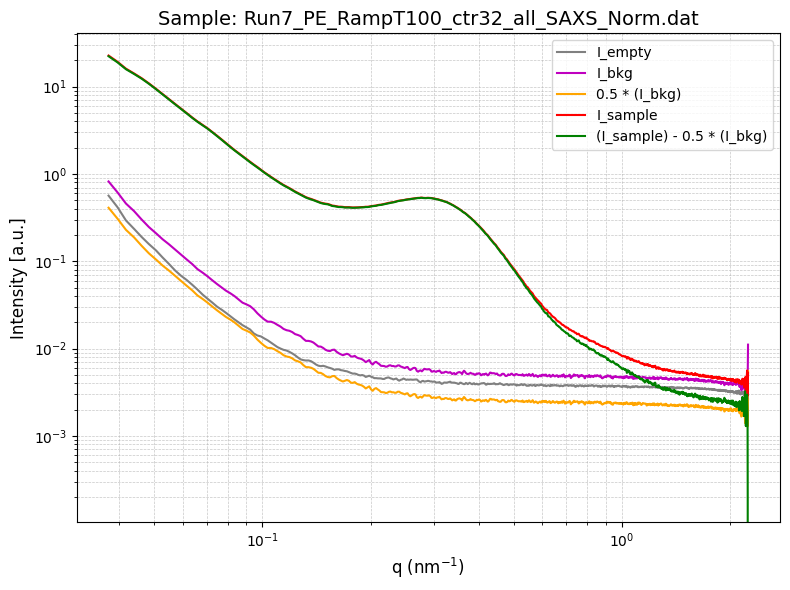

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT100_ctr32_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT102_ctr33_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT102_ctr33_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=171955.87666666668, bstop=6.15647, ctemp=103.5872, I0=20.91862666666667
Metadata parsed successfully: Timer=101446.65666666666, bstop=5.87716, ctemp=103.7817, I0=20.85352333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


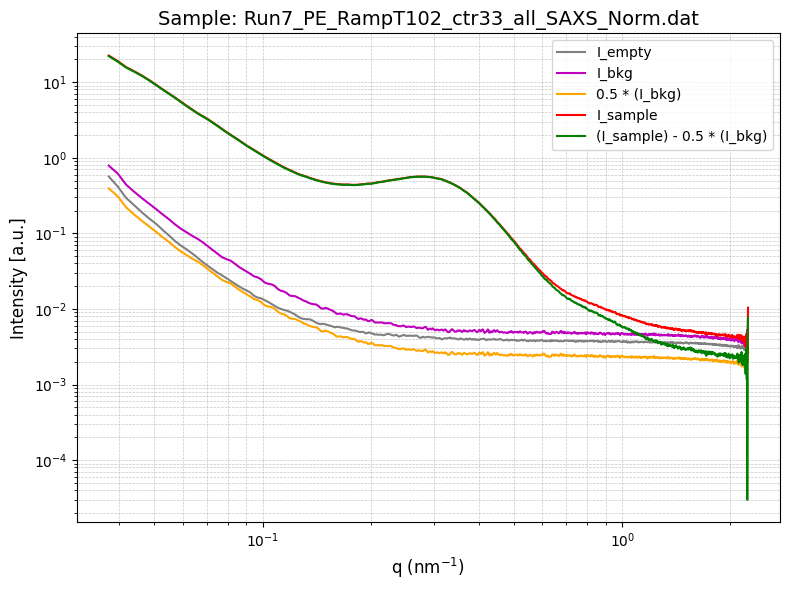

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT102_ctr33_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT105_ctr34_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT105_ctr34_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172048.84, bstop=6.1324700000000005, ctemp=106.00106666666666, I0=20.803906666666666
Metadata parsed successfully: Timer=101527.97666666668, bstop=5.85748, ctemp=106.1372, I0=20.799333333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


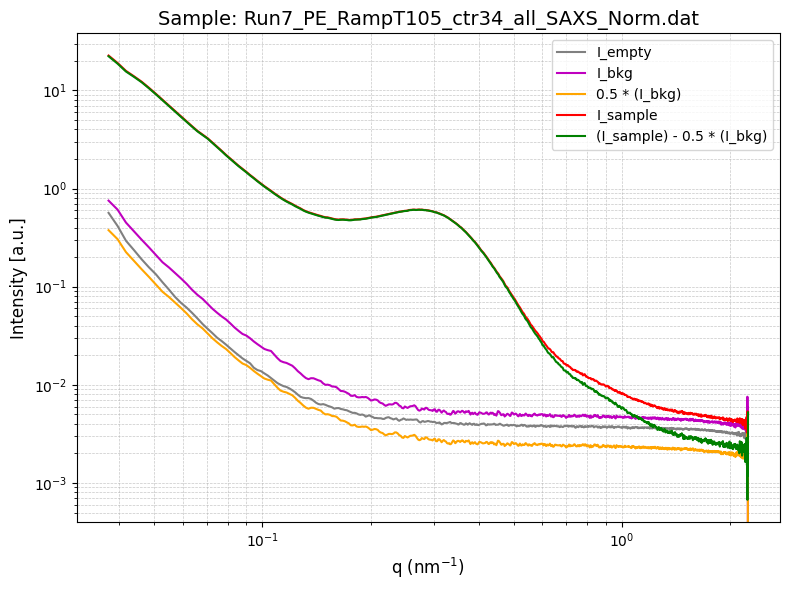

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT105_ctr34_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT107_ctr35_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT107_ctr35_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172142.6, bstop=6.110936666666667, ctemp=108.354, I0=20.685306666666666
Metadata parsed successfully: Timer=101607.91333333333, bstop=5.835113333333333, ctemp=108.57373333333334, I0=20.70527
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


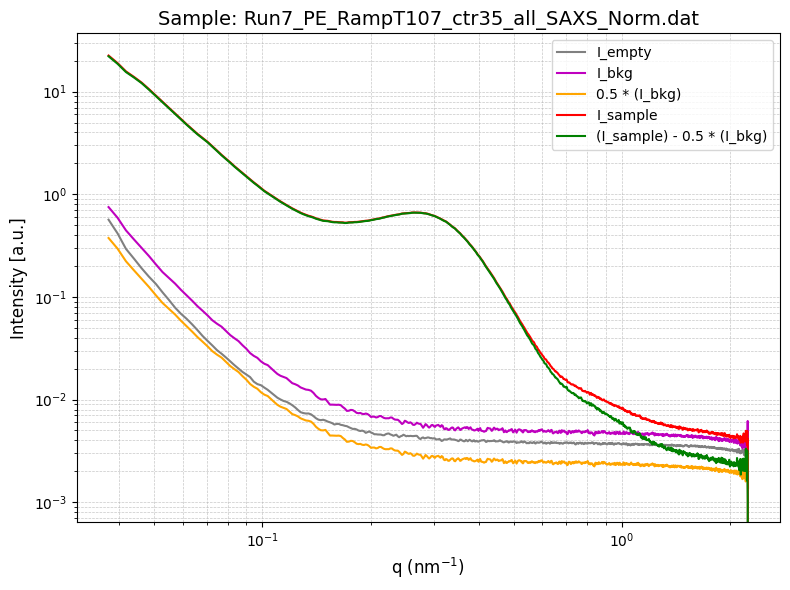

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT107_ctr35_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT110_ctr36_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT110_ctr36_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172235.05666666667, bstop=6.169316666666667, ctemp=110.74663333333332, I0=20.900183333333334
Metadata parsed successfully: Timer=101686.15333333332, bstop=5.87229, ctemp=111.01943333333334, I0=20.828453333333332
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


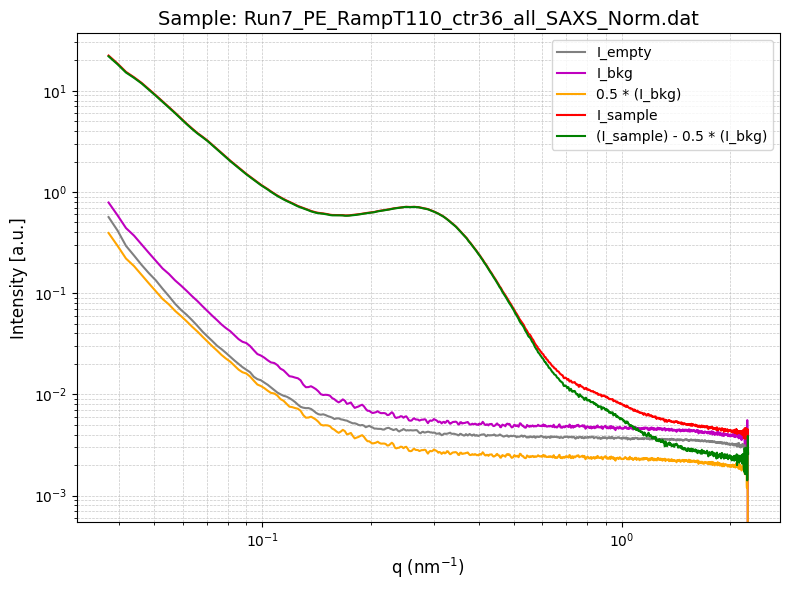

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT110_ctr36_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT112_ctr37_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT112_ctr37_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172326.90333333332, bstop=6.1406133333333335, ctemp=113.21303333333333, I0=20.786133333333332
Metadata parsed successfully: Timer=101765.72333333333, bstop=5.87947, ctemp=113.41543333333334, I0=20.846613333333334
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


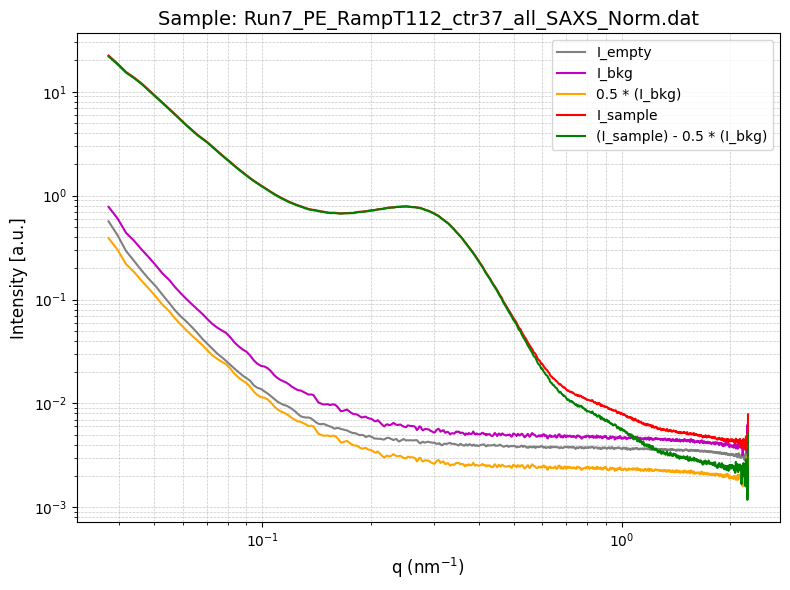

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT112_ctr37_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT115_ctr38_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT115_ctr38_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172419.05666666667, bstop=6.122013333333334, ctemp=115.62270000000001, I0=20.671086666666664
Metadata parsed successfully: Timer=101844.71666666666, bstop=5.8613333333333335, ctemp=115.7777, I0=20.761313333333334
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


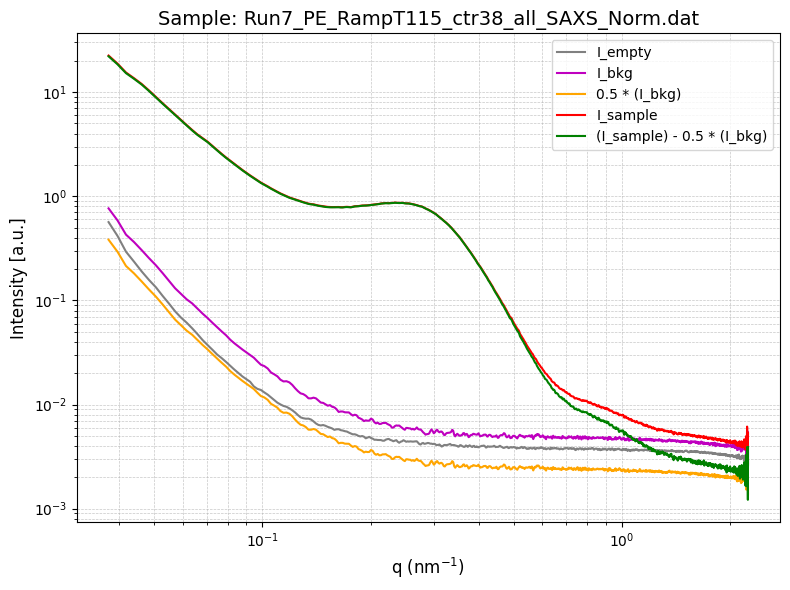

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT115_ctr38_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT117_ctr39_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT117_ctr39_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172511.26333333334, bstop=6.17621, ctemp=118.10090000000001, I0=20.888769999999997
Metadata parsed successfully: Timer=101921.36333333334, bstop=5.838793333333332, ctemp=118.22833333333334, I0=20.67021
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


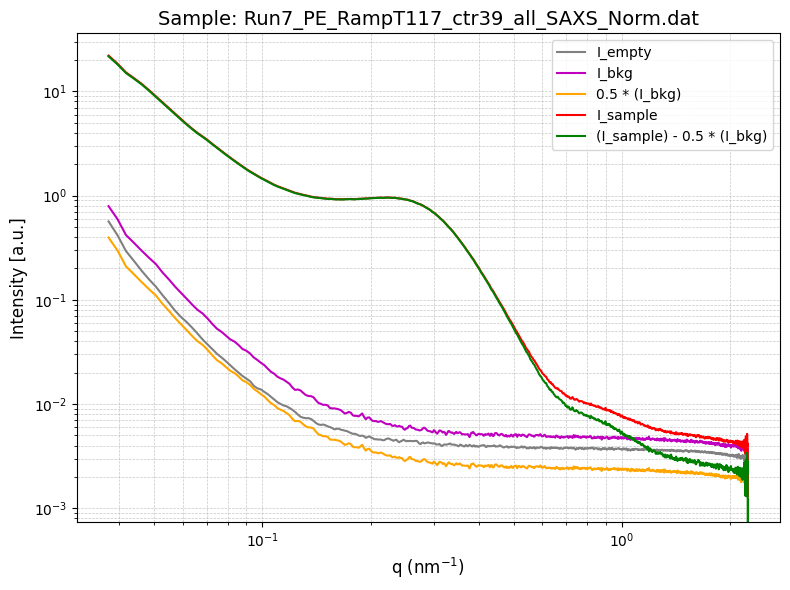

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT117_ctr39_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT120_ctr40_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT120_ctr40_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172606.18, bstop=6.14483, ctemp=120.38896666666666, I0=20.760413333333332
Metadata parsed successfully: Timer=101997.87333333334, bstop=5.894159999999999, ctemp=120.70866666666666, I0=20.884656666666668
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


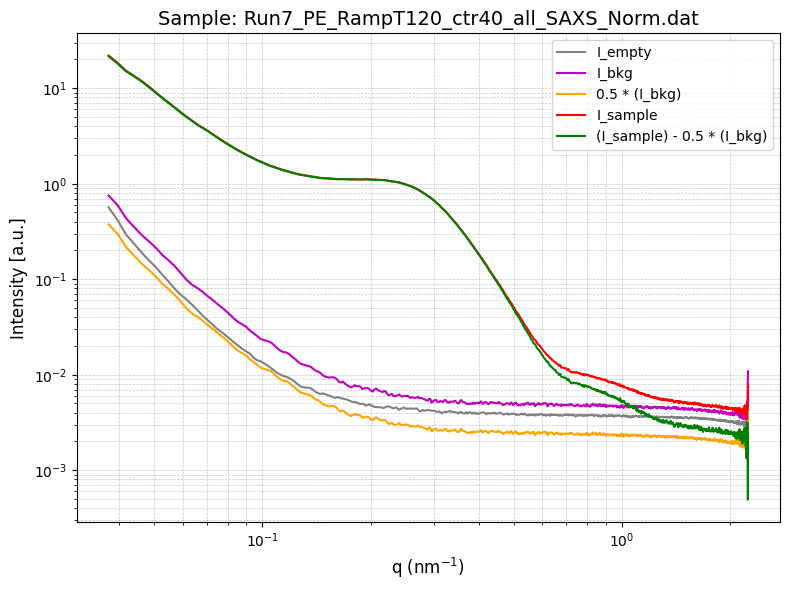

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT120_ctr40_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT122_ctr41_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT122_ctr41_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172698.70333333334, bstop=6.123916666666667, ctemp=122.89683333333335, I0=20.71171
Metadata parsed successfully: Timer=102077.51666666666, bstop=5.88088, ctemp=122.96679999999999, I0=20.854836666666667
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


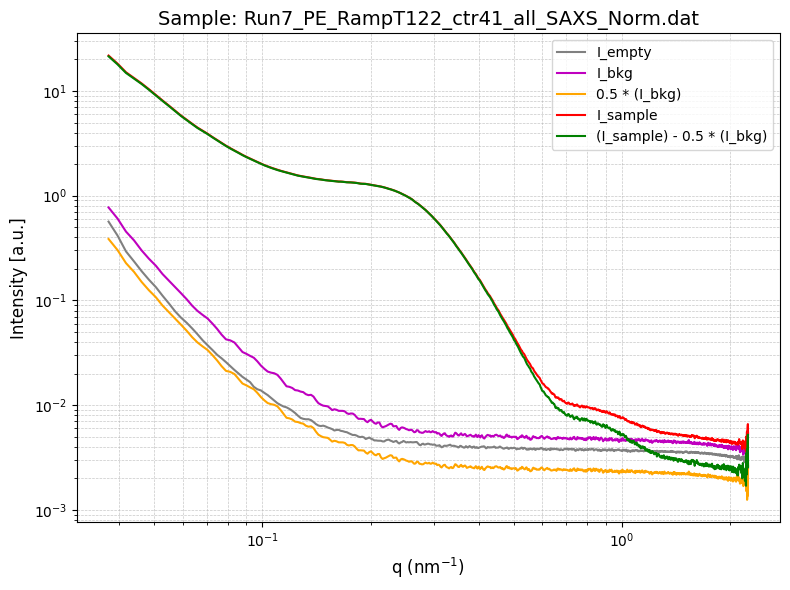

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT122_ctr41_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT125_ctr42_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT125_ctr42_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172793.25666666668, bstop=6.163243333333334, ctemp=125.28033333333333, I0=20.79493666666667
Metadata parsed successfully: Timer=102152.88333333335, bstop=5.861236666666667, ctemp=125.50953333333332, I0=20.75476
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


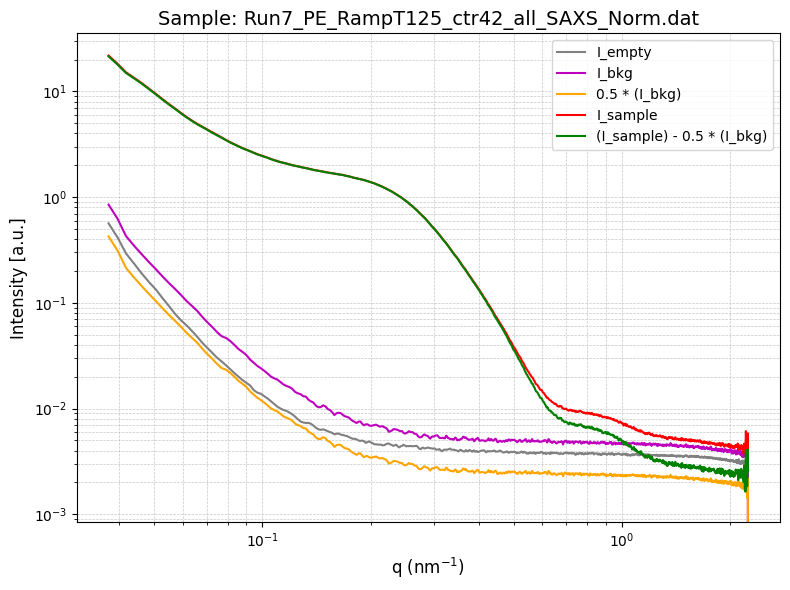

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT125_ctr42_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT127_ctr43_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT127_ctr43_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172889.00666666668, bstop=6.167856666666666, ctemp=127.67856666666665, I0=20.81347
Metadata parsed successfully: Timer=102230.46666666667, bstop=5.84212, ctemp=127.87820333333332, I0=20.640953333333332
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


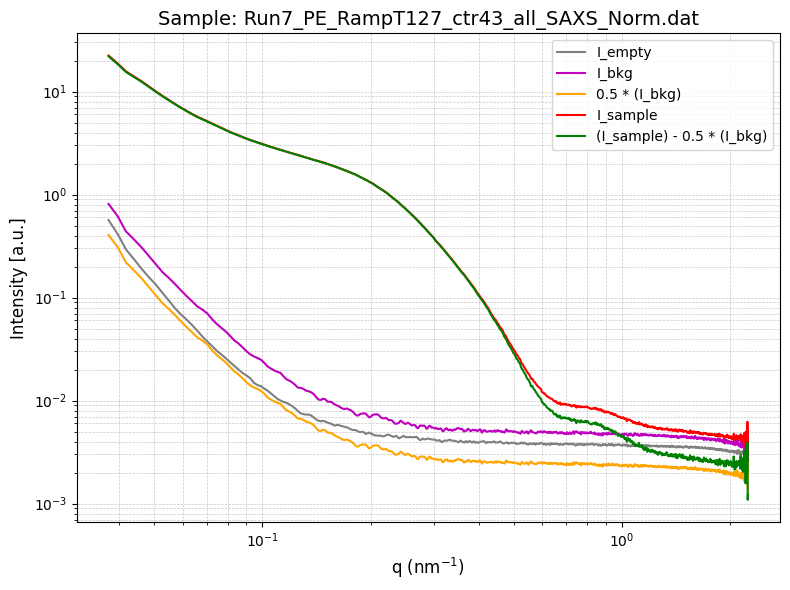

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT127_ctr43_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT130_ctr44_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT130_ctr44_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=172983.83, bstop=6.14783, ctemp=130.14873666666668, I0=20.681963333333332
Metadata parsed successfully: Timer=102307.45666666667, bstop=5.910903333333334, ctemp=130.27946666666665, I0=20.89997333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


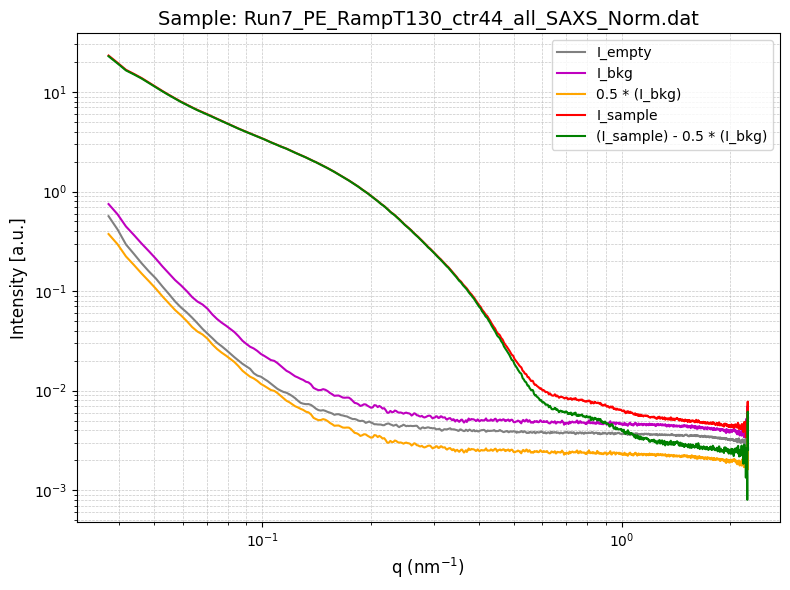

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT130_ctr44_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT132_ctr45_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT132_ctr45_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173081.13333333333, bstop=6.159216666666666, ctemp=132.571, I0=20.71077
Metadata parsed successfully: Timer=102384.39, bstop=5.887523333333334, ctemp=132.65090333333333, I0=20.81502
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


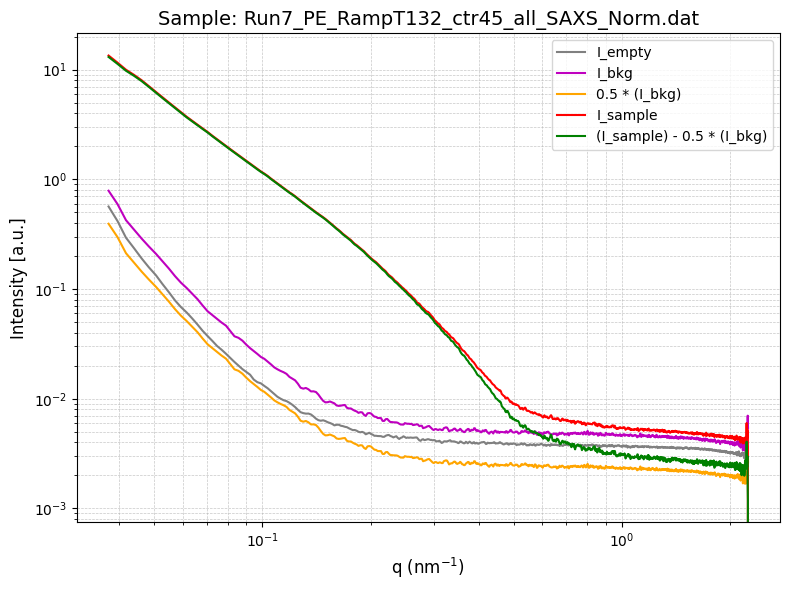

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT132_ctr45_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT135_ctr46_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT135_ctr46_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173178.71333333335, bstop=6.179289999999999, ctemp=135.00383333333332, I0=20.758926666666664
Metadata parsed successfully: Timer=102460.00333333334, bstop=5.866363333333333, ctemp=135.16080333333332, I0=20.70958
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


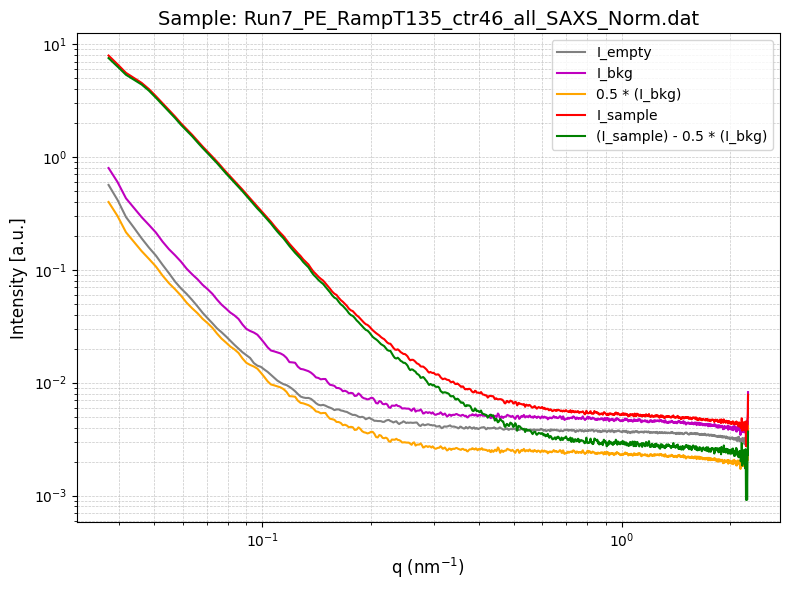

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT135_ctr46_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT137_ctr47_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT137_ctr47_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173278.29666666666, bstop=6.161026666666667, ctemp=137.44247333333334, I0=20.65442
Metadata parsed successfully: Timer=102539.01333333332, bstop=5.84506, ctemp=137.52160333333333, I0=20.62396
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


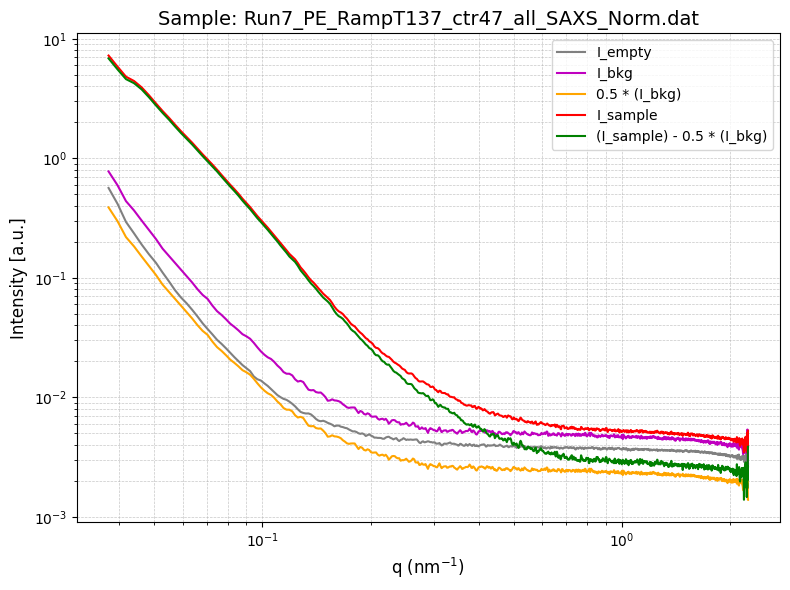

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT137_ctr47_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT140_ctr48_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT140_ctr48_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173380.41666666666, bstop=6.165726666666667, ctemp=139.82506666666666, I0=20.660513333333338
Metadata parsed successfully: Timer=102616.71, bstop=5.910679999999999, ctemp=139.96979666666667, I0=20.85699
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


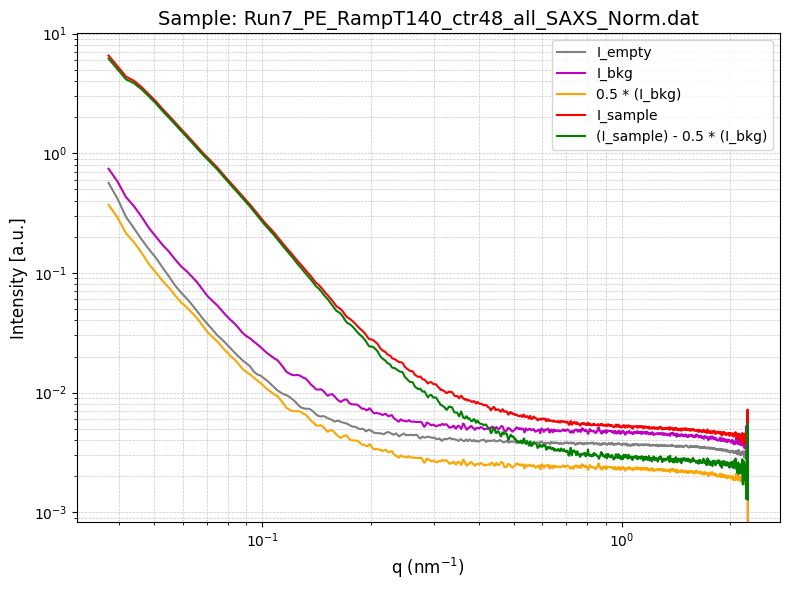

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT140_ctr48_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT142_ctr49_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT142_ctr49_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173481.61333333334, bstop=6.1889166666666675, ctemp=142.32966666666667, I0=20.74721333333333
Metadata parsed successfully: Timer=102694.35999999999, bstop=5.888343333333334, ctemp=142.41393000000002, I0=20.762629999999998
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


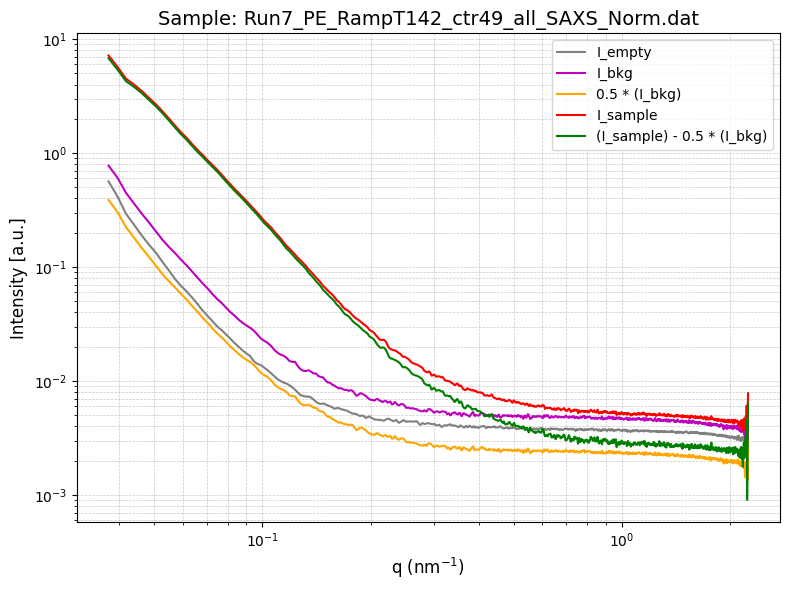

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT142_ctr49_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT145_ctr50_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT145_ctr50_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173586.27333333335, bstop=6.158243333333334, ctemp=144.79670000000002, I0=20.620563333333333
Metadata parsed successfully: Timer=102773.23333333334, bstop=5.869, ctemp=144.77586666666664, I0=20.680526666666665
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


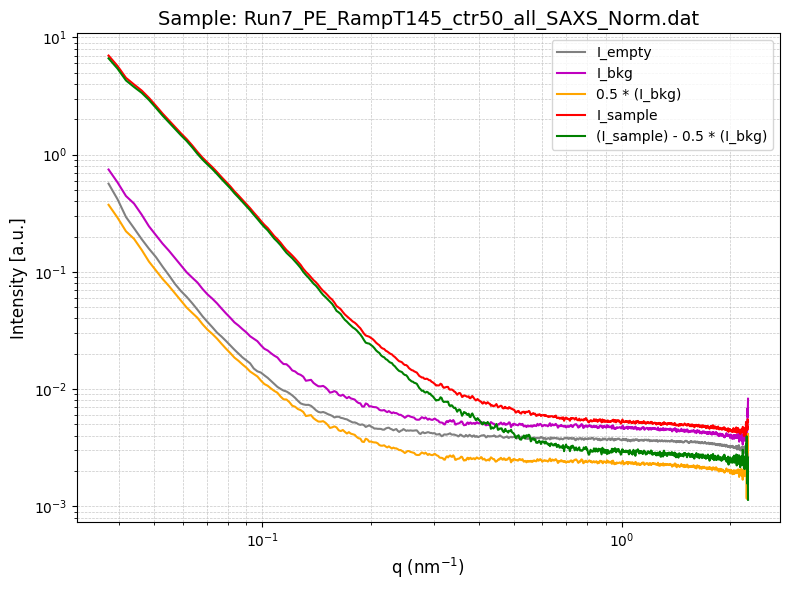

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT145_ctr50_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT147_ctr51_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT147_ctr51_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173693.47333333336, bstop=6.190086666666667, ctemp=147.22203333333331, I0=20.71992
Metadata parsed successfully: Timer=102851.96666666667, bstop=5.846633333333334, ctemp=147.21906333333334, I0=20.58438333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


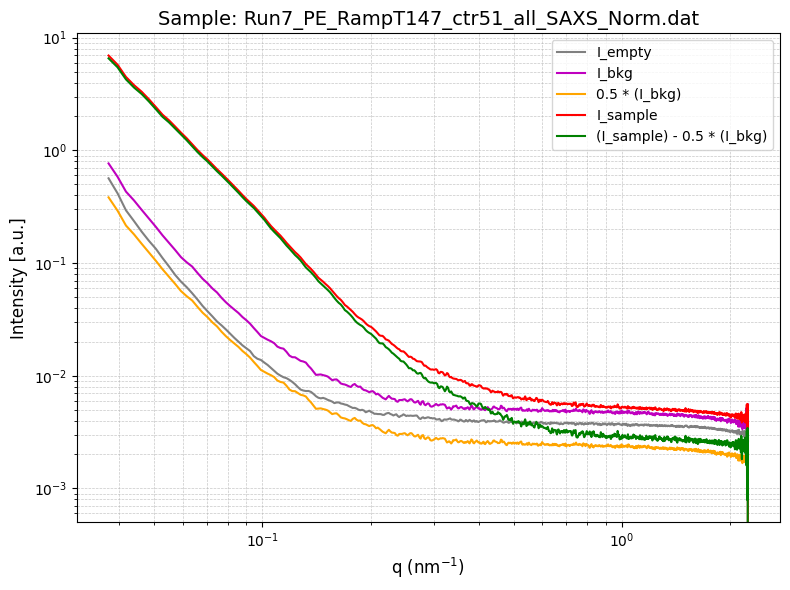

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT147_ctr51_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT150_ctr52_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT150_ctr52_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173802.50333333333, bstop=6.173729999999999, ctemp=149.68987, I0=20.67104
Metadata parsed successfully: Timer=102930.88333333335, bstop=5.9028566666666675, ctemp=149.70884, I0=20.775716666666668
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


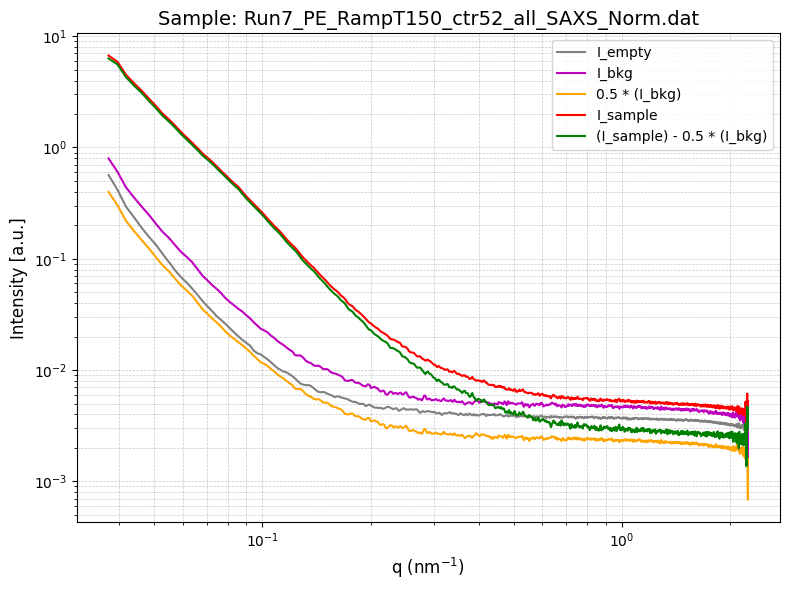

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT150_ctr52_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT152_ctr53_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT152_ctr53_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=173915.08333333334, bstop=6.144783333333334, ctemp=152.09719666666666, I0=20.545576666666665
Metadata parsed successfully: Timer=103010.74666666666, bstop=5.886886666666666, ctemp=152.16656333333333, I0=20.72554333333333
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


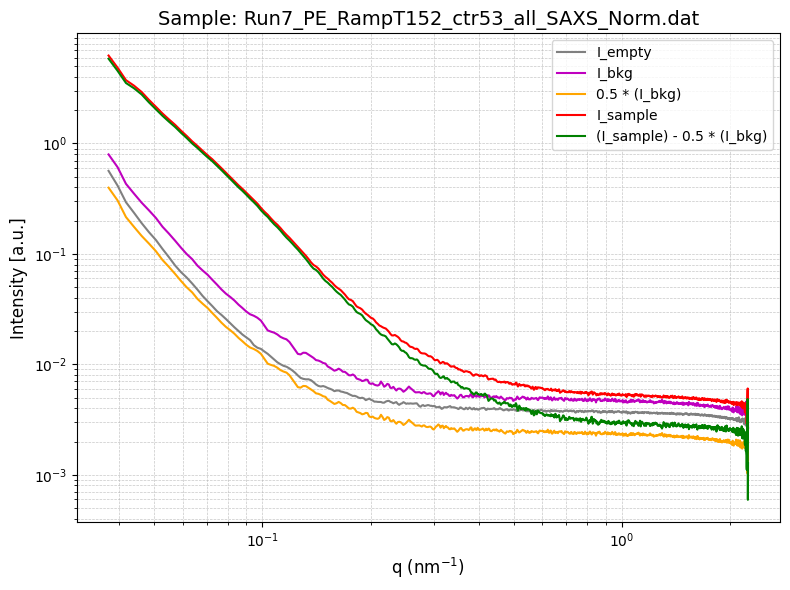

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT152_ctr53_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT155_ctr54_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT155_ctr54_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=174029.17666666664, bstop=6.192453333333333, ctemp=154.60216666666668, I0=20.714883333333333
Metadata parsed successfully: Timer=103092.09999999999, bstop=5.863433333333333, ctemp=154.57296666666667, I0=20.659209999999998
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


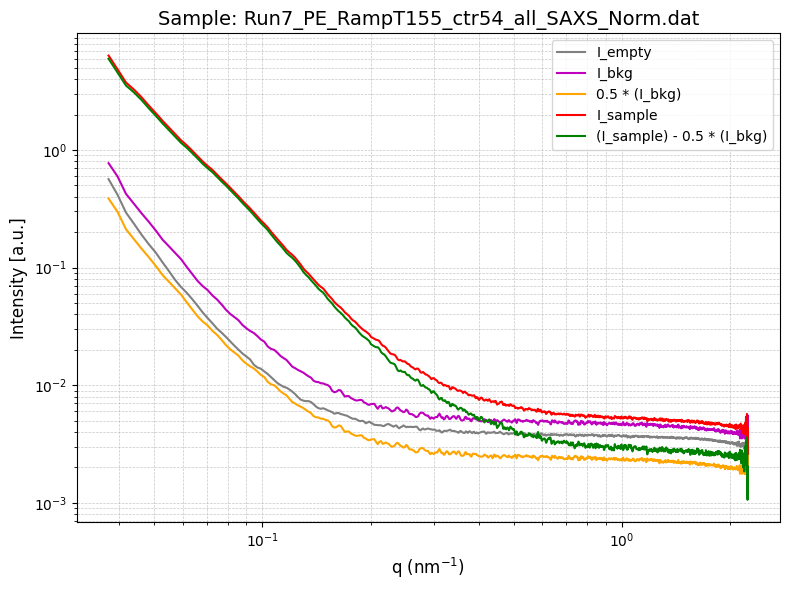

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT155_ctr54_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT157_ctr55_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT157_ctr55_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=174147.83333333334, bstop=6.160863333333334, ctemp=157.03150333333335, I0=20.582736666666666
Metadata parsed successfully: Timer=103174.56999999999, bstop=5.867896666666667, ctemp=156.98930333333334, I0=20.618550000000003
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


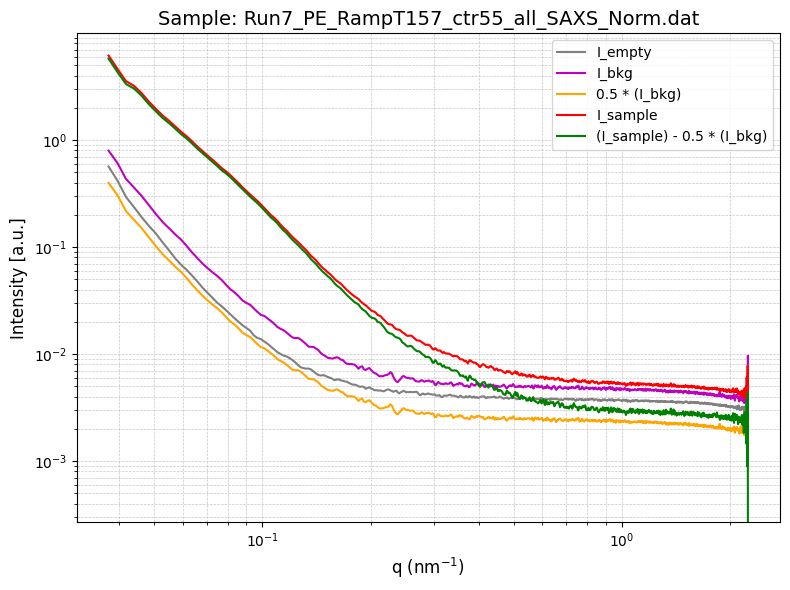

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT157_ctr55_all_SAXS_Norm_sub.dat
Sample: Run7_PE_RampT160_ctr56_all_SAXS_Norm.dat
Background: Run3_Empty_capi_RampT160_ctr56_all_SAXS_Norm.dat
Empty: RT_Air_10s_03_T25_y0_dx0_ctr0_all_SAXS_Norm.dat
Metadata parsed successfully: Timer=174269.42666666667, bstop=6.145283333333334, ctemp=159.54453666666666, I0=20.51071333333333
Metadata parsed successfully: Timer=103256.08333333333, bstop=5.905593333333333, ctemp=159.43426666666667, I0=20.784166666666668
Metadata parsed successfully: Timer=16406.015, bstop=18.172648889, ctemp=23.776608999999997, I0=20.993976666333335
0.5


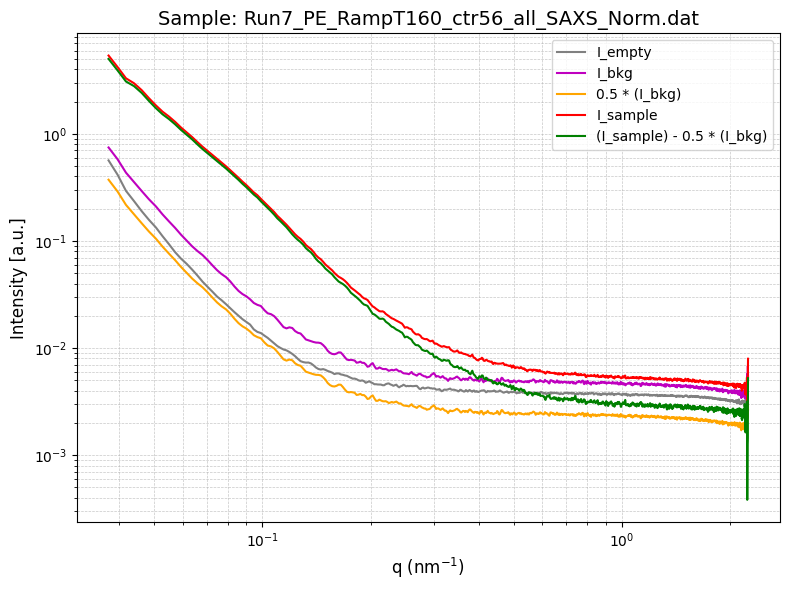

Saving SAXS data to /Users/akmaurya/OneDrive - Stanford/Data_01/Autoxidation/Autoxidation/Jan2025/atT/OneD_integrated_SAXS_01/Correction/Subtracted/Run7_PE_RampT160_ctr56_all_SAXS_Norm_sub.dat


'\n\n'

In [30]:
search_keywords = [f'ctr{str(i)}_' for i in range(0, 57)]

alpha_values = {
    "poly": 0.1,
    "solv": 0.1,
    "saxs": 0.3
}

def process_samples(samples, alpha_waxs):
    for sample_keyword, bkg_keyword, empty_keyword in samples:
        #WAXS_bkg_subtract(folder_WAXS_path_base, search_keywords, sample_keyword, bkg_keyword, empty_keyword, alpha_waxs, save_WAXS_sub_files)
        SAXS_bkg_subtract(folder_SAXS_path_base, search_keywords, sample_keyword, bkg_keyword, empty_keyword, alpha_values["saxs"], save_SAXS_sub_files)

poly_samples = [
    ("Run7_PE_RampT", "Run3_Empty_capi_RampT", "Air"),
    


]

solv_samples = [
    ("Run6_PE_AcOH_RampT", "Run10_AcOH_RampT", "Run3_Empty_capi_RampT"),
    ("Run8_PE_Salt_RampT", "Run14_Salt_RampT", "Run3_Empty_capi_RampT"),


]
process_samples(solv_samples, alpha_values["solv"])
process_samples(poly_samples, alpha_values["poly"])




'''

'''

# PS at RT

# Ploting

# plot1 

 'Run7*RampT50_*'
 'Run6*RampT50*'
 'Run8*RampT50*'
 'Run7*RampT50_*'
 'Run6*RampT50*'
 'Run8*RampT50*'


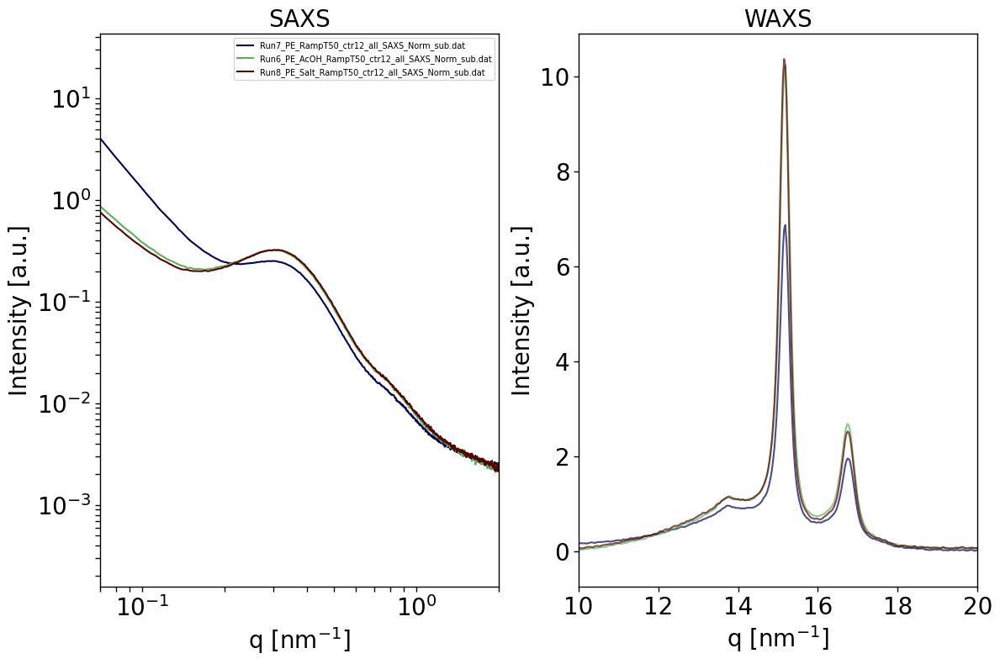

 'Run7*RampT*_ctr30*'
 'Run6*RampT*ctr30*'
 'Run8*RampT*ctr30*'
 'Run7*RampT*_ctr30*'
 'Run6*RampT*ctr30*'
 'Run8*RampT*ctr30*'


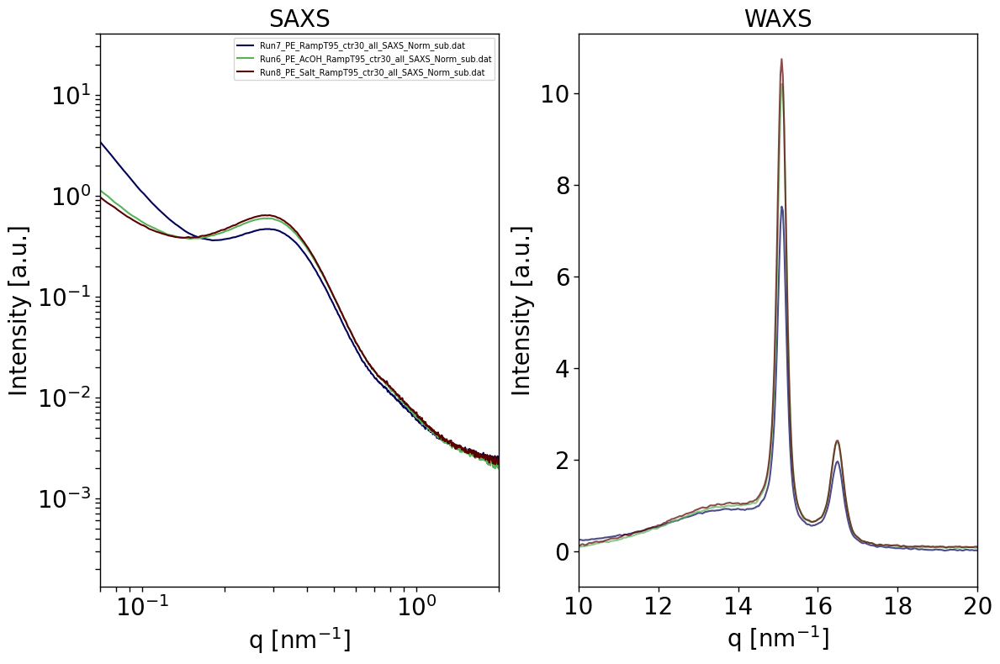

 'Run7*RampT*_ctr40*'
 'Run6*RampT*ctr40*'
 'Run8*RampT*ctr40*'
 'Run7*RampT*_ctr40*'
 'Run6*RampT*ctr40*'
 'Run8*RampT*ctr40*'


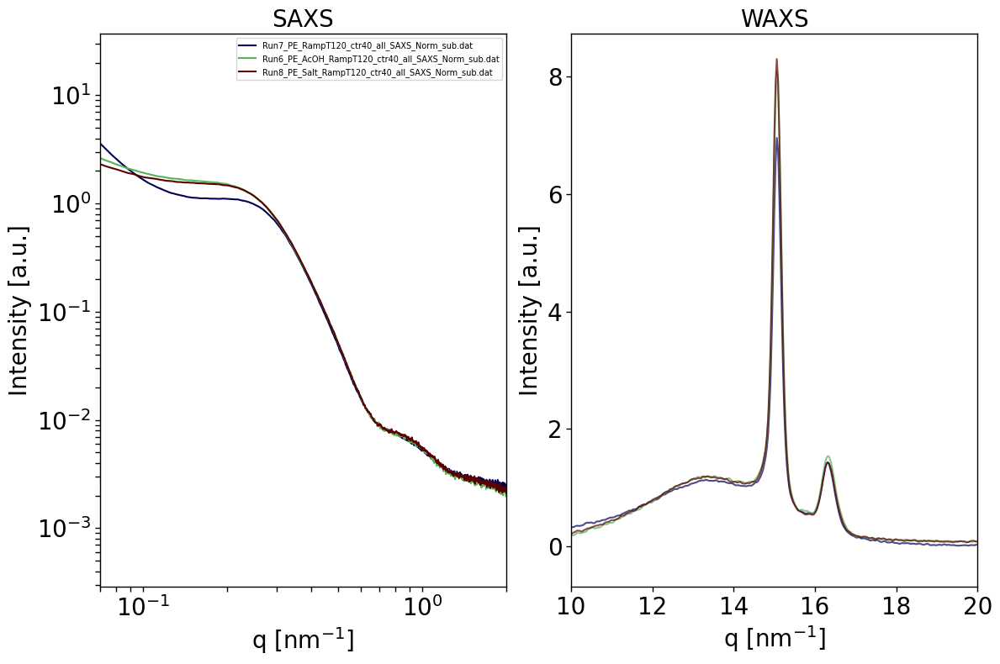

 'Run7*RampT*_ctr42*'
 'Run6*RampT*ctr42*'
 'Run8*RampT*ctr42*'
 'Run7*RampT*_ctr42*'
 'Run6*RampT*ctr42*'
 'Run8*RampT*ctr42*'


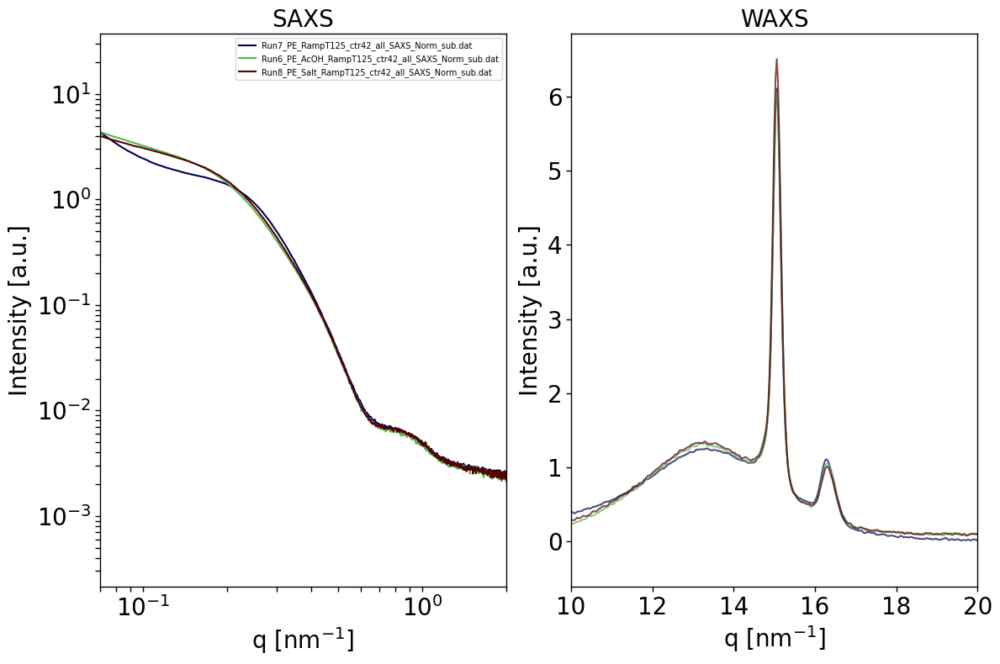

 'Run7*RampT*_ctr43*'
 'Run6*RampT*ctr43*'
 'Run8*RampT*ctr43*'
 'Run7*RampT*_ctr43*'
 'Run6*RampT*ctr43*'
 'Run8*RampT*ctr43*'


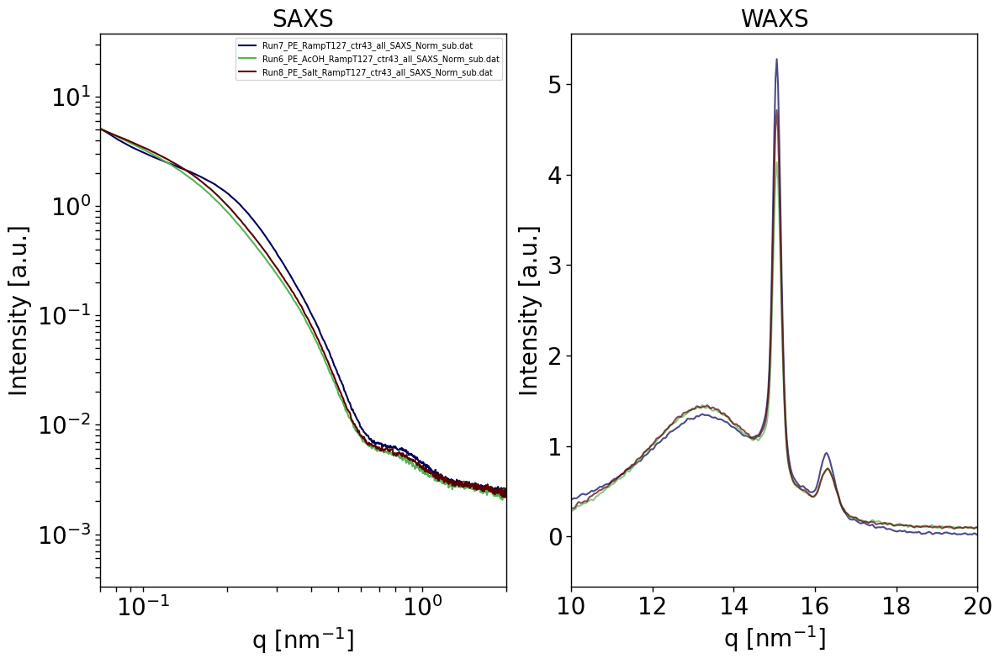

 'Run7*RampT*_ctr44*'
 'Run6*RampT*ctr44*'
 'Run8*RampT*ctr44*'
 'Run7*RampT*_ctr44*'
 'Run6*RampT*ctr44*'
 'Run8*RampT*ctr44*'


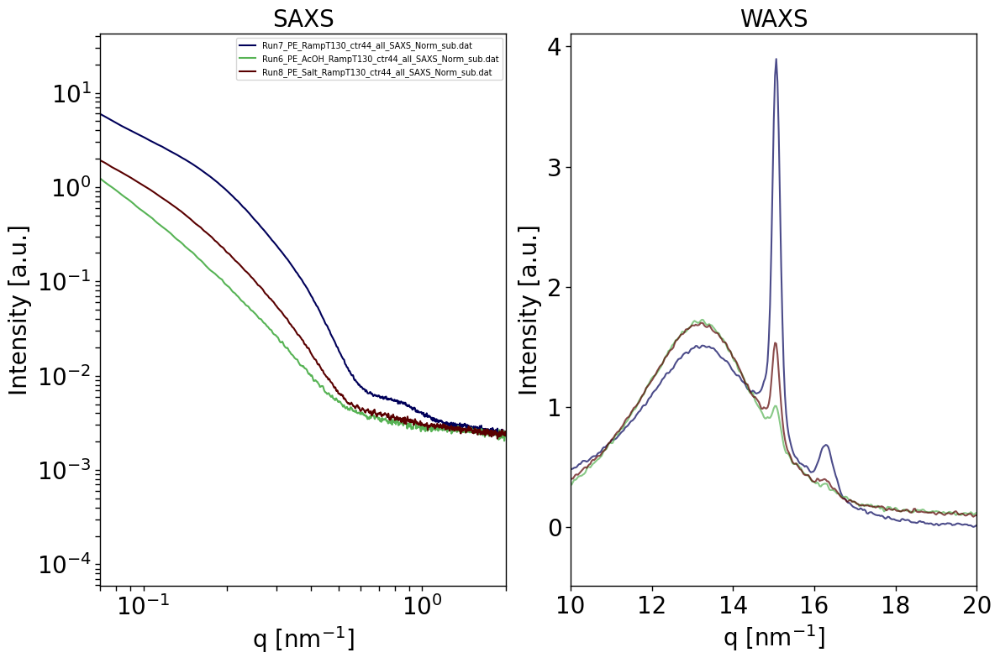

In [31]:
# Run 5

#Run7_PEAcOH2_poly_Solv_10s_03_T25_x19_dy1_ctr0_all_SAXS_Norm_sub_fitted.dat
#Run7_PEAcOH3_poly_Solv_10s_03_T25_x14_dy1_ctr0_all_SAXS_Norm_sub_fitted.dat

all_keywords = [
     ["Run7*RampT50_*", "Run6*RampT50*", "Run8*RampT50*"],
     ["Run7*RampT*_ctr30*",'Run6*RampT*ctr30*','Run8*RampT*ctr30*'],
     ['Run7*RampT*_ctr40*','Run6*RampT*ctr40*','Run8*RampT*ctr40*'],
     ['Run7*RampT*_ctr42*','Run6*RampT*ctr42*','Run8*RampT*ctr42*'],
     ['Run7*RampT*_ctr43*','Run6*RampT*ctr43*','Run8*RampT*ctr43*'],
     ['Run7*RampT*_ctr44*','Run6*RampT*ctr44*','Run8*RampT*ctr44*'],
     #["Run6*RampT30_*"],['Run7*RampT*'], ['Run8*RampT*'],



]

plot_saxs_waxs_data(all_keywords, Run_number="")
